# IED and Ripple detecion based on reported algorithms

van Schalkwijk et al., 2023; Norman et al, 2019, 2021

In [1]:
#%matplotlib qt5
%matplotlib widget

In [2]:
import numpy as np
from scipy import signal, stats
from skimage.measure import label, regionprops
import hdf5storage
import mne
import matplotlib.pyplot as plt
import mpld3
import os
import pickle
from fooof import FOOOF
import matplotlib.gridspec as gridspec
import pandas as pd

In [3]:
import utils_functions as utils

In [4]:
import emd
from scipy.optimize import minimize

### Funciones para deteccion de IEDs y ripples basadas en los articulo de van Schalkwijk et al., 2023 (Progress in Neurobiology), Norman et al., 2019 (Science), Norma et al., 2021 (Neuron)

In [4]:
def detect_IEDs_Sch23(signal_in, srate, t_epoch):
    """
    Detects Interictal Epileptiform Discharges (IEDs) in a given signal.
    Parameters:
    signal_in (numpy.ndarray): The input signal from which IEDs are to be detected.
    srate (float): The sampling rate of the input signal.
    t_epoch (tuple): A tuple containing the start and end times of the epoch relative to the detected event.
    Returns:
    numpy.ndarray: A matrix containing information about detected IEDs. The matrix has four columns:
        - Column 0: Location of discharge maximum.
        - Column 1: Trial onset (location of maximum - start time of epoch * sampling rate).
        - Column 2: Trial offset (location of maximum + end time of epoch * sampling rate).
        - Column 3: Offset relative to maximum location (center of epoch * sampling rate).

    INFO: based on Schalkwijk et al. 2023
    """
    
    # 1. Get envelope from raw signal
    amplit_envelope = np.abs(signal.hilbert(signal_in))
    amplit_envelope = stats.zscore(amplit_envelope, axis=1) 

    # 2. Band-pass filtering 
    filter_order = 10
    low_cut = 25 * 0.8 # low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
    b_hp, a_hp = signal.butter(filter_order, (low_cut / srate) * 2, 'high', analog=False)
    high_cut = 80 * 1.2 # high cut-off frequency for low-pass filter (20% less to compensate for attenuation)
    b_lp, a_lp = signal.butter(filter_order, (high_cut / srate) * 2, 'low', analog=False) 

    # apply filtering and get envelope
    filt_signal_in = signal.filtfilt(b_hp, a_hp, signal_in) # HP
    filt_signal_in = signal.filtfilt(b_lp, a_lp, filt_signal_in) #LP

    filt_signal_in_envelope = np.abs(signal.hilbert(filt_signal_in))

    # 3. Normalize
    filt_signal_in_envelope = stats.zscore(filt_signal_in_envelope, axis=1)

    # 4. Detect events above threshold and time criterion
    cutoff  = 2
    min_t   = 0.02 * srate
    max_t   = 0.1 * srate

    # 5. only find consecutive segments 
    aboveThreshold = (filt_signal_in_envelope > cutoff) # - Samples of threshhold
    aboveThreshold[amplit_envelope < cutoff] = 0  # - Remove if raw sd is < cutoff

    # Identify continuous one and apply time criterion
    spanLocs = label(aboveThreshold) # Label connected regions
    regions = regionprops(spanLocs) # Measure region properties (area)
    spanLength = np.array([region.area for region in regions]) # Extract the length (area) of each region
    goodSpans = np.where((spanLength > min_t) & (spanLength < max_t))[0] # Find indices of spans with lengths within the specified range

    # 6. Create trl matrix 
    # [Note:] trl matrix is a 4-column matrix containing the following information for each trial: 
    #   - [:,0]  Location of discharge maximum
    #   - [:,1]  Trial onset: loc_maximum - trange*srate
    #   - [:,2]  Trial offset: loc_maximum - trange*srate
    #   - [:,3]  Offset relative to maximum location (center): trange*srate

    trl = np.zeros((len(goodSpans),4))

    for g in range(len(goodSpans)):

        currentepochidx = np.where(spanLocs == (goodSpans[g]+1))[1]
        currentepochvals = filt_signal_in_envelope[0,currentepochidx]

        # Find the max in this range
        maxloc = np.argmax(currentepochvals)
        maxloc = maxloc + currentepochidx[0]

        # Create the trl
        trl[g,:] = [maxloc, maxloc-np.abs(t_epoch[0])*srate, maxloc+np.abs(t_epoch[1])*srate, np.abs(t_epoch[0])*srate]

    # 7. Eliminate events that are within 1 sec -------------------------------
    tr_el = np.zeros(trl.shape[0])

    for tr in range(1, trl.shape[0]):
        if (trl[tr,0] - trl[tr-1,0]) <= srate:
            tr_el[tr] = 1
        else:
            pass

    #print(tr_el)

    trl = np.delete(trl, np.where(tr_el == 1), axis=0)

    return trl


def detect_IEDs_Norm19(signal_in, srate, t_epoch=[-2.5, 2.5]):

    IED_band = [25, 60] # [Hz] IED band
    thresh_level = [2, 4] # [z-score] threshold level for IED detection
    ripple_band = [70, 180] # [Hz] ripple band
    max_t  = 0.1 * srate # [samples] maximum duration of IED event

    # IED rejection (Gelinas et al. 2016 Nat. Med.):
    # FIltering in the IED Band
    filter_order = 10
    low_cut_IED = IED_band[0] * 0.8 # [Hz] low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
    b_hp_IED, a_hp_IED = signal.butter(filter_order, (low_cut_IED / srate) * 2, btype = 'highpass', analog=False) 
    high_cut_IED = IED_band[1] * 1.2 # [Hz] high cut-off frequency for low-pass filter (20% more to compensate for attenuation)
    b_lp_IED, a_lp_IED = signal.butter(filter_order, (high_cut_IED / srate) * 2, btype = 'lowpass', analog=False)

    # apply filtering and get envelope
    filt_signal_in_IEDband = signal.filtfilt(b_hp_IED, a_hp_IED, signal_in) # HP
    filt_signal_in_IEDband = signal.filtfilt(b_lp_IED, a_lp_IED, filt_signal_in_IEDband) #LP

    # Hilbert transform
    filt_signal_in_IEDband_envelope = np.abs(signal.hilbert(filt_signal_in_IEDband))
    # Squaring:
    filt_signal_in_IEDband_envelope = filt_signal_in_IEDband_envelope**2

    # Smoothing using a lowpass filter with FIR kaiserwin 
    LPcutoff = np.round(np.mean(ripple_band)/np.pi) # in Hz (see Stark et al. 2014 for a similar method)
        #Note: the cutoff frequency is 40 Hz when ripple-band frequency window is 70-180 Hz 
    transition_width = 10 # [Hz]
    b_lp_kaiser = design_kaiser_filter(LPcutoff, transition_width, srate)

    filt_signal_in_IEDband_envelope = signal.filtfilt(b_lp_kaiser, [1], filt_signal_in_IEDband_envelope)

    # Zscore normalization
    filt_signal_in_IEDband_envelope = (filt_signal_in_IEDband_envelope - np.nanmean(filt_signal_in_IEDband_envelope))/np.nanstd(filt_signal_in_IEDband_envelope)

    print('- Identifying IEDs events [-]')

    IED_locs, IED_properties = signal.find_peaks(filt_signal_in_IEDband_envelope[0], height=thresh_level[1])
    
    trl = np.zeros((len(IED_locs),4))

    for i in range(len(IED_locs)):
        tmp_start = np.max((int(IED_locs[i]-max_t/2),0))
        tmp_stop = np.min((int(IED_locs[i]+max_t/2),len(signal_in[0])))
        currentepochvals = signal_in[0,tmp_start:tmp_stop]
        maxloc = np.argmax(currentepochvals)
        maxloc = tmp_start + maxloc
        
        trl[i,:] = [maxloc, maxloc-np.abs(t_epoch[0])*srate, maxloc+np.abs(t_epoch[1])*srate, np.abs(t_epoch[0])*srate]

    # Se detectan valores repetidos del maximo y se eliminan porque refiere al mismo IED
    _, unique_indices = np.unique(trl[:, 0], return_index=True)
    trl = trl[unique_indices,:]

    return trl


def ripple_char(signal_in, locs, maxsamples):
    """
    Analyze ripple characteristics in a given signal.
    Parameters:
    signal_in (numpy.ndarray): The input signal array.
    locs (list or numpy.ndarray): Indices of candidate ripple peaks.
    maxsamples (int): The maximum number of samples to consider around each candidate peak.
    Returns:
    tuple: A tuple containing three numpy arrays:
        - ripplepeaks (numpy.ndarray): Number of peaks in each segment.
        - rippletrough (numpy.ndarray): Indices of the trough closest to each ripple peak.
        - sharptransient (numpy.ndarray): Sharpest transient for later spike removal.
    """

    # - Pre-define output variables -
    # -------------------------------------------------------------------------
    # Pre-define output variables
    ripplepeaks = np.full(len(locs), np.nan)
    rippletrough = np.full(len(locs), np.nan)
    sharptransient = np.full(len(locs), np.nan)

    # - Go through ripple candidates -
    for idx in range(len(locs)):
        
        # 1. Determine window -------------------------------------------------
        s_start = np.round(locs[idx] - maxsamples/2).astype(int) # start sample
        s_end = np.round(locs[idx] + maxsamples/2).astype(int) # stop sample
        datasegm_trial  = signal_in[0,s_start:s_end]
        #datasegm_time = times[s_start:s_end]
        
        # 2. Find all troughs close to candidate ripple peak ------------------
        idxloc, _ = signal.find_peaks((-1)*datasegm_trial)
        pks2 = datasegm_trial[idxloc]
        idxloc = idxloc + s_start # offset to the real indexs
        
        # 3. Save ripple characteristics --------------------------------------
        if len(idxloc) == 0 or len(idxloc) == 1:
            ripplepeaks[idx] = np.nan
            rippletrough[idx] = np.nan
            sharptransient[idx] = np.nan
        else:
            ripplepeaks[idx] = len(idxloc) # - Number of peaks in segment
            rippletrough[idx] = idxloc[np.argmin(np.abs(idxloc-locs[idx]))] # - Datapoint of trough closest to ripple peak idx 

            # 4. Flag sharpest transient ------------------------------------------
            pksz = stats.zscore(pks2)
            pksdiff = pksz[1:]-pksz[:-1]
            sharptransient[idx] = np.max(np.abs(pksdiff))                    # - Mark sharpest transient for later spike removal


    return ripplepeaks, rippletrough, sharptransient

def num_discharges_in_ripple_trial(trial_start, trial_end, discharge_pks):
    """
    Calculate the number of discharges within each ripple trial.
    Parameters:
    trial_start (array-like): An array of start times for each trial.
    trial_end (array-like): An array of end times for each trial.
    discharge_pks (array-like): An array of discharge peak times.
    Returns:
    numpy.ndarray: An array containing the number of discharges for each trial.
    """
    
    nodischarges = np.zeros(len(trial_start))

    for tr_idx in range(len(trial_start)):

        currentepoch_start = trial_start[tr_idx]
        currentepoch_end = trial_end[tr_idx]
        nodischarges[tr_idx] = np.sum((discharge_pks >= currentepoch_start) & (discharge_pks <= currentepoch_end))

    return nodischarges


def detect_ieeg_ripples_Sch23(signal_in, srate, IED_events, t_range = 2.5):
    """
    Detects ripples in an intracranial EEG (iEEG) signal.
    Parameters:
    signal_in (numpy.ndarray): The input iEEG signal.
    srate (int): The sampling rate of the input signal.
    IED_events (numpy.ndarray): Array containing information about detected inter-ictal discharges.
    t_range (float, optional): Time range for ripple detection. Default is 2.5 seconds.
    Returns:
    numpy.ndarray: A matrix containing information about detected ripples.

    INFO: based on Schalkwijk et al. 2023
    """

    # 1. Band-pass filtering 
    print('- Filtering and Hilbert transform [-]')
    filter_order = 10
    low_cut = 80 * 0.8 # [Hz] low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
    b_hp, a_hp = signal.butter(filter_order, (low_cut / srate) * 2, btype = 'highpass', analog=False) 
    high_cut = 120 * 1.2 # [Hz] high cut-off frequency for low-pass filter (20% more to compensate for attenuation)
    b_lp, a_lp = signal.butter(filter_order, (high_cut / srate) * 2, btype = 'lowpass', analog=False)

    # apply filtering and get envelope
    filt_signal_in = signal.filtfilt(b_hp, a_hp, signal_in) # HP
    filt_signal_in = signal.filtfilt(b_lp, a_lp, filt_signal_in) #LP

    # Hilbert transform
    filt_signal_in_envelope = np.abs(signal.hilbert(filt_signal_in))

    b_lp_h, a_lp_h = signal.butter(filter_order, (10*1.2 / srate) * 2, btype = 'lowpass', analog=False) #10 Hz LP on hilbert amplitude
    filt_signal_in_envelope = signal.filtfilt(b_lp_h, a_lp_h, filt_signal_in_envelope) 

    # Normalize with zscore
    filt_signal_in_envelope = stats.zscore(filt_signal_in_envelope, axis=1)


    # - Find candidate ripple events ------------------------------------------
    print('- Looking candidate ripple events [-]')
    # [Notes:]  - Minimum duration = 25 ms
    #           - Maximum duration = 200 ms  
    #           - Minimum peak distance = 500 ms (avoiding overlap)
    # -------------------------------------------------------------------------
    minsamples = np.round((25/1000) * srate) # Minimum duration 25 ms (sampling points) %note: orig. 20ms
    maxsamples = np.round((200/1000) * srate) # Maximum duration 200 ms (sampling points) 
    MPD        = np.round((500/1000) * srate) # Minimum peak distance 500 ms (sampling points)

    # - Determine minimum & maximum peak height & distance - - - - - - - - - - 
    # [Notes:]  - pks = peak values
    #           - locs = locations 
    #           - width = distance between peaks 
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    # Find peaks in the filtered signal envelope
    peaks, properties = signal.find_peaks(filt_signal_in_envelope[0], height=2, width=(minsamples, maxsamples), distance=MPD)
    pks = properties['peak_heights']
    locs = peaks
    width = properties['widths']

    # - Now go through the signal and determine ripple characteristics --------
    print('- Determine ripple characteristics [-]')
    ripplepeaks, rippletrough, sharptransient = ripple_char(signal_in, locs, maxsamples)

    # - Render peak width into secs -------------------------------------------
    width = width / srate

    # - Render ripple peaks per epoch into Hz ---------------------------------
    ripplepeaks = ripplepeaks * (srate/maxsamples) 

    # - Remove NaN values -----------------------------------------------------
    # TODO

    # - Create a basic trl ----------------------------------------------------
    # [Note:] Defines trial centered around ripple trough as follows:
    #   - [:,0]  Trial onset: ripple trough - settings.trange*data.fsample [samples]
    #   - [:,1]  Trial offset: ripple trough + settings.trange*data.fsample [samples]
    #   - [:,2]  Trigger offset: set at -settings.trange*data.fsample [samples]
    #   - [:,3]  Ripple peak amplitude (z-score)
    #   - [:,4]  Ripple frequency [Hz]
    #   - [:,5]  Indication of sharpest transient in trial
    #   - [:,6]  Ripple duration in seconds
    #   - [:,7]  Cross referencing with discharge detection (optional) : amount of detected discharges in trial
    # -------------------------------------------------------------------------  

    # Si hay informacion sobre las descargas
    if len(IED_events)!=0:
        discharge_pks = IED_events[:,0]
        #num_discharges = np.zeros(len(rippletrough))
        num_discharges = num_discharges_in_ripple_trial(rippletrough-t_range*srate, rippletrough+t_range*srate, discharge_pks)
        trl = np.column_stack((rippletrough-t_range*srate, rippletrough+t_range*srate, np.full(len(rippletrough), -2.5*srate), pks, ripplepeaks, sharptransient, width, num_discharges))

    # Si NO hay informacion sobre las descargas
    else:
        trl = np.column_stack((rippletrough-t_range*srate, rippletrough+t_range*srate, np.full(len(rippletrough), -2.5*srate), pks, ripplepeaks, sharptransient, width, np.zeros(len(rippletrough))))


    # - Remove any potential trials that: -------------------------------------
    #       - Start prior to the recording onset (i.e., ripple detected at the very start)
    #       - Exceed the recording (i.e., ripple detected at the very end
    # -------------------------------------------------------------------------
    trl = trl[trl[:,0]>0,:] # - Remove trial prior to recording onset
    trl = trl[trl[:,1]<len(signal_in[0]),:] # - Remove trials that occur past recording end


    # 2. Cleaning up the trl matrix
    print('- Cleaning up the trl matrix according to criteria [-]')

    amp_th = [2,4] # amplitude threshold
    minfreq = 80; # minimum frequency
    sharptransient_th = 2 # sharp transient threshold
    #overlap = 0 # ??
    trange = 2.5
    min_num_ripples = 10

    # Compute logical AND for multiple conditions
    tIndex = np.logical_and.reduce((
        trl[:,3] >= amp_th[0], trl[:,3] <= amp_th[1], # - Amplitude criteria
        trl[:,4] > minfreq, # - Frequency criteria
        trl[:,5] < sharptransient_th, # - Sharp transient criteria
        trl[:,6] > (np.median(trl[:,6]) - np.std(trl[:,6])), # - Duration criteria
        trl[:,7] == 0 # - IED criteria  
    ))

    # Se concatena como una nueva columna cuales son los putative-ripples que pasan el proceso de limpienza (=1) y los que no (=0)
    trl = np.column_stack((trl, tIndex))

    return trl


def compute_z_normalized_erp(epochs, baseline=(-2.5, -2.0)):
    """
    Compute z-normalized ERP relative to a baseline window in MNE Epochs object.

    Parameters:
    - epochs: mne.Epochs object
    - baseline: tuple, defines the time range for baseline normalization (in seconds)
    
    Returns:
    - z_normalized_erp: numpy array of the z-normalized ERP
    """
    # Compute the mean ERP across all epochs
    evoked = epochs.average()

    # Convert Evoked object to NumPy array (channels x time points)
    erp = evoked.data

    # Get the sampling frequency and time points
    times = evoked.times
    
    # Define the baseline time indices
    baseline_idx = np.where((times >= baseline[0]) & (times <= baseline[1]))[0]

    # Compute the baseline mean and std (for each channel)
    baseline_mean = erp[:, baseline_idx].mean(axis=1, keepdims=True)
    baseline_std = erp[:, baseline_idx].std(axis=1, keepdims=True)

    # Z-normalize the ERP relative to the baseline
    z_normalized_erp = (erp - baseline_mean) / baseline_std

    return z_normalized_erp, evoked.times


def design_kaiser_filter(cutoff_freq, transition_width, sampling_rate, att_rejectband_db=60):
    """
    Design a Kaiser filter based on given specifications.
    
    Parameters:
    -----------
    cutoff_freq : float or tuple
        Cutoff frequency in Hz. For bandpass/bandstop, provide a tuple of (low, high)
    transition_width : float
        Width of transition region in Hz
    sampling_rate : float
        Sampling rate of the signal in Hz
    att_rejectband_db : float, optional
        Attenuation in the stop band in dB (default: 60)
        
    Returns:
    --------
    b : ndarray
        FIR filter coefficients
    """
    
    # Normalize frequencies to Nyquist frequency
    nyq_rate = sampling_rate / 2.0
    
    if isinstance(cutoff_freq, tuple):
        # For bandpass/bandstop
        edges = [freq/nyq_rate for freq in cutoff_freq]
    else:
        # For lowpass/highpass
        edges = cutoff_freq/nyq_rate
    
    # Calculate filter length and beta parameter
    width = transition_width/nyq_rate
    N, beta = signal.kaiserord(att_rejectband_db, width)
    
    # Make sure N is odd for Type I linear phase FIR filter
    if N % 2 == 0:
        N += 1
    
    # Design the filter
    if isinstance(cutoff_freq, tuple):
        # Bandpass filter
        b = signal.firwin(N, edges, window=('kaiser', beta), pass_zero=False)
    else:
        # Lowpass filter
        b = signal.firwin(N, edges, window=('kaiser', beta))
    
    return b

def detect_ieeg_ripples_Norm19(signal_in, srate, IED_events, t_range = 2.5):
    
    """
    Detects ripples in intracranial EEG (iEEG) signals based on a specified algorithm.
    Parameters:
    signal_in (numpy.ndarray): The input iEEG signal.
    srate (float): The sampling rate of the iEEG signal.
    IED_events (numpy.ndarray): Array of interictal epileptiform discharge (IED) events.
    t_range (float, optional): Time range for trial windowing, default is 2.5 seconds.
    Returns:
    numpy.ndarray: A trial matrix containing detected ripple events and their characteristics. The columns are:
        - Trial onset: ripple trough - t_range * srate [samples]
        - Trial offset: ripple trough + t_range * srate [samples]
        - Trigger offset: set at -t_range * srate [samples]
        - Ripple peak amplitude (z-score)
        - Ripple frequency [Hz]
        - Indication of sharpest transient in trial
        - Ripple duration in seconds
        - Ripple relative amplitude [dB]
        - Amount of detected discharges in trial based on changes in the IED band
        - Indicator of whether the ripple passed the cleaning criteria (1 if passed, 0 otherwise) 
    """

    thresh_level = [2, 4]
    ripple_band = [70, 180]

    # 1. Band-pass filtering 
    print('- Filtering and Hilbert transform [-]')
    filter_order = 10
    low_cut = ripple_band[0] * 0.8 # [Hz] low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
    b_hp, a_hp = signal.butter(filter_order, (low_cut / srate) * 2, btype = 'highpass', analog=False) 
    high_cut = ripple_band[1] * 1.2 # [Hz] high cut-off frequency for low-pass filter (20% more to compensate for attenuation)
    b_lp, a_lp = signal.butter(filter_order, (high_cut / srate) * 2, btype = 'lowpass', analog=False)

    # apply filtering and get envelope
    filt_signal_in = signal.filtfilt(b_hp, a_hp, signal_in) # HP
    filt_signal_in = signal.filtfilt(b_lp, a_lp, filt_signal_in) #LP

    # Hilbert transform
    filt_signal_in_envelope = np.abs(signal.hilbert(filt_signal_in))

    # To calculate ripple amplitude in dB relative to median
    ENV = filt_signal_in_envelope/np.nanmedian(filt_signal_in_envelope)
    ENV = 10*np.log10(ENV) 

    # Clipping the signal:
    ## Before clipping we stimate robust mean and std
    rbst_mean, rbst_std, inliers, outliers = robust_mean(filt_signal_in_envelope[0], dim=0, k=thresh_level[1], fit=False)
    top_lim = rbst_mean + thresh_level[1]*rbst_std
    top_lim_DEPR = np.mean(filt_signal_in_envelope) + thresh_level[1]*np.std(filt_signal_in_envelope)
    filt_signal_in_envelope_clip = filt_signal_in_envelope.copy()
    filt_signal_in_envelope_clip[filt_signal_in_envelope_clip > top_lim] = top_lim
        
    # Squaring:
    filt_signal_in_sq_envelope_clip = filt_signal_in_envelope_clip**2

    # Smoothing using a lowpass filter with FIR kaiserwin 
    LPcutoff = np.round(np.mean(ripple_band)/np.pi) # in Hz (see Stark et al. 2014 for a similar method)
        #Note: the cutoff frequency is 40 Hz when ripple-band frequency window is 70-180 Hz 
    transition_width = 10 # [Hz]

    b_lp_kaiser = design_kaiser_filter(LPcutoff, transition_width, srate)

    filt_signal_in_sq_envelope_clip = signal.filtfilt(b_lp_kaiser, [1], filt_signal_in_sq_envelope_clip)

    # Compute means and std:
    avg_sqSignal = np.nanmean(filt_signal_in_sq_envelope_clip, axis=1)
    stdev_sqSignal = np.nanstd(filt_signal_in_sq_envelope_clip, axis=1)        

    # Squaring and filtering the UNCLIPPED signal:
    filt_signal_in_envelope = filt_signal_in_envelope**2
    filt_signal_in_envelope = signal.filtfilt(b_lp_kaiser, [1], filt_signal_in_envelope)

    # Normalize with zscore - NOte: using the avergade & std computed with the clipped signal
    filt_signal_in_envelope = (filt_signal_in_envelope - avg_sqSignal)/stdev_sqSignal

    # - Find candidate ripple events ------------------------------------------
    print('- Looking candidate ripple events [-]')
    # [Notes:]  - Minimum duration = 25 ms
    #           - Maximum duration = 200 ms  
    #           - Minimum peak distance = 500 ms (avoiding overlap)
    # -------------------------------------------------------------------------
    minsamples = np.round((20/1000) * srate) # Minimum duration 20 ms (sampling points) 
    maxsamples = np.round((200/1000) * srate) # Maximum duration 200 ms (sampling points) 
    mindistance = np.round((30/1000) * srate) # Merge putative ripples of minimum distante between peaks is 30 ms or less (sampling points) 
    #MPD        = np.round((500/1000) * srate) # Minimum peak distance 500 ms (sampling points)

    # - Determine minimum & maximum peak height & distance - - - - - - - - - - 
    # [Notes:]  - pks = peak values
    #           - locs = locations 
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    # Find peaks in the filtered signal envelope
    peaks, properties = signal.find_peaks(filt_signal_in_envelope[0], height=thresh_level[1])
    pks = properties['peak_heights']
    locs = peaks

    ## 
    '''# IED rejection (Gelinas et al. 2016 Nat. Med.):
    low_cut_IED = IED_band[0] * 0.8 # [Hz] low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
    b_hp_IED, a_hp_IED = signal.butter(filter_order, (low_cut_IED / srate) * 2, btype = 'highpass', analog=False) 
    high_cut_IED = IED_band[1] * 1.2 # [Hz] high cut-off frequency for low-pass filter (20% more to compensate for attenuation)
    b_lp_IED, a_lp_IED = signal.butter(filter_order, (high_cut_IED / srate) * 2, btype = 'lowpass', analog=False)

    # apply filtering and get envelope
    filt_signal_in_IEDband = signal.filtfilt(b_hp_IED, a_hp_IED, signal_in) # HP
    filt_signal_in_IEDband = signal.filtfilt(b_lp_IED, a_lp_IED, filt_signal_in_IEDband) #LP

    # Hilbert transform
    filt_signal_in_IEDband_envelope = np.abs(signal.hilbert(filt_signal_in_IEDband))
    # Squaring:
    filt_signal_in_IEDband_envelope = filt_signal_in_IEDband_envelope**2
    filt_signal_in_IEDband_envelope = signal.filtfilt(b_lp_kaiser, [1], filt_signal_in_IEDband_envelope)
    # Zscore normalization
    filt_signal_in_IEDband_envelope = (filt_signal_in_IEDband_envelope - np.nanmean(filt_signal_in_IEDband_envelope))/np.nanstd(filt_signal_in_IEDband_envelope)

    print('- Rejecting IEDs events [-]')
    # Ignore IED-ripples events (event that coincide within 50 ms):
    IED_locs, IED_properties = signal.find_peaks(filt_signal_in_IEDband_envelope[0], height=thresh_level[1])
    IED_pks = IED_properties['peak_heights']
    IED_rej_count = 0
    pre_rej_count = len(IED_locs)'''

    IED_rej_count = 0
    IED_locs = IED_events[:,0]
    pre_rej_count = len(IED_locs)

    for i in range(len(IED_locs)):
        tmp = (np.where(np.abs(locs-IED_locs[i]) < (0.05*srate)))
        if len(tmp[0]) > 0:
            locs = np.delete(locs, tmp)
            pks = np.delete(pks, tmp)
            IED_rej_count += 1
    print(f'*** rejected {IED_rej_count} / {pre_rej_count} events based on IED band analysis')

    ##

    # Finding ripple boundaries considering that event duration was expanded until ripple power fell below 2 SD
    boundaries = []
    width = []
    ripplepeaks = np.full(len(locs), np.nan)
    rippletrough = np.full(len(locs), np.nan)
    sharptransient = np.full(len(locs), np.nan)
    relativeampl = np.full(len(locs), np.nan) # relative amplitude of the ripple peak
        
    #for k in locs:
    for k, count in zip(locs, range(len(locs))):
        # Find the starting point of the peak
        start = k
        while True:
            if start == 0:  # Handle edge case at start of signal
                break
            
            start = start - 1
            if filt_signal_in_envelope[0,start] < thresh_level[0]:
                break
        
        # Find the ending point of the peak
        end = k
        while True:
            if end == len(filt_signal_in_envelope[0]) - 1:  # Handle edge case at end of signal
                break
            
            end = end + 1
            if filt_signal_in_envelope[0,end] < thresh_level[0]:
                break
        
        width.append(end - start)
        boundaries.append((start, end))

        # Detect negative peak position for each ripple (closest to ripple's power peak)
        minpos,_ = signal.find_peaks((-1)*filt_signal_in[0,start:end]) # on the band-pass filtered signal

        if len(minpos) == 0:
            rippletrough[count] = np.nan
            ripplepeaks[count] = np.nan
            sharptransient[count] = np.nan
            relativeampl[count] = np.nan 
        else:
            maxamp = np.argmax(ENV[0,start:end])
            minpos = minpos - 1
            maxamp = maxamp - 1
            tmp = np.argmin(np.abs(minpos - maxamp))
            min_index = minpos[tmp]
            peak_position = np.min([(start + min_index), len(signal_in[0])])
            
            rippletrough[count] = peak_position # save ripple trhoug position
            ripplepeaks[count] = len(minpos) # save number of peaks in each segment
            sharptransient[count] = np.max(np.abs(np.diff(signal_in[0,start:end]))) # save sharpest transient for later spike removal
            relativeampl[count] = ENV[0, peak_position] # save relative amplitude of the ripple peak

    # Merge ripples if inter-ripple period is less than minDistance:
    reject_merged = np.zeros(len(boundaries)) # Initialize a vector to reject merged ripples
    for k in range(1, len(boundaries)):
        if (boundaries[k][0] - boundaries[k-1][1]) < mindistance:
            # Merge
            boundaries[k-1] = (boundaries[k-1][0], boundaries[k][1])
            width[k-1] = boundaries[k-1][1] - boundaries[k-1][0]
            #boundaries[k] = (0,0)
            reject_merged[k] = 1
            width[k-1] = boundaries[k-1][1] - boundaries[k-1][0]

    # Filter width according to minsamples and merges ripples
    locs = locs[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    pks = pks[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    width_filt = np.array(width)[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    rippletrough = rippletrough[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    ripplepeaks = ripplepeaks[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    sharptransient = sharptransient[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]
    relativeampl = relativeampl[np.logical_and.reduce((reject_merged != 1, np.array(width) >= minsamples, np.array(width) <= maxsamples))]

    # - Now go through the signal and determine ripple characteristics --------
    #print('- Determine ripple characteristics [-]')
    #ripplepeaks, rippletrough, sharptransient = ripple_char(signal_in, locs, maxsamples)

    # - Render peak width into secs -------------------------------------------
    width_filt = width_filt / srate

    # - Render ripple peaks per epoch into Hz ---------------------------------
    ripplepeaks = ripplepeaks * (srate/maxsamples) 

    # - Remove NaN values -----------------------------------------------------
    # TODO

    # - Create a basic trl ----------------------------------------------------
    # [Note:] Defines trial centered around ripple trough as follows:
    #   - [:,0]  Trial onset: ripple trough - settings.trange*data.fsample [samples]
    #   - [:,1]  Trial offset: ripple trough + settings.trange*data.fsample [samples]
    #   - [:,2]  Trigger offset: set at -settings.trange*data.fsample [samples]
    #   - [:,3]  Ripple peak amplitude (z-score)
    #   - [:,4]  Ripple frequency [Hz]
    #   - [:,5]  Indication of sharpest transient in trial
    #   - [:,6]  Ripple duration in seconds
    #   - [:,7]  Ripple relative amplitude [dB]
    #   - [:,8]  Cross referencing with discharge detection (optional) : amount of detected discharges in trial
    # -------------------------------------------------------------------------  

    #NOTA: voy a mantener la misma estructura de salida entre los distintos algoritmos para homogeneizar pero siguiendo los
    #criterios de cada uno 

    # Si hay informacion sobre las descargas
    if len(IED_locs)!=0:
        num_discharges = num_discharges_in_ripple_trial(rippletrough-t_range*srate, rippletrough+t_range*srate, IED_locs)
        trl = np.column_stack((rippletrough-t_range*srate, rippletrough+t_range*srate, np.full(len(rippletrough), -2.5*srate), pks, ripplepeaks, sharptransient, width_filt, relativeampl, num_discharges))

    # Si NO hay informacion sobre las descargas
    else:
        trl = np.column_stack((rippletrough-t_range*srate, rippletrough+t_range*srate, np.full(len(rippletrough), -2.5*srate), pks, ripplepeaks, sharptransient, width_filt, relativeampl, np.zeros(len(rippletrough))))


    # - Remove any potential trials that: -------------------------------------
    #       - Start prior to the recording onset (i.e., ripple detected at the very start)
    #       - Exceed the recording (i.e., ripple detected at the very end
    # -------------------------------------------------------------------------
    trl = trl[trl[:,0]>0,:] # - Remove trial prior to recording onset
    trl = trl[trl[:,1]<len(signal_in[0]),:] # - Remove trials that occur past recording end


    # 2. Cleaning up the trl matrix
    #print('- Cleaning up the trl matrix according to criteria [-]')

    tIndex = np.ones(len(trl))

    '''
    amp_th = [2,4] # amplitude threshold
    minfreq = 80; # minimum frequency
    sharptransient_th = 2 # sharp transient threshold
    #overlap = 0 # ??
    trange = 2.5
    min_num_ripples = 10

    # Compute logical AND for multiple conditions
    tIndex = np.logical_and.reduce((
        trl[:,3] >= amp_th[0], trl[:,3] <= amp_th[1], # - Amplitude criteria
        trl[:,4] > minfreq, # - Frequency criteria
        trl[:,5] < sharptransient_th, # - Sharp transient criteria
        trl[:,6] > (np.median(trl[:,6]) - np.std(trl[:,6])), # - Duration criteria
        trl[:,7] == 0 # - IED criteria  
    ))
    '''
    # Se concatena como una nueva columna cuales son los putative-ripples que pasan el proceso de limpienza (=1) y los que no (=0)
    trl = np.column_stack((trl, tIndex))

    return trl


"""
Determines if a peak in a signal is prominent based on its amplitude.
A peak is considered prominent if its amplitude is significantly higher 
than the amplitudes at the beginning and end of the signal.
Args:
    signal (list or numpy.ndarray): The signal data as a list or array of numerical values.
    peak_index (int): The index of the peak in the signal to be evaluated.
Returns:
    bool: True if the peak is prominent, False otherwise.
"""
def is_prominent_peak(signal, peak_index):
    peak_amplitude = signal[peak_index]
    threshold_amplitude = 0.8 * peak_amplitude
    
    # Check if amplitude at the beginning and end is lower than threshold
    beginning_amplitude = signal[0]
    end_amplitude = signal[-1]
    
    return beginning_amplitude <= threshold_amplitude and end_amplitude <= threshold_amplitude


def robust_mean(data, dim=None, k=3, fit=False):
    """
    Calculates mean and standard deviation discarding outliers.

    Parameters
    ----------
    data : numpy.ndarray
        Input data array
    dim : int, optional
        Dimension along which to calculate mean (default: first non-singleton dimension)
    k : float, optional
        Number of sigmas for outlier cutoff (default: 3)
    fit : bool, optional
        Whether to use fitting to robustly estimate mean (default: False)

    Returns
    -------
    tuple: (finalMean, stdSample, inlierIdx, outlierIdx)
        - finalMean: Robust mean of the data
        - stdSample: Standard deviation of the data
        - inlierIdx: Indices of inliers
        - outlierIdx: Indices of outliers
    """
    # Convert to float to handle NaN
    original_dtype = data.dtype
    data_float = data.astype(float)
    
    # Input validation
    if data_float.size == 0:
        raise ValueError('Please supply non-empty data to robust_mean')
    
    # Determine dimension
    if dim is None:
        if data_float.ndim == 2 and (data_float.shape[0] == 1 or data_float.shape[1] == 1):
            dim = 0 if data_float.shape[0] == 1 else 1
        else:
            dim = 0
    
    # Check for insufficient data
    finite_count = np.sum(np.isfinite(data_float))
    if finite_count < 4:
        print('Warning: Less than 4 data points!')
        return (np.nanmean(data_float, axis=dim).astype(original_dtype), 
                np.full(np.delete(data_float.shape, dim), np.nan), 
                np.where(np.isfinite(data_float))[0], 
                np.array([]))
    
    # Fitting for 1D data if requested
    if fit:
        if data_float.ndim > 1 and max(data_float.shape) > 1:
            raise ValueError('Fitting is currently only supported for 1D data')
        
        # Define objective function for minimization
        def obj_func(x):
            return np.median(np.abs(data_float - x))
        
        # Use scipy.optimize.minimize to find robust mean
        res = minimize(obj_func, np.median(data_float), method='Nelder-Mead')
        median_data = res.x[0]
    else:
        # Use numpy's median along specified dimension
        median_data = np.nanmedian(data_float, axis=dim)
    
    # Expand median_data to match data shape
    expanded_median = np.expand_dims(median_data, axis=dim)
    
    # Magic numbers from original implementation
    magic_number2 = 1.4826**2
    
    # Calculate squared residuals
    res2 = (data_float - expanded_median)**2
    med_res2 = np.maximum(np.nanmedian(res2, axis=dim), np.finfo(float).eps)
    
    # Test value for outlier detection
    test_value = res2 / (magic_number2 * med_res2[(slice(None),) * dim + (np.newaxis,) * (data_float.ndim - dim)])
    
    # Identify inliers and outliers
    inlier_mask = test_value <= k**2
    inlier_idx = np.where(inlier_mask)
    outlier_idx = np.where(~inlier_mask)
    
    # Calculate standard deviation for inliers
    if finite_count > 4:
        # For single dimensional data
        if data_float.ndim == 1 or max(data_float.shape) == 1:
            flat_res2 = res2[inlier_mask]
            std_sample = np.sqrt(np.sum(flat_res2) / (len(flat_res2) - 4))
        else:
            # For multi-dimensional data
            res2_masked = res2.copy()
            res2_masked[~inlier_mask] = np.nan
            n_inliers = np.sum(~np.isnan(res2_masked), axis=dim)
            good_idx = np.sum(np.isfinite(res2_masked), axis=dim) > 4
            
            std_sample = np.full(np.delete(data_float.shape, dim), np.nan)
            std_sample[good_idx] = np.sqrt(np.nansum(res2_masked[good_idx], axis=dim) / (n_inliers[good_idx] - 4))
    else:
        std_sample = np.full(np.delete(data_float.shape, dim), np.nan)
    
    # Calculate final mean
    final_mean = np.nanmean(np.where(inlier_mask, data_float, np.nan), axis=dim)
    
    return final_mean, std_sample, inlier_idx[0], outlier_idx[0]
'''
def robust_mean(data, dim=None, k=3, fit=False):
    """
    Calculates mean and standard deviation discarding outliers.

    Parameters
    ----------
    data : numpy.ndarray
        Input data array
    dim : int, optional
        Dimension along which to calculate mean (default: first non-singleton dimension)
    k : float, optional
        Number of sigmas for outlier cutoff (default: 3)
    fit : bool, optional
        Whether to use fitting to robustly estimate mean (default: False)

    Returns
    -------
    tuple: (finalMean, stdSample, inlierIdx, outlierIdx)
        - finalMean: Robust mean of the data
        - stdSample: Standard deviation of the data
        - inlierIdx: Indices of inliers
        - outlierIdx: Indices of outliers
    """

    data = data[0]

    # Convert to float to handle NaN
    original_dtype = data.dtype
    data_float = data.astype(float)
    
    # Input validation
    if data_float.size == 0:
        raise ValueError('Please supply non-empty data to robust_mean')
    
    # Determine dimension
    if dim is None:
        if data_float.ndim == 2 and (data_float.shape[0] == 1 or data_float.shape[1] == 1):
            dim = 0 if data_float.shape[0] == 1 else 1
        else:
            dim = 0
    
    # Check for insufficient data
    finite_count = np.sum(np.isfinite(data_float))
    if finite_count < 4:
        print('Warning: Less than 4 data points!')
        return (np.nanmean(data_float, axis=dim).astype(original_dtype), 
                np.full(np.delete(data_float.shape, dim), np.nan), 
                np.where(np.isfinite(data_float))[0], 
                np.array([]))
    
    # Fitting for 1D data if requested
    if fit:
        if data_float.ndim > 1 and max(data_float.shape) > 1:
            raise ValueError('Fitting is currently only supported for 1D data')
        
        # Define objective function for minimization
        def obj_func(x):
            return np.median(np.abs(data_float - x))
        
        # Use scipy.optimize.minimize to find robust mean
        res = minimize(obj_func, np.median(data_float), method='Nelder-Mead')
        median_data = res.x[0]
    else:
        # Use numpy's median along specified dimension
        median_data = np.nanmedian(data_float, axis=dim)
    
    # Expand median_data to match data shape
    expanded_median = np.expand_dims(median_data, axis=dim)
    
    # Magic numbers from original implementation
    magic_number2 = 1.4826**2
    
    # Calculate squared residuals
    res2 = (data_float - expanded_median)**2
    med_res2 = np.maximum(np.nanmedian(res2, axis=dim), np.finfo(float).eps)
    
    # Test value for outlier detection
    test_value = res2 / (magic_number2 * med_res2[(slice(None),) * dim + (np.newaxis,) * (data_float.ndim - dim)])
    
    # Identify inliers and outliers
    inlier_mask = test_value <= k**2
    inlier_idx = np.where(inlier_mask)
    outlier_idx = np.where(~inlier_mask)
    
    # Calculate standard deviation for inliers
    if finite_count > 4:
        # For single dimensional data
        if data_float.ndim == 1 or max(data_float.shape) == 1:
            flat_res2 = res2[inlier_mask]
            std_sample = np.sqrt(np.sum(flat_res2) / (len(flat_res2) - 4))
        else:
            # For multi-dimensional data
            res2_masked = res2.copy()
            res2_masked[~inlier_mask] = np.nan
            n_inliers = np.sum(~np.isnan(res2_masked), axis=dim)
            good_idx = np.sum(np.isfinite(res2_masked), axis=dim) > 4
            
            std_sample = np.full(np.delete(data_float.shape, dim), np.nan)
            std_sample[good_idx] = np.sqrt(np.nansum(res2_masked[good_idx], axis=dim) / (n_inliers[good_idx] - 4))
    else:
        std_sample = np.full(np.delete(data_float.shape, dim), np.nan)
    
    # Calculate final mean
    final_mean = np.nanmean(np.where(inlier_mask, data_float, np.nan), axis=dim)
    
    return final_mean, std_sample, inlier_idx[0], outlier_idx[0]'''

'\ndef robust_mean(data, dim=None, k=3, fit=False):\n    """\n    Calculates mean and standard deviation discarding outliers.\n\n    Parameters\n    ----------\n    data : numpy.ndarray\n        Input data array\n    dim : int, optional\n        Dimension along which to calculate mean (default: first non-singleton dimension)\n    k : float, optional\n        Number of sigmas for outlier cutoff (default: 3)\n    fit : bool, optional\n        Whether to use fitting to robustly estimate mean (default: False)\n\n    Returns\n    -------\n    tuple: (finalMean, stdSample, inlierIdx, outlierIdx)\n        - finalMean: Robust mean of the data\n        - stdSample: Standard deviation of the data\n        - inlierIdx: Indices of inliers\n        - outlierIdx: Indices of outliers\n    """\n\n    data = data[0]\n\n    # Convert to float to handle NaN\n    original_dtype = data.dtype\n    data_float = data.astype(float)\n    \n    # Input validation\n    if data_float.size == 0:\n        raise Valu

In [6]:
# ROBUST MEAN Example usage
data = np.array([2, 2, 3, 100, 170, 800, 4, 5, 6,1,0,50])
mean, std, inliers, outliers = utils.robust_mean(data, dim=0, k=4, fit=False)
#mean, std, inliers, outliers = robust_mean(ieeg_signal[0], dim=0, k=4, fit=False)
print("Robust Mean:", mean)
print("Regular Mean:", np.nanmean(data))
print("Robust Standard Deviation:", std)
print("Regular Standard Deviation:", np.nanstd(data))
print("Inliers:", data[inliers])
print("Outliers:", data[outliers])

Robust Mean: 2.875
Regular Mean: 95.25
Robust Standard Deviation: 3.5355339059327378
Regular Standard Deviation: 218.44607458134834
Inliers: [2 2 3 4 5 6 1 0]
Outliers: [100 170 800  50]


### Para levantar la data del paper de Norman et al., 2021 (Neuron)

In [7]:
# FILEPATH: signal
#filepath = '/home/lfa-01/Documentos/Data_Norman_et_al_Neuron_2021/Norman_et_al_2021_iEEG_data_and_code/SUB01/EEGLAB_datasets_BP/preprocessed/SUB01_MMR_1_preprocessed_BP_montage.set'
filepath = '/home/lfa-01/Documentos/Data_Norman_et_al_Neuron_2021/aux_SUB01_MMR_1_preprocessed_BP_montage.set'
# Load the .set file using MNE-Python
eeg_norman_data = mne.io.read_raw_eeglab(filepath)

# Extract relevant information from the loaded data
times = eeg_norman_data.times
fsample = eeg_norman_data.info['sfreq']
ch_labels = eeg_norman_data.ch_names

# Print some basic information about the loaded data
print(f"Sampling frequency: {fsample} Hz")
print(f"Channel labels: {ch_labels}")

# Select the LC3 channel
mne_data = eeg_norman_data.copy().pick(['LC3-LC5'])
mne_data.set_channel_types({'LC3-LC5': 'seeg'})
print(mne_data.info)

ieeg_signal = mne_data.get_data()
print(f"Data shape: {ieeg_signal.shape}")

# Demean and Detrend signal
ieeg_signal = signal.detrend(ieeg_signal, axis=1, type='linear')
ieeg_signal = ieeg_signal - np.mean(ieeg_signal, axis=1, keepdims=True)

/tmp/ipykernel_1757277/3121001919.py:5: RuntimeWarning: Unknown types found, setting as type EEG:
aux: ['CREF', 'EKG', 'EMGHF', 'TRIG']
signal: ['LA1-LA2', 'LA11-LA12', 'LA3-LA4', 'LA5-LA6', 'LA7-LA8', 'LA9-LA10', 'LB1-LB5', 'LB2-LB5', 'LB3-LB5', 'LB4-LB5', 'LB6-LB5', 'LB7-LB5', 'LB8-LB9', 'LC1-LC5', 'LC2-LC5', 'LC3-LC5', 'LC4-LC5', 'LC6-LC5', 'LC7-LC5', 'LD1-LD2', 'LD11-LD12', 'LD3-LD4', 'LD5-LD6', 'LD7-LD8', 'LD9-LD10', 'LE1-LE2', 'LE3-LE4', 'LE5-LE6', 'LE7-LE8', 'LF1-LF2', 'LF3-LF4', 'LF5-LF6', 'LF7-LF8', 'LG1-LG2', 'LG3-LG4', 'LG5-LG6', 'LG7-LG8', 'LG9-LG10', 'LH1-LH2', 'LH3-LH4', 'LH5-LH6', 'LH7-LH8', 'LH9-LH10', 'LJ1-LJ2', 'LJ3-LJ4', 'LJ5-LJ6', 'LJ7-LJ8', 'LJ9-LJ10', 'LK1-LK2', 'LK3-LK4', 'LK5-LK6', 'LK7-LK8', 'LK9-LK10', 'LM1-LM2', 'LM11-LM12', 'LM3-LM4', 'LM5-LM6', 'LM7-LM8', 'LM9-LM10', 'RA1-RA2', 'RA3-RA4', 'RA5-RA6', 'RA7-RA8', 'RA9-RA10', 'RB1-RB2', 'RB3-RB4', 'RB5-RB6', 'RB7-RB8', 'RB9-RB10', 'RC1-RC2', 'RC11-RC12', 'RC3-RC4', 'RC5-RC6', 'RC7-RC8', 'RC9-RC10', 'RD1-RD2', '

Sampling frequency: 1000.0 Hz
Channel labels: ['TRIG', 'LA1-LA2', 'LA3-LA4', 'LA5-LA6', 'LA7-LA8', 'LA9-LA10', 'LA11-LA12', 'LB1-LB5', 'LB2-LB5', 'LB3-LB5', 'LB4-LB5', 'LB6-LB5', 'LB7-LB5', 'LB8-LB9', 'LC1-LC5', 'LC2-LC5', 'LC3-LC5', 'LC4-LC5', 'LC6-LC5', 'LC7-LC5', 'LD1-LD2', 'LD3-LD4', 'LD5-LD6', 'LD7-LD8', 'LD9-LD10', 'LD11-LD12', 'LE1-LE2', 'LE3-LE4', 'LE5-LE6', 'LE7-LE8', 'LF1-LF2', 'LF3-LF4', 'LF5-LF6', 'LF7-LF8', 'LG1-LG2', 'LG3-LG4', 'LG5-LG6', 'LG7-LG8', 'LG9-LG10', 'LH1-LH2', 'LH3-LH4', 'LH5-LH6', 'LH7-LH8', 'LH9-LH10', 'LJ1-LJ2', 'LJ3-LJ4', 'LJ5-LJ6', 'LJ7-LJ8', 'LJ9-LJ10', 'LK1-LK2', 'LK3-LK4', 'LK5-LK6', 'LK7-LK8', 'LK9-LK10', 'LM1-LM2', 'LM3-LM4', 'LM5-LM6', 'LM7-LM8', 'LM9-LM10', 'LM11-LM12', 'EKG', 'RA1-RA2', 'RA3-RA4', 'RA5-RA6', 'RA7-RA8', 'RA9-RA10', 'RB1-RB2', 'RB3-RB4', 'RB5-RB6', 'RB7-RB8', 'RB9-RB10', 'RC1-RC2', 'RC3-RC4', 'RC5-RC6', 'RC7-RC8', 'RC9-RC10', 'RC11-RC12', 'RD1-RD2', 'RD3-RD4', 'RD5-RD6', 'RD7-RD8', 'RD9-RD10', 'RE1-RE2', 'RE3-RE4', 'RE5-RE6', 'RE7-R

Se obtienen los datos de los ripples identificados. Los mismos estan en el siguiente directorio:
/home/lfa-01/Documentos/Data_Norman_et_al_Neuron_2021/Results/data/Ripple_times_hamming_2-4std_70-180Hz_40Hz_20ms_30ms_ref2

dentro del directorio de cada sujeto, se abre el .mat correspondiente a cada canal. En el workspace de matlab se abre una tabla llamada 'ripples'

In [8]:
filepath_evt = "/home/lfa-01/Documentos/Data_Norman_et_al_Neuron_2021/Ripple_times_hamming_2-4std_70-180Hz_40Hz_20ms_30ms_ref2_SUB01_SUB01run1ripples LC3-LC5.csv"
mat_evt_info = pd.read_csv(filepath_evt)

In [9]:
print(mat_evt_info)

            str        peak         fin  amplitude
0     -0.898000   -0.884000   -0.876000     13.539
1      2.012000    2.017000    2.054000     11.793
2      3.795000    3.800000    3.825000     10.316
3     10.933000   10.959000   10.963000     14.719
4     19.018999   19.028000   19.044001     14.035
..          ...         ...         ...        ...
126  337.726013  337.747009  337.747986      8.221
127  340.523987  340.532013  340.544006     15.980
128  340.575989  340.584991  340.596985     15.024
129  345.145996  345.152008  345.166992     14.292
130  345.635986  345.647003  345.656006     14.949

[131 rows x 4 columns]


### Deteccion de IED siguiendo el algoritmo de van Schalkwijk

In [10]:
trl_discharges_Sch23 = utils.detect_IEDs_Sch23(ieeg_signal, int(fsample), [-2.5,2.5])
print(trl_discharges_Sch23)

[[110913. 108413. 113413.   2500.]
 [117975. 115475. 120475.   2500.]
 [138650. 136150. 141150.   2500.]
 [151596. 149096. 154096.   2500.]
 [256992. 254492. 259492.   2500.]]


Con los eventos detectados creo epocas para visualizaciones

In [11]:
events_IED_Sch23_array_orig = np.column_stack(  (trl_discharges_Sch23[:,0].astype(int), np.zeros(len(trl_discharges_Sch23[:,0])).astype(int), np.ones(len(trl_discharges_Sch23[:,0])).astype(int) ) )
print(events_IED_Sch23_array_orig)

events_IED_Sch23_id_orig = {'putative_IED': 1}
event_IED_Sch23_color_orig = {'putative_IED': 'm'}

[[110913      0      1]
 [117975      0      1]
 [138650      0      1]
 [151596      0      1]
 [256992      0      1]]


In [ ]:
seeg_channels = mne.pick_types(mne_data.info, seeg=True)
mne_data.plot(duration=30, order=seeg_channels, n_channels=len(seeg_channels),
         remove_dc=False, scalings = 'auto', block=True, color=dict(seeg='b'),
         events=events_IED_Sch23_array_orig, event_id=events_IED_Sch23_id_orig, event_color=event_IED_Sch23_color_orig)

Creacion de epocas a partir de los IEDs detectados

/tmp/ipykernel_1757277/2624598111.py:2: RuntimeWarning: Only one channel in group "seeg"; cannot combine by method "mean".
  epochs_IED_Sch23.plot_image(combine="mean")
/tmp/ipykernel_1757277/2624598111.py:2: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  epochs_IED_Sch23.plot_image(combine="mean")


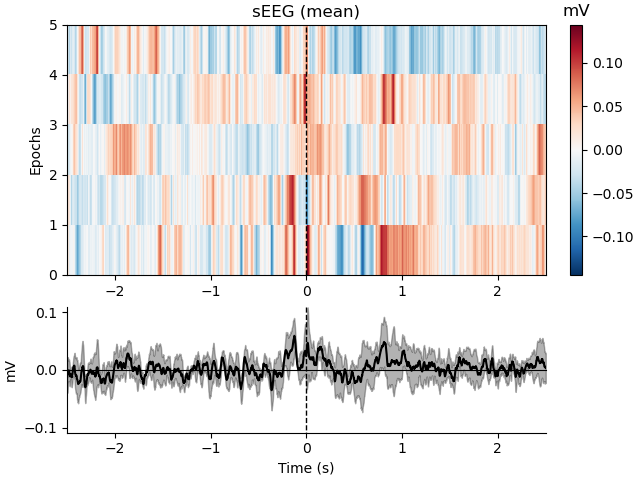

[<Figure size 640x480 with 3 Axes>]

In [12]:
epochs_IED_Sch23 = mne.Epochs(mne_data, events_IED_Sch23_array_orig, tmin=-2.5, tmax=2.5, event_id=events_IED_Sch23_id_orig, preload=True)
epochs_IED_Sch23.plot_image(combine="mean")

Computo de Tiempo-Frecuencia Usando *Multitapers* a partir de las epocas

In [13]:
freqs_IED = np.logspace(*np.log10([4, 160]), num=45)
n_cycles_IED = freqs_IED / 2.0  # different number of cycle per frequency
time_bandwidth_IED = 4.0 
power_IED_Sch23, itc_IED_Sch23 = epochs_IED_Sch23.compute_tfr(
    method='multitaper',
    freqs=freqs_IED, 
    n_cycles=n_cycles_IED, 
    time_bandwidth = time_bandwidth_IED,
    return_itc=True, 
    decim=3, 
    n_jobs=1,
    average=True)

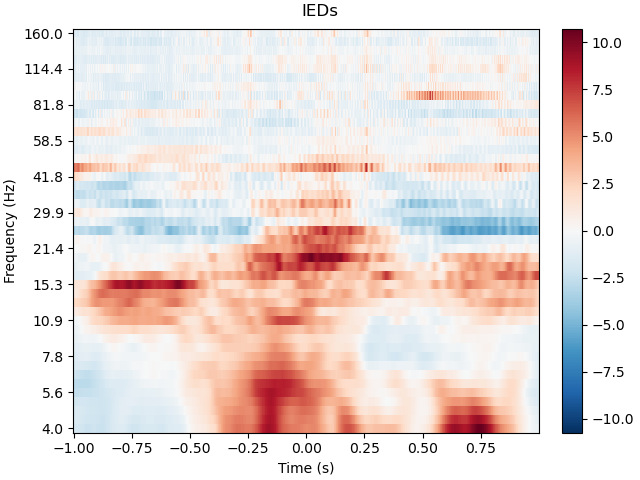

[<Figure size 640x480 with 2 Axes>]

In [14]:
power_IED_Sch23.plot(baseline=(-2.5, -1.5), tmin=-1., tmax=1., mode="zscore", title="IEDs", show=True)

Computo de la PSD para los eventos IED

/tmp/ipykernel_1757277/3263635408.py:3: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  mean_IED_Sch23_spectrum.plot(xscale='log')
/tmp/ipykernel_1757277/3263635408.py:3: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  mean_IED_Sch23_spectrum.plot(xscale='log')


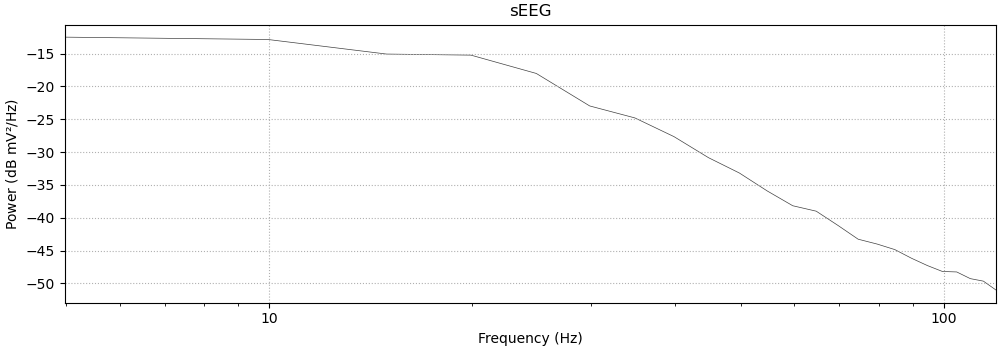

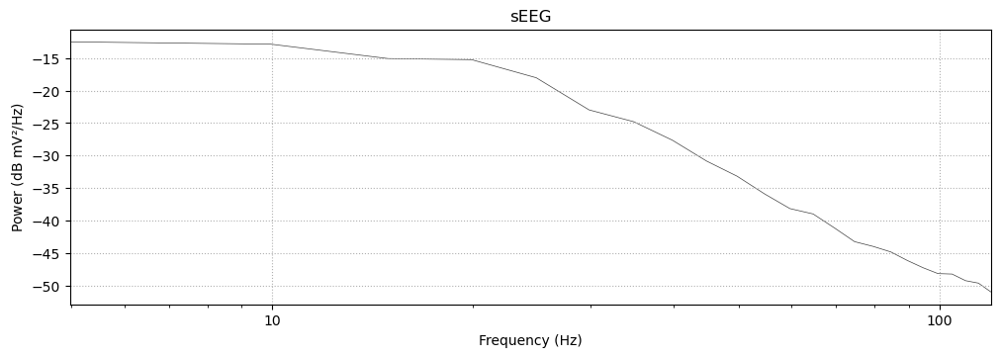

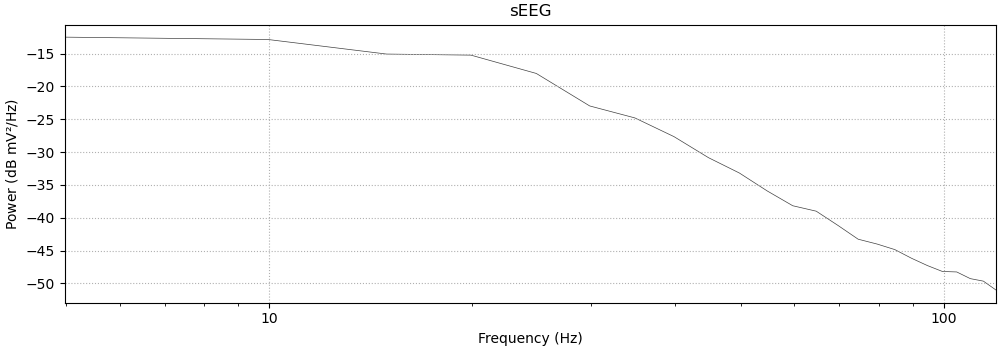

In [15]:
epochs_IED_Sch23_spectrum = epochs_IED_Sch23.compute_psd(method="multitaper", tmin=-0.1, tmax=0.1, fmin=4, fmax=120)
mean_IED_Sch23_spectrum = epochs_IED_Sch23_spectrum.average()
mean_IED_Sch23_spectrum.plot(xscale='log') 

Ajuste de la densidad de potencia con FOOOF

In [16]:
# Initialize a FOOOF object
fm_IED_Sch23 = FOOOF()
fm_IED_Sch23.fit(mean_IED_Sch23_spectrum.freqs, np.squeeze(mean_IED_Sch23_spectrum.data))
print(fm_IED_Sch23.aperiodic_params_)
print(fm_IED_Sch23._ap_fit.shape)
#fm_IED_Sch23.plot()


FOOOF WARNING: Lower-bound peak width limit is < or ~= the frequency resolution: 4.98 <= 0.50
	Lower bounds below frequency-resolution have no effect (effective lower bound is the frequency resolution).
	Too low a limit may lead to overfitting noise as small bandwidth peaks.
	We recommend a lower bound of approximately 2x the frequency resolution.

[-4.86927077  2.92814756]
(24,)


(1, 24)
(24,)


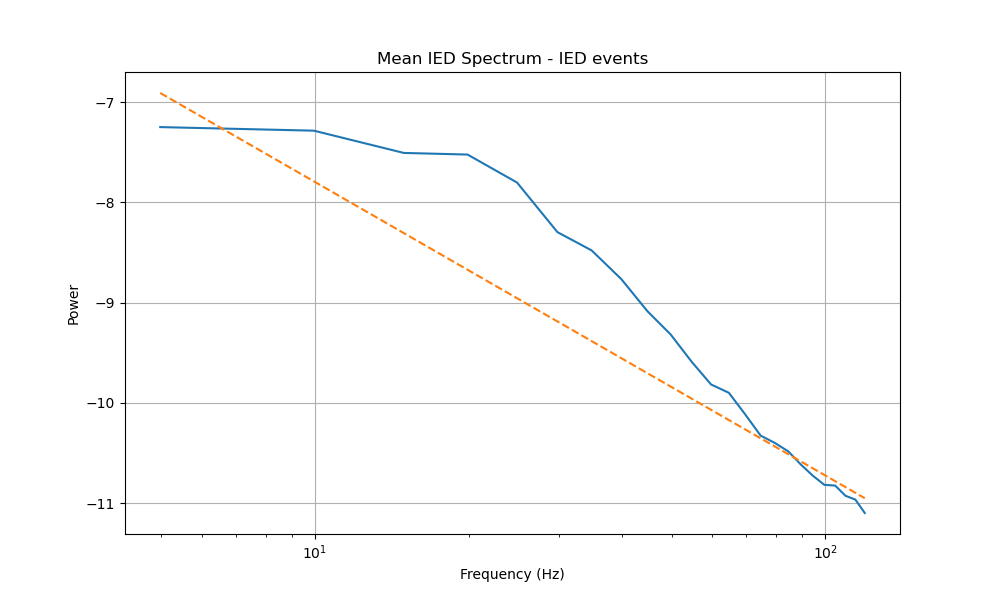

In [17]:
print(mean_IED_Sch23_spectrum.data.shape)
print(mean_IED_Sch23_spectrum.freqs.shape)

# Extract the aperiodic component from the FOOOF model
aperiodic_fit_Sch23 = fm_IED_Sch23._ap_fit

plt.figure(figsize=(10, 6))
plt.plot(mean_IED_Sch23_spectrum.freqs, np.log10(mean_IED_Sch23_spectrum.data.T))
plt.plot(mean_IED_Sch23_spectrum.freqs, aperiodic_fit_Sch23, label='Aperiodic Component', linestyle='--')
plt.xscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.title('Mean IED Spectrum - IED events')
plt.grid(True)
plt.show()

### Deteccion de IED siguiendo el algoritmo de Norman (2019, 2021)

In [19]:
trl_discharges_Norm19 = utils.detect_IEDs_Norm19(ieeg_signal, int(fsample), [-2.5, 2.5])
print(trl_discharges_Norm19)
print(trl_discharges_Norm19.shape)

- Identifying IEDs events [-]
[[ 1.30000e+01 -2.48700e+03  2.51300e+03  2.50000e+03]
 [ 1.85000e+02 -2.31500e+03  2.68500e+03  2.50000e+03]
 [ 6.05800e+03  3.55800e+03  8.55800e+03  2.50000e+03]
 [ 7.65000e+03  5.15000e+03  1.01500e+04  2.50000e+03]
 [ 7.76100e+03  5.26100e+03  1.02610e+04  2.50000e+03]
 [ 9.23300e+03  6.73300e+03  1.17330e+04  2.50000e+03]
 [ 1.15890e+04  9.08900e+03  1.40890e+04  2.50000e+03]
 [ 1.26300e+04  1.01300e+04  1.51300e+04  2.50000e+03]
 [ 1.30590e+04  1.05590e+04  1.55590e+04  2.50000e+03]
 [ 1.38880e+04  1.13880e+04  1.63880e+04  2.50000e+03]
 [ 1.43050e+04  1.18050e+04  1.68050e+04  2.50000e+03]
 [ 1.49870e+04  1.24870e+04  1.74870e+04  2.50000e+03]
 [ 1.49880e+04  1.24880e+04  1.74880e+04  2.50000e+03]
 [ 1.50600e+04  1.25600e+04  1.75600e+04  2.50000e+03]
 [ 1.55010e+04  1.30010e+04  1.80010e+04  2.50000e+03]
 [ 1.65840e+04  1.40840e+04  1.90840e+04  2.50000e+03]
 [ 1.72330e+04  1.47330e+04  1.97330e+04  2.50000e+03]
 [ 1.72760e+04  1.47760e+04  1.9776

Con los eventos detectados creo epocas para visualizaciones

In [20]:
events_IED_Norm19_array_orig = np.column_stack(  (trl_discharges_Norm19[:,0].astype(int), np.zeros(len(trl_discharges_Norm19[:,0])).astype(int), np.ones(len(trl_discharges_Norm19[:,0])).astype(int) ) )
print(events_IED_Norm19_array_orig)

events_IED_Norm19_id_orig = {'putative_IED': 1}
event_IED_Norm19_color_orig = {'putative_IED': 'm'}

[[    13      0      1]
 [   185      0      1]
 [  6058      0      1]
 [  7650      0      1]
 [  7761      0      1]
 [  9233      0      1]
 [ 11589      0      1]
 [ 12630      0      1]
 [ 13059      0      1]
 [ 13888      0      1]
 [ 14305      0      1]
 [ 14987      0      1]
 [ 14988      0      1]
 [ 15060      0      1]
 [ 15501      0      1]
 [ 16584      0      1]
 [ 17233      0      1]
 [ 17276      0      1]
 [ 17277      0      1]
 [ 17733      0      1]
 [ 18282      0      1]
 [ 18545      0      1]
 [ 18948      0      1]
 [ 23042      0      1]
 [ 24335      0      1]
 [ 24445      0      1]
 [ 24687      0      1]
 [ 26921      0      1]
 [ 30889      0      1]
 [ 31002      0      1]
 [ 32757      0      1]
 [ 32759      0      1]
 [ 32963      0      1]
 [ 36046      0      1]
 [ 37271      0      1]
 [ 41731      0      1]
 [ 41846      0      1]
 [ 42364      0      1]
 [ 42602      0      1]
 [ 45845      0      1]
 [ 47984      0      1]
 [ 48170      0 

In [21]:
seeg_channels = mne.pick_types(mne_data.info, seeg=True)
mne_data.plot(duration=30, order=seeg_channels, n_channels=len(seeg_channels),
         remove_dc=False, scalings = 'auto', block=True, color=dict(seeg='b'),
         events=events_IED_Norm19_array_orig, event_id=events_IED_Norm19_id_orig, event_color=event_IED_Norm19_color_orig)

Creacion de epocas a aprtir de los IEDs detectados

/tmp/ipykernel_1757277/41356717.py:2: RuntimeWarning: Only one channel in group "seeg"; cannot combine by method "mean".
  epochs_IED_Norm19.plot_image(combine="mean")
/tmp/ipykernel_1757277/41356717.py:2: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  epochs_IED_Norm19.plot_image(combine="mean")


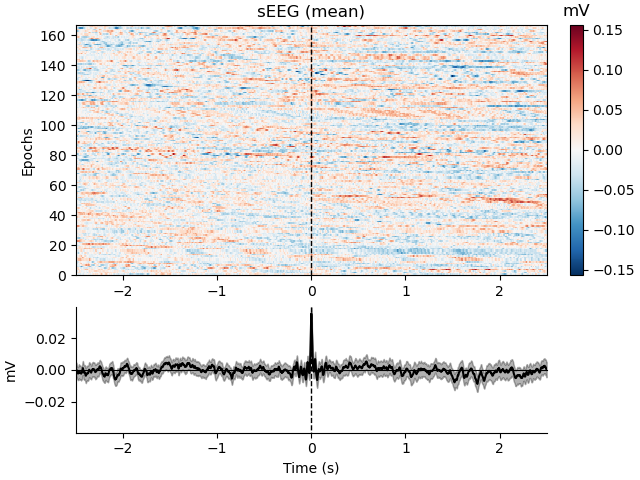

[<Figure size 640x480 with 3 Axes>]

In [22]:
epochs_IED_Norm19 = mne.Epochs(mne_data, events_IED_Norm19_array_orig, tmin=-2.5, tmax=2.5, event_id=events_IED_Norm19_id_orig, preload=True)
epochs_IED_Norm19.plot_image(combine="mean")

Computo de Tiempo-Frecuencia Usando *Multitapers* a partir de las epocas

In [23]:
freqs_IED = np.logspace(*np.log10([4, 160]), num=45)
n_cycles_IED = freqs_IED / 2.0  # different number of cycle per frequency
time_bandwidth_IED = 4.0 
power_IED_Norm19, itc_IED = epochs_IED_Norm19.compute_tfr(
    method='multitaper',
    freqs=freqs_IED, 
    n_cycles=n_cycles_IED, 
    time_bandwidth = time_bandwidth_IED,
    return_itc=True, 
    decim=3, 
    n_jobs=1,
    average=True)

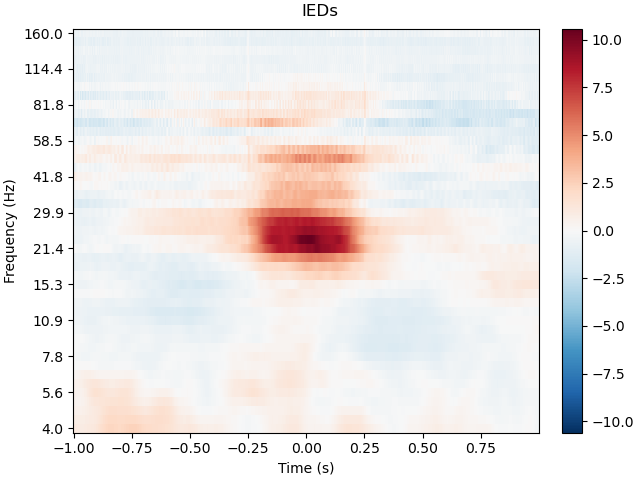

[<Figure size 640x480 with 2 Axes>]

In [24]:
power_IED_Norm19.plot(baseline=(-2.5, -1.5), tmin=-1., tmax=1., mode="zscore", title="IEDs", show=True)

Computo de la PSD para los eventos IED

/tmp/ipykernel_412626/482767496.py:3: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  mean_IED_Norm19_spectrum.plot(xscale='log', average=True)


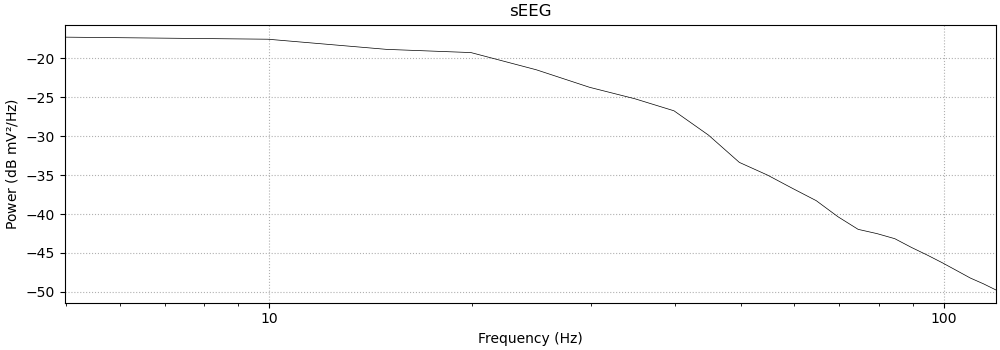

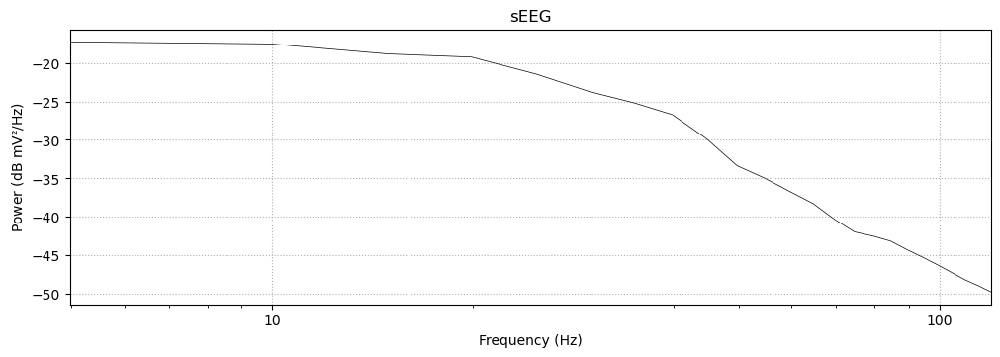

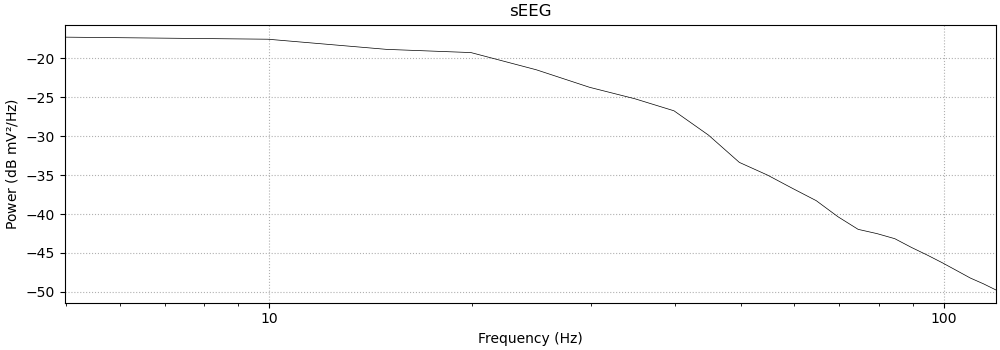

In [23]:
epochs_IED_Norm19_spectrum = epochs_IED_Norm19.compute_psd(method="multitaper", tmin=-0.1, tmax=0.1, fmin=4, fmax=120)
mean_IED_Norm19_spectrum = epochs_IED_Norm19_spectrum.average()
mean_IED_Norm19_spectrum.plot(xscale='log', average=True) 

Ajuste de la densidad de potencia con FOOOF

In [24]:
# Initialize a FOOOF object
fm_IED_Norm19 = FOOOF()
fm_IED_Norm19.fit(mean_IED_Norm19_spectrum.freqs, np.squeeze(mean_IED_Norm19_spectrum.data))
print(fm_IED_Norm19.aperiodic_params_)
print(fm_IED_Norm19._ap_fit.shape)
#fm_IED.plot()



FOOOF WARNING: Lower-bound peak width limit is < or ~= the frequency resolution: 4.98 <= 0.50
	Lower bounds below frequency-resolution have no effect (effective lower bound is the frequency resolution).
	Too low a limit may lead to overfitting noise as small bandwidth peaks.
	We recommend a lower bound of approximately 2x the frequency resolution.

[-5.77049392  2.41517245]
(24,)


(1, 24)
(24,)


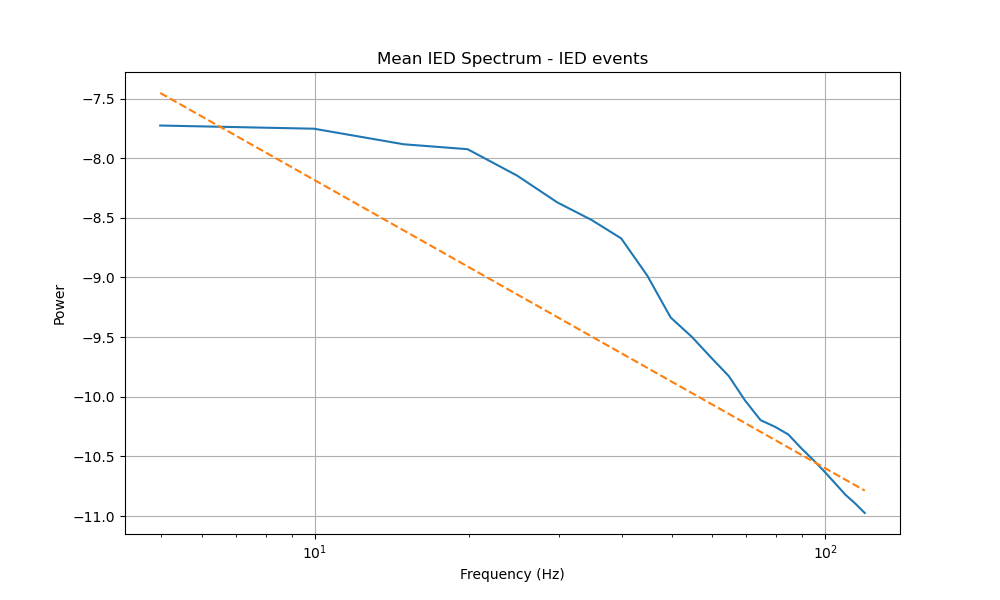

In [26]:
print(mean_IED_Norm19_spectrum.data.shape)
print(mean_IED_Norm19_spectrum.freqs.shape)

# Extract the aperiodic component from the FOOOF model
aperiodic_fit_Norm19 = fm_IED_Norm19._ap_fit

plt.figure(figsize=(10, 6))
plt.plot(mean_IED_Norm19_spectrum.freqs, np.log10(mean_IED_Norm19_spectrum.data.T))
plt.plot(mean_IED_Norm19_spectrum.freqs, aperiodic_fit_Norm19, label='Aperiodic Component', linestyle='--')
plt.xscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.title('Mean IED Spectrum - IED events')
plt.grid(True)
plt.show()


### Deteccion de *ripples* siguiendo el algoritmo de van Schalkwijk

In [25]:
# USANDO LA FUNCION detect_ieeg_ripples
trl_ripples_Sch23 = utils.detect_ieeg_ripples_Sch23(signal_in=ieeg_signal, srate=int(fsample), IED_events=trl_discharges_Sch23, t_range = 2.5)

# Filtrar los putative ripples
trl_ripples_Sch23_clean = trl_ripples_Sch23[trl_ripples_Sch23[:,8]==1,:]

- Filtering and Hilbert transform [-]
- Looking candidate ripple events [-]
- Determine ripple characteristics [-]
- Cleaning up the trl matrix according to criteria [-]


In [28]:
print(trl_ripples_Sch23_clean.shape)

(56, 9)


Matriz de eventos identificados (putative IEDs y putative ripples) para ver junto con la señal de SEEG

In [26]:
samples_offset = np.abs(trl_ripples_Sch23_clean[0,2])
t_range = 2.5 # time range ± ripple trough (sec)
srate=int(fsample)

# IEDs detectados por el algoritmo the van Fr
events_IED_Sch23_array_orig = np.column_stack(  (trl_discharges_Sch23[:,0].astype(int), np.zeros(len(trl_discharges_Sch23[:,0])).astype(int), np.ones(len(trl_discharges_Sch23[:,0])).astype(int) ) )

# Ripples detectados con el algoritmo de van Fr
events_ripple_Sch23_array_orig = np.column_stack(  ((trl_ripples_Sch23_clean[:,0]+samples_offset).astype(int), np.zeros(len(trl_ripples_Sch23_clean[:,0])).astype(int), 2*np.ones(len(trl_ripples_Sch23_clean[:,0])).astype(int) ) )

# Se concatenan todos los eventos en una misma matriz
events_Sch23_array_orig = np.concatenate((events_IED_Sch23_array_orig, events_ripple_Sch23_array_orig), axis=0)
print(events_Sch23_array_orig)

events_id_orig = {'putative_IED': 1, 'putative_ripple': 2}
events_color_orig = {'putative_IED': 'm','putative_ripple': 'g'}

[[110913      0      1]
 [117975      0      1]
 [138650      0      1]
 [151596      0      1]
 [256992      0      1]
 [ 10586      0      2]
 [ 13473      0      2]
 [ 29912      0      2]
 [ 41630      0      2]
 [ 45013      0      2]
 [ 48760      0      2]
 [ 58981      0      2]
 [ 64866      0      2]
 [ 66345      0      2]
 [ 68058      0      2]
 [ 76010      0      2]
 [ 87093      0      2]
 [ 91198      0      2]
 [ 93023      0      2]
 [ 96950      0      2]
 [ 99971      0      2]
 [101880      0      2]
 [103197      0      2]
 [123684      0      2]
 [124883      0      2]
 [125462      0      2]
 [129329      0      2]
 [141439      0      2]
 [155538      0      2]
 [156243      0      2]
 [157950      0      2]
 [162074      0      2]
 [167097      0      2]
 [173345      0      2]
 [185669      0      2]
 [188021      0      2]
 [190744      0      2]
 [198850      0      2]
 [199947      0      2]
 [202132      0      2]
 [220451      0      2]
 [230460      0 

Para visualizar la señal con todos los eventos

In [100]:
seeg_channels = mne.pick_types(mne_data.info, seeg=True)
mne_data.plot(duration=30, order=seeg_channels, n_channels=len(seeg_channels),
         remove_dc=False, scalings = 'auto', block=True, color=dict(seeg='b'),
         events=events_Sch23_array_orig, event_id=events_id_orig, event_color=events_color_orig)

Channels marked as bad:
none


Creacion y visualizacion de epocas a partir de los ripples detectados

/tmp/ipykernel_412626/1688666286.py:2: RuntimeWarning: Only one channel in group "seeg"; cannot combine by method "mean".
  epochs_ripples_Sch23.plot_image(combine="mean")
/tmp/ipykernel_412626/1688666286.py:2: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  epochs_ripples_Sch23.plot_image(combine="mean")


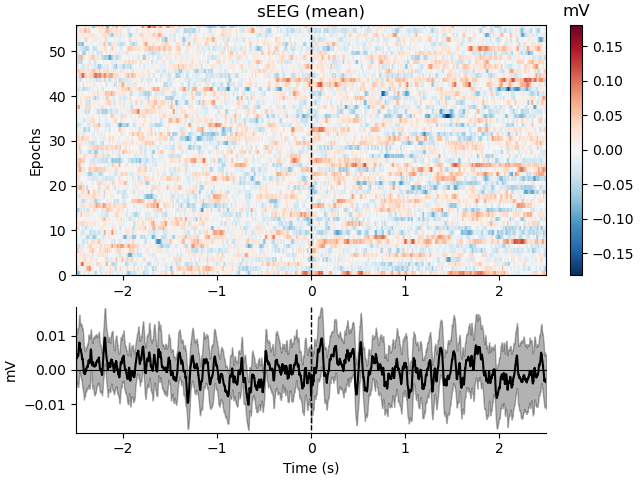

(56, 1, 5001)


/tmp/ipykernel_412626/1688666286.py:3: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  print(epochs_ripples_Sch23.get_data().shape)


In [30]:
epochs_ripples_Sch23 = mne.Epochs(mne_data, events_ripple_Sch23_array_orig, tmin=-2.5, tmax=2.5, preload=True)
epochs_ripples_Sch23.plot_image(combine="mean")
print(epochs_ripples_Sch23.get_data().shape)

Visualizacion de ERP asociado a lo ripples (zscore)

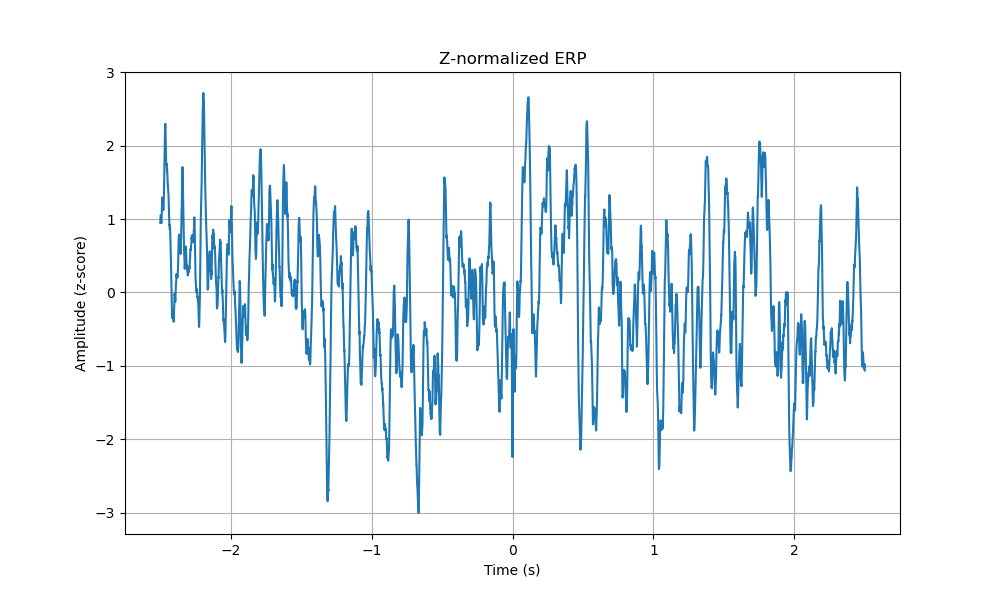

In [31]:
z_normalized_erp_Sch23, times_erp_Sch23 = compute_z_normalized_erp(epochs_ripples_Sch23, baseline=(-2.5, 2.0))

plt.figure(figsize=(10, 6))
plt.plot(times_erp_Sch23, z_normalized_erp_Sch23.T)
plt.title('Z-normalized ERP')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (z-score)')
plt.grid(True)
plt.show()

Computo de Tiempo-Frecuencia Usando *Multitapers* a partir de las epocas

In [32]:
freqs_ripples = np.logspace(*np.log10([4, 181]), num=45)
n_cycles_ripples = freqs_ripples / 2.0  # different number of cycle per frequency
time_bandwidth_ripples = 4.0 #8.0 
power_ripples__Sch23, itc_ripples__Sch23 = epochs_ripples_Sch23.compute_tfr(
    method='multitaper',
    freqs=freqs_ripples, 
    n_cycles=n_cycles_ripples, 
    time_bandwidth = time_bandwidth_ripples,
    return_itc=True, 
    decim=3, 
    n_jobs=-1,
    average=True)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


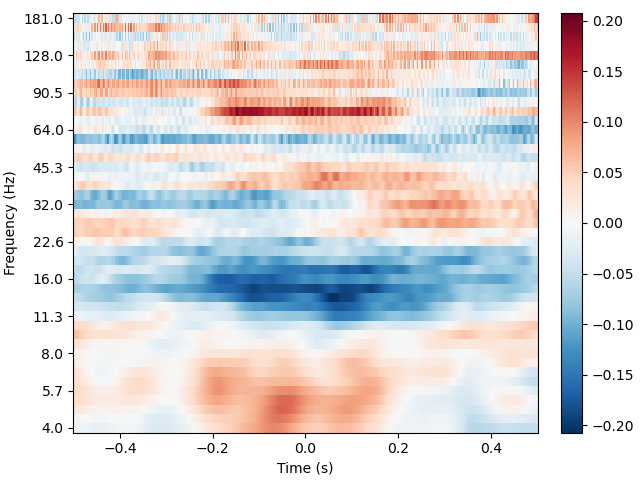

[<Figure size 640x480 with 2 Axes>]

In [33]:
power_ripples__Sch23.plot(baseline=(-2, -1.5), tmin=-0.5, tmax=0.5, mode="logratio") #"logratio" "zscore"

Se computa tambien el TF para cada epoca invidualmente para visualizacion

In [34]:
power_ripples_x_epoch_Sch23 = epochs_ripples_Sch23.compute_tfr(
    method='multitaper',
    freqs=freqs_ripples, 
    n_cycles=n_cycles_ripples, 
    time_bandwidth = time_bandwidth_ripples,
    return_itc=False, 
    decim=3, 
    n_jobs=-1,
    average=False)

power_ripples_x_epoch_Sch23.get_data().shape

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


(56, 1, 45, 1667)

In [35]:
# Getting the data from the EpochsTFR object
power_ripples_x_epoch_data_Sch23 = power_ripples_x_epoch_Sch23.get_data()

# 1. Compute geometric mean across both time (axis 3)
baseline = np.exp(np.mean(np.log(power_ripples_x_epoch_data_Sch23), axis=3))  # Shape becomes (#trials, 1, #freqs) - one value per freq per trial

# Expand dimensions to match original array
baseline_expanded = baseline[:, :, :, np.newaxis]  # Shape (1, 1, #freqs, 1)
baseline_broadcast = np.broadcast_to(baseline_expanded, power_ripples_x_epoch_data_Sch23.shape)

# 2a. For z-score: compute std across time for each trial
std = np.std(power_ripples_x_epoch_data_Sch23, axis=3)  # Shape (#trials, 1, #freqs)
std_expanded = std[:, :, :, np.newaxis]
std_broadcast = np.broadcast_to(std_expanded, power_ripples_x_epoch_data_Sch23.shape)

power_ripples_x_epoch_data_Sch23_zs = (power_ripples_x_epoch_data_Sch23 - baseline_broadcast) / std_broadcast

# 2b. Or for dB normalization 
power_ripples_x_epoch_data_Sch23_db = 10 * np.log10(power_ripples_x_epoch_data_Sch23 / baseline_broadcast)

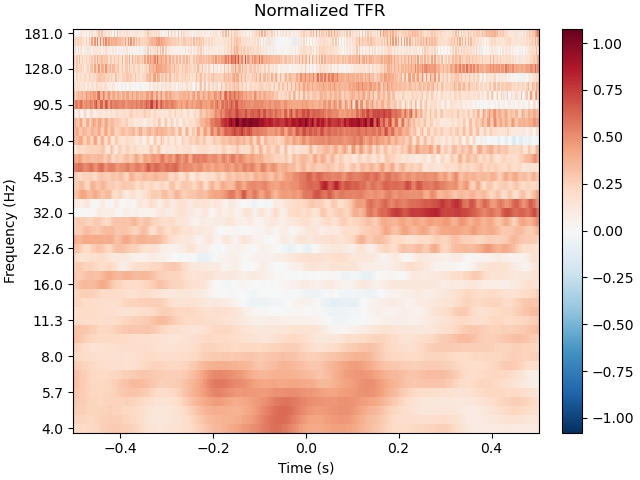

[<Figure size 640x480 with 2 Axes>]

In [36]:
power_ripples_x_epoch_Sch23_norm = power_ripples_x_epoch_Sch23.copy()
power_ripples_x_epoch_Sch23_norm.data = power_ripples_x_epoch_data_Sch23_zs

# Plot average across trials
power_ripples_x_epoch_Sch23_norm.average().plot(
    title='Normalized TFR',
    baseline=None,  # Since we already normalized
    mode='mean',
    tmin=-0.5, tmax=0.5,
    #vmin=-5, vmax=5,  # Adjust these for zscore
    # or vmin=-3, vmax=3 for dB scale
)

Computo de la PSD para los eventos IED

In [37]:
epochs_ripples_Sch23_spectrum = epochs_ripples_Sch23.compute_psd(method="multitaper", tmin=-0.1, tmax=0.1, fmin=4, fmax=120)

/tmp/ipykernel_412626/1267588750.py:2: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  mean_ripples_Sch23_spectrum.plot(xscale='log', average=True)


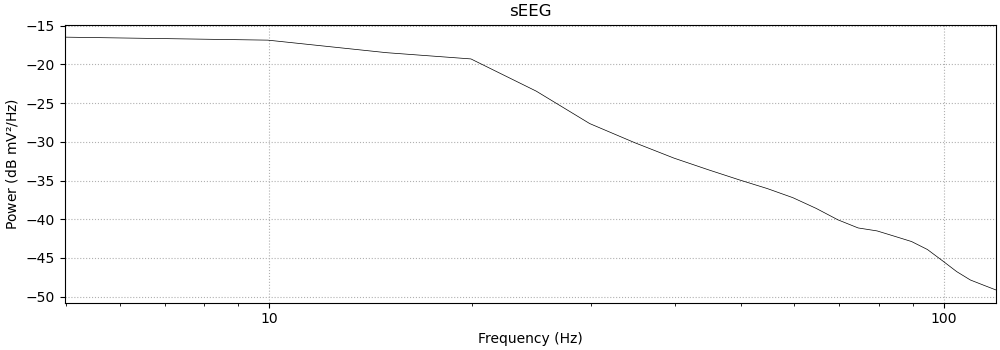

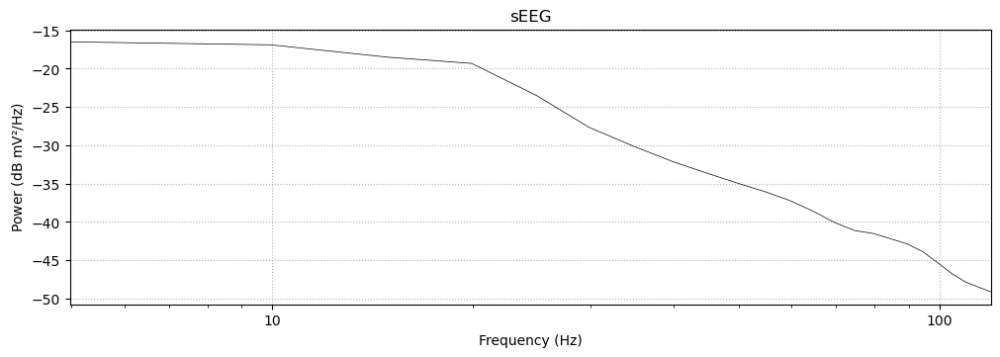

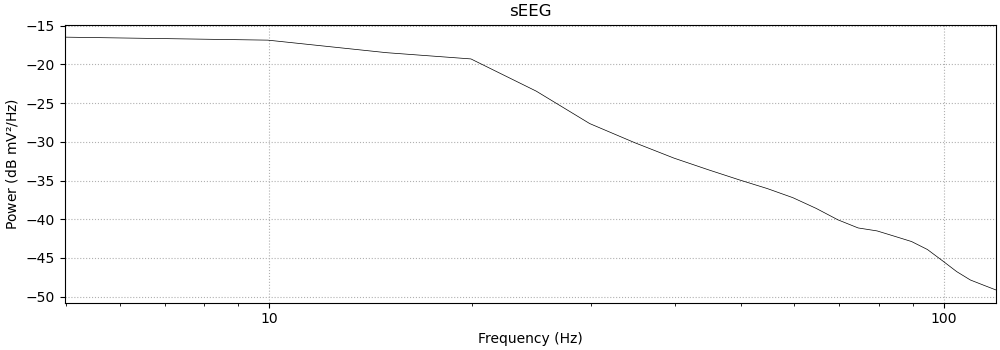

In [38]:
mean_ripples_Sch23_spectrum = epochs_ripples_Sch23_spectrum.average()
mean_ripples_Sch23_spectrum.plot(xscale='log', average=True) 

Ajuste de la densidad de potencia con FOOOF

In [39]:
# Initialize a FOOOF object
fm_ripples_Sch23 = FOOOF()
fm_ripples_Sch23.fit(mean_ripples_Sch23_spectrum.freqs, np.squeeze(mean_ripples_Sch23_spectrum.data))
print(fm_ripples_Sch23.aperiodic_params_)
print(fm_ripples_Sch23._ap_fit.shape)
#fm_ripples.plot()


FOOOF WARNING: Lower-bound peak width limit is < or ~= the frequency resolution: 4.98 <= 0.50
	Lower bounds below frequency-resolution have no effect (effective lower bound is the frequency resolution).
	Too low a limit may lead to overfitting noise as small bandwidth peaks.
	We recommend a lower bound of approximately 2x the frequency resolution.

[-5.5821974  2.428535 ]
(24,)


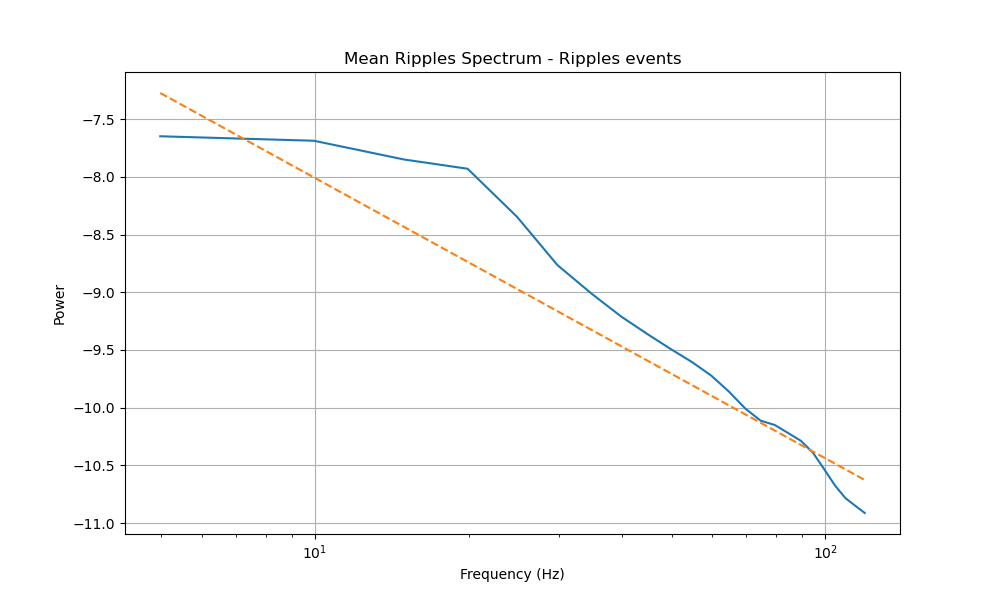

In [40]:
# Extract the aperiodic component from the FOOOF model
aperiodic_fit_ripples_Sch23 = fm_ripples_Sch23._ap_fit

plt.figure(figsize=(10, 6))
plt.plot(mean_ripples_Sch23_spectrum.freqs, np.log10(mean_ripples_Sch23_spectrum.data.T))
plt.plot(mean_ripples_Sch23_spectrum.freqs, aperiodic_fit_ripples_Sch23, label='Aperiodic Component', linestyle='--')
plt.xscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.title('Mean Ripples Spectrum - Ripples events')
plt.grid(True)
plt.show()


### Deteccion de *ripples* siguiendo el algoritmo de Norman

In [27]:
# USANDO LA FUNCION detect_ieeg_ripples based on Norman work
trl_ripples_Norm19 = utils.detect_ieeg_ripples_Norm19(signal_in=ieeg_signal, srate=int(fsample), IED_events=trl_discharges_Norm19, t_range = 2.5)

# Filtrar los putative ripples
trl_ripples_Norm19_clean = trl_ripples_Norm19[trl_ripples_Norm19[:,9]==1.,:]

- Filtering and Hilbert transform [-]
- Looking candidate ripple events [-]
*** rejected 13 / 171 events based on IED band analysis


In [42]:
print(trl_ripples_Norm19_clean.shape)

(175, 10)


NameError: name 'signal_in' is not defined

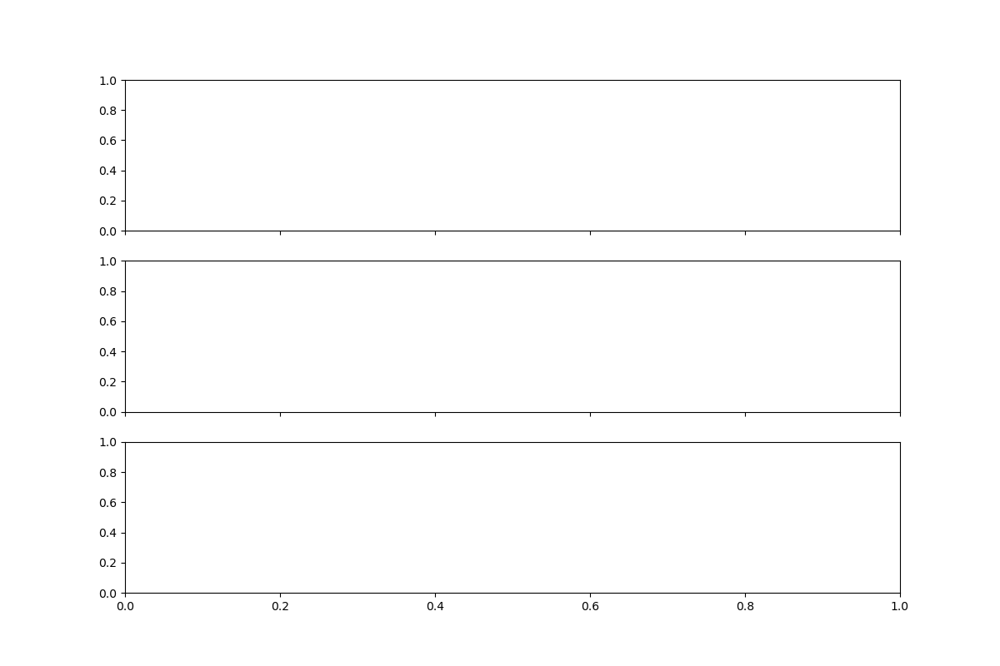

In [43]:
trl_show = trl_ripples_Norm19[trl_ripples_Norm19[:,9]==1.,:]

# Create a figure and subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize=(12, 8))

# Plot the raw signal
ax1.plot(signal_in[0], color='blue')
ax1.set_title('Raw Signal')
ax1.set_ylabel('Amplitude')

# Plot the filtered signal
ax2.plot(filt_signal_in[0], color='green')
ax2.set_title('Filtered Signal')
ax2.set_ylabel('Amplitude')

# Plot the squared and clipped envelope of the filtered signal
ax3.plot(filt_signal_in_envelope[0], color='red')
ax3.set_title('Squared and Un-Clipped Envelope of Filtered Signal')
ax3.axhline(y=thresh_level[1], color='black', linestyle='--', label='Threshold Level')
ax3.axhline(y=thresh_level[0], color='black', linestyle='--', label='Threshold Level')
# Plot an asterisk at each trl_show[:,0]
ax3.plot(trl_show[:, 0]+np.abs(trl_show[:, 2]), np.full(len(trl_show[:, 0]),5), 'b*', label='Detected Ripples')
#filt_signal_in_envelope[0, trl_show[:, 0].astype(int)]
ax3.legend()
ax3.set_xlabel('Samples')
ax3.set_ylabel('Amplitude')

# Show the plot
plt.tight_layout()
plt.show()

Matriz de eventos identificados (putative IEDs y putative ripples) para ver junto con la señal de SEEG

In [31]:
samples_offset = np.abs(trl_ripples_Norm19_clean[0,2])
t_range = 2.5 # time range ± ripple trough (sec)
srate=int(fsample)

# IEDs detectados por el algoritmo de Norman
events_IED_Norm19_array_orig = np.column_stack(  (trl_discharges_Norm19[:,0].astype(int), np.zeros(len(trl_discharges_Norm19[:,0])).astype(int), np.ones(len(trl_discharges_Norm19[:,0])).astype(int) ) )
#print(events_IED_Norm19_array_orig)

# Ripples detectados con el algoritmo de Norman
events_ripple_Norm19_array_orig = np.column_stack(  ((trl_ripples_Norm19_clean[:,0]+samples_offset).astype(int), np.zeros(len(trl_ripples_Norm19_clean[:,0])).astype(int), 2*np.ones(len(trl_ripples_Norm19_clean[:,0])).astype(int) ) )
#print(events_ripple_Norm19_array_orig)

# Ripples identificados por Norman-2021 y reportados
events_ripple_Norm21_array_orig = np.column_stack( ((mat_evt_info['peak'].values*fsample).astype(int), np.zeros(len(mat_evt_info['peak'].values)).astype(int), 3*np.ones(len(mat_evt_info['peak'].values)).astype(int) ) )

# Se concatenan todos los eventos en una misma matriz
events_Norm19_array_orig = np.concatenate((events_IED_Norm19_array_orig, events_ripple_Norm19_array_orig, events_ripple_Norm21_array_orig), axis=0)
print(events_Norm19_array_orig)

events_id_orig = {'putative_IED': 1, 'putative_ripple': 2, 'putative_ripple_Norman21': 3}
events_color_orig = {'putative_IED': 'm','putative_ripple': 'g', 'putative_ripple_Norman21':'k'}


[[    13      0      1]
 [   185      0      1]
 [  6058      0      1]
 ...
 [340584      0      3]
 [345152      0      3]
 [345647      0      3]]


Para visualizar la señal con todos los eventos

In [27]:
seeg_channels = mne.pick_types(mne_data.info, seeg=True)
mne_data.plot(duration=30, order=seeg_channels, n_channels=len(seeg_channels),
         remove_dc=False, scalings = 'auto', block=True, color=dict(seeg='b'),
         events=events_Norm19_array_orig, event_id=events_id_orig, event_color=events_color_orig)

Creacion y visualizacion de epocas a partir de los ripples detectados

In [ ]:
print(events_Norm19_array_orig)

[[1.30000e+01 0.00000e+00 1.00000e+00]
 [1.85000e+02 0.00000e+00 1.00000e+00]
 [6.05800e+03 0.00000e+00 1.00000e+00]
 ...
 [3.40584e+05 0.00000e+00 3.00000e+00]
 [3.45152e+05 0.00000e+00 3.00000e+00]
 [3.45647e+05 0.00000e+00 3.00000e+00]]


In [34]:
events_ripple_Norm21_array_orig

array([[  -884,      0,      3],
       [  2016,      0,      3],
       [  3799,      0,      3],
       [ 10958,      0,      3],
       [ 19027,      0,      3],
       [ 19193,      0,      3],
       [ 19611,      0,      3],
       [ 21075,      0,      3],
       [ 21169,      0,      3],
       [ 22493,      0,      3],
       [ 24620,      0,      3],
       [ 24729,      0,      3],
       [ 33541,      0,      3],
       [ 34196,      0,      3],
       [ 35977,      0,      3],
       [ 37291,      0,      3],
       [ 52824,      0,      3],
       [ 60092,      0,      3],
       [ 60187,      0,      3],
       [ 60273,      0,      3],
       [ 60527,      0,      3],
       [ 60903,      0,      3],
       [ 69734,      0,      3],
       [ 75635,      0,      3],
       [ 77490,      0,      3],
       [ 82876,      0,      3],
       [ 83579,      0,      3],
       [ 87932,      0,      3],
       [ 88504,      0,      3],
       [101286,      0,      3],
       [10

/tmp/ipykernel_1757277/129189771.py:2: RuntimeWarning: Only one channel in group "seeg"; cannot combine by method "mean".
  epochs_ripples_Norm19.plot_image(combine="mean")
/tmp/ipykernel_1757277/129189771.py:2: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  epochs_ripples_Norm19.plot_image(combine="mean")


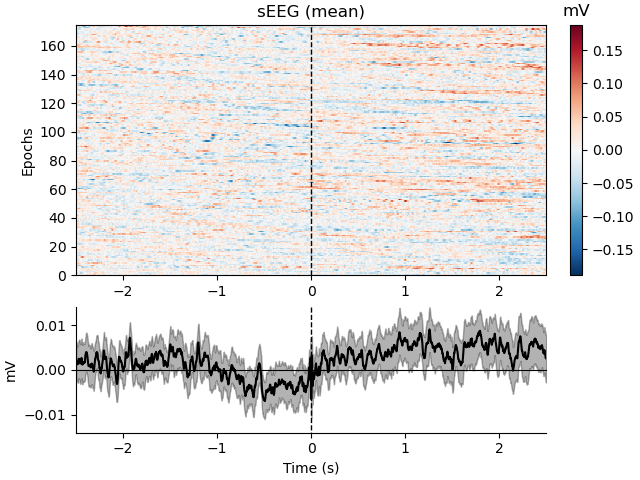

(175, 1, 5001)


/tmp/ipykernel_1757277/129189771.py:3: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  print(epochs_ripples_Norm19.get_data().shape)


In [32]:
epochs_ripples_Norm19 = mne.Epochs(mne_data, events_ripple_Norm19_array_orig, tmin=-2.5, tmax=2.5, preload=True)
epochs_ripples_Norm19.plot_image(combine="mean")
print(epochs_ripples_Norm19.get_data().shape)

Visualizacion de ERP asociado a lo ripples (zscore)

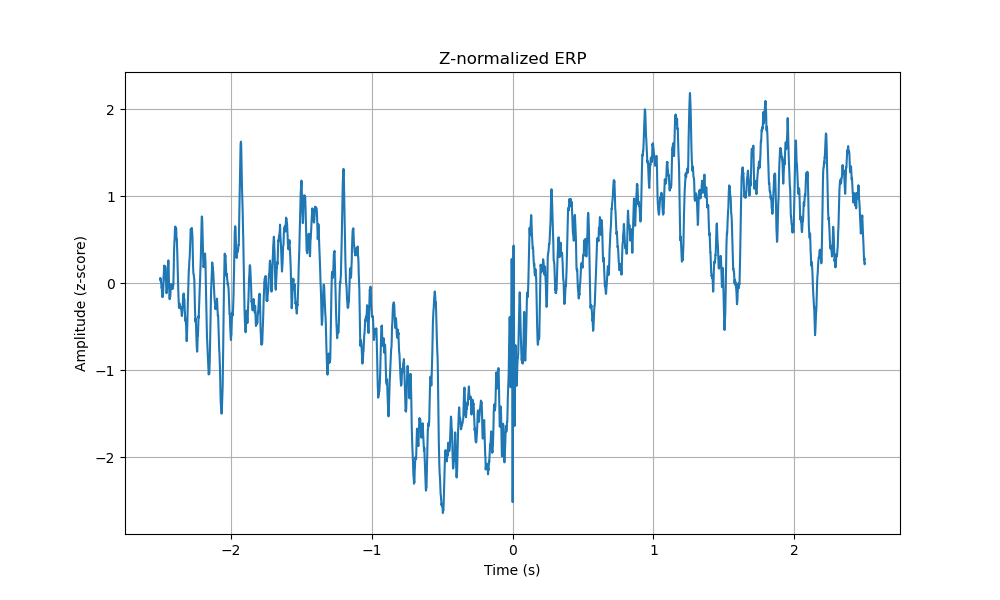

In [33]:
z_normalized_erp_Norm19, times_erp_Norm19 = utils.compute_z_normalized_erp(epochs_ripples_Norm19, baseline=(-2.5, 2.0))

plt.figure(figsize=(10, 6))
plt.plot(times_erp_Norm19, z_normalized_erp_Norm19.T)
plt.title('Z-normalized ERP')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (z-score)')
plt.grid(True)
plt.show()

Computo de Tiempo-Frecuencia Usando *Multitapers* a partir de las epocas

In [34]:
freqs_ripples = np.logspace(*np.log10([4, 181]), num=45)
n_cycles_ripples = freqs_ripples / 2.0  # different number of cycle per frequency
time_bandwidth_ripples = 4.0 #8.0 
power_ripples_Norm19, itc_ripples_Norm19 = epochs_ripples_Norm19.compute_tfr(
    method='multitaper',
    freqs=freqs_ripples, 
    n_cycles=n_cycles_ripples, 
    time_bandwidth = time_bandwidth_ripples,
    return_itc=True, 
    decim=3, 
    n_jobs=-1,
    average=True)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


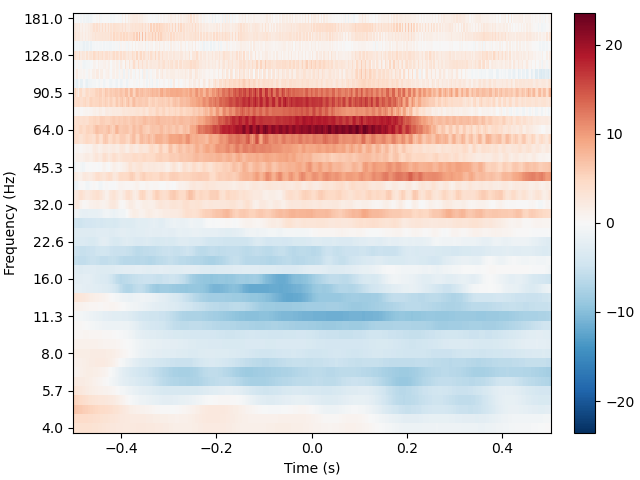

[<Figure size 640x480 with 2 Axes>]

In [35]:
power_ripples_Norm19.plot(baseline=(-2, -1.5), tmin=-0.5, tmax=0.5, mode="zscore") #"logratio"

Se computa tambien el TF para cada epoca invidualmente para visualizacion

In [37]:
power_ripples_x_epoch_Norm19 = epochs_ripples_Norm19.compute_tfr(
    method='multitaper',
    freqs=freqs_ripples, 
    n_cycles=n_cycles_ripples, 
    time_bandwidth = time_bandwidth_ripples,
    return_itc=False, 
    decim=3, 
    n_jobs=-1,
    average=False)

power_ripples_x_epoch_Norm19.get_data().shape

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


(175, 1, 45, 1667)

In [66]:
'''# Getting the data from the EpochsTFR object
power_ripples_x_epoch_Norm19_data = power_ripples_x_epoch_Norm19.get_data()

# 1. Compute geometric mean across both trials (axis 0) and time (axis 3)
# First reshape to combine trials and time points
tfr_reshaped = power_ripples_x_epoch_Norm19_data.reshape(-1, 1, 45)  # Shape becomes (1651*1667, 1, 45)
# Compute geometric mean 
baseline = np.exp(np.mean(np.log(tfr_reshaped), axis=0))  # Shape becomes (1, 45)

# Expand dimensions to match original array
baseline_expanded = baseline[np.newaxis, :, :, np.newaxis]  # Shape (1, 1, 45, 1)
baseline_broadcast = np.broadcast_to(baseline_expanded, power_ripples_x_epoch_Norm19_data.shape)

print(tfr_reshaped.shape)
print(baseline.shape)
print(baseline_expanded.shape)
print(baseline_broadcast.shape)

# 2a. For z-score normalization
#power_ripples_x_epoch_data_zs = (power_ripples_x_epoch_data - baseline_broadcast) / np.std(tfr_reshaped, axis=0, keepdims=True)

# 2b. Or for dB normalization 
power_ripples_x_epoch_data_Norm19_db = 10 * np.log10(power_ripples_x_epoch_Norm19_data / baseline_broadcast)'''

(291725, 1, 45)
(1, 45)
(1, 1, 45, 1)
(175, 1, 45, 1667)


Different ERP normalizacion following Norman19 recommendations

In [38]:
# Getting the data from the EpochsTFR object
power_ripples_x_epoch_data_Norm19 = power_ripples_x_epoch_Norm19.get_data()

# 1. Compute geometric mean across both time (axis 3)
baseline = np.exp(np.mean(np.log(power_ripples_x_epoch_data_Norm19), axis=3))  # Shape becomes (#trials, 1, #freqs) - one value per freq per trial

# Expand dimensions to match original array
baseline_expanded = baseline[:, :, :, np.newaxis]  # Shape (1, 1, #freqs, 1)
baseline_broadcast = np.broadcast_to(baseline_expanded, power_ripples_x_epoch_data_Norm19.shape)

# 2a. For z-score: compute std across time for each trial
std = np.std(power_ripples_x_epoch_data_Norm19, axis=3)  # Shape (#trials, 1, #freqs)
std_expanded = std[:, :, :, np.newaxis]
std_broadcast = np.broadcast_to(std_expanded, power_ripples_x_epoch_data_Norm19.shape)

power_ripples_x_epoch_data_Norm19_zs = (power_ripples_x_epoch_data_Norm19 - baseline_broadcast) / std_broadcast

# 2b. Or for dB normalization 
power_ripples_x_epoch_data_Norm19_db = 10 * np.log10(power_ripples_x_epoch_data_Norm19 / baseline_broadcast)


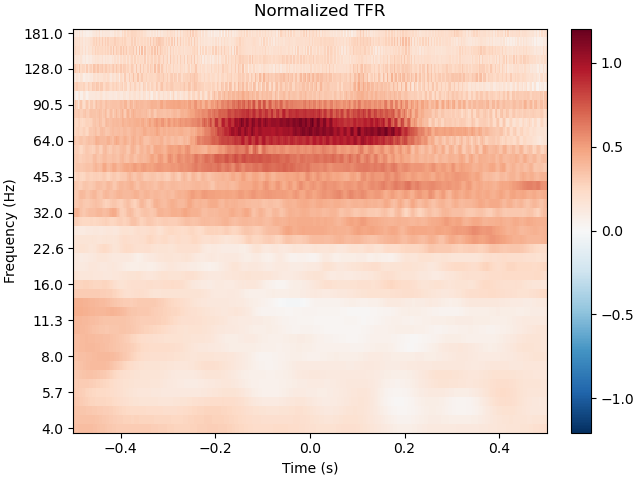

[<Figure size 640x480 with 2 Axes>]

In [39]:
power_ripples_x_epoch_Norm19_norm = power_ripples_x_epoch_Norm19.copy()
power_ripples_x_epoch_Norm19_norm.data = power_ripples_x_epoch_data_Norm19_zs

# Plot average across trials
power_ripples_x_epoch_Norm19_norm.average().plot(
    title='Normalized TFR',
    baseline=None,  # Since we already normalized
    mode='mean',
    tmin=-0.5, tmax=0.5,
    #vmin=-5, vmax=5,  # Adjust these for zscore
    # or vmin=-3, vmax=3 for dB scale
)


Computo de la PSD para los eventos IED

In [52]:
epochs_ripples_Norm19_spectrum = epochs_ripples_Norm19.compute_psd(method="multitaper", tmin=-0.1, tmax=0.1, fmin=4, fmax=120)


/tmp/ipykernel_412626/1419493336.py:2: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  mean_ripples_Norm19_spectrum.plot(xscale='log', average=True)
/home/lfa-01/mambaforge-pypy3/envs/env_mne_1_7/lib/python3.12/site-packages/mne/viz/_mpl_figure.py:2365: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(FigureClass=FigureClass, **kwargs)


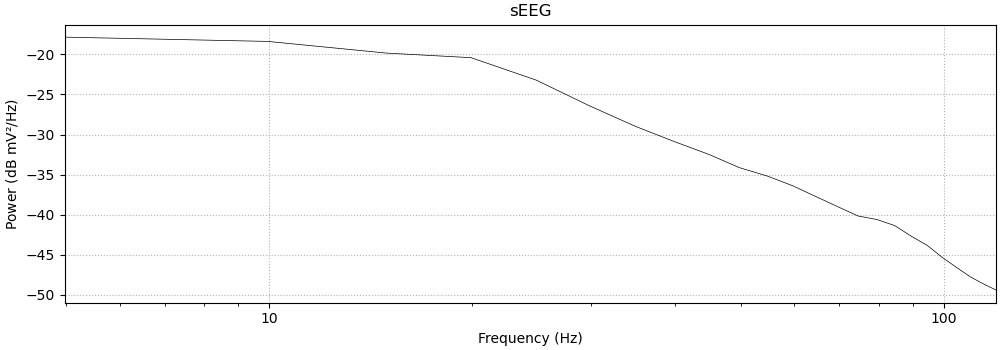

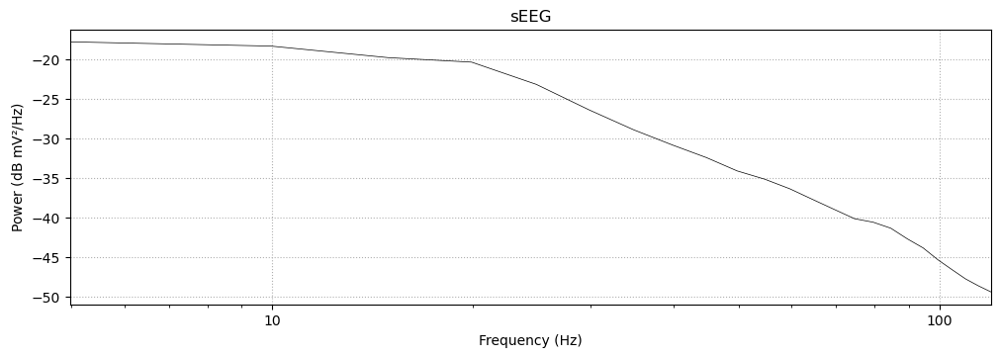

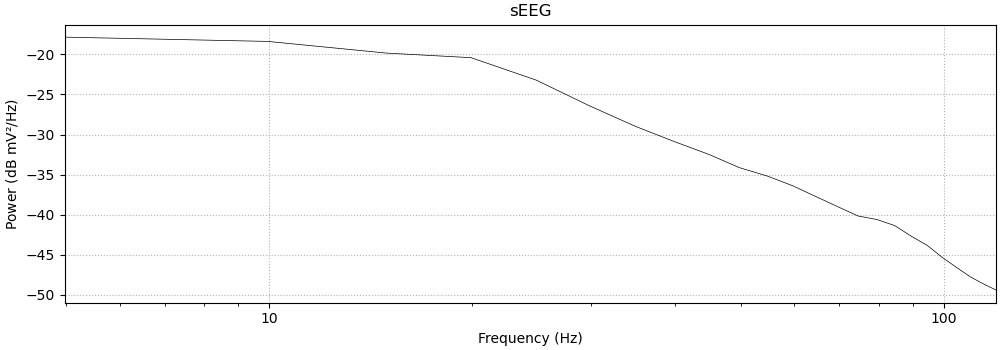

In [53]:
mean_ripples_Norm19_spectrum = epochs_ripples_Norm19_spectrum.average()
mean_ripples_Norm19_spectrum.plot(xscale='log', average=True) 

Ajuste de la densidad de potencia con FOOOF

In [54]:
# Initialize a FOOOF object
fm_ripples_Norm19 = FOOOF()
fm_ripples_Norm19.fit(mean_ripples_Norm19_spectrum.freqs, np.squeeze(mean_ripples_Norm19_spectrum.data))
print(fm_ripples_Norm19.aperiodic_params_)
print(fm_ripples_Norm19.peak_params_)
print(fm_ripples_Norm19._ap_fit.shape)
#fm_ripples_Norm19.plot()


FOOOF WARNING: Lower-bound peak width limit is < or ~= the frequency resolution: 4.98 <= 0.50
	Lower bounds below frequency-resolution have no effect (effective lower bound is the frequency resolution).
	Too low a limit may lead to overfitting noise as small bandwidth peaks.
	We recommend a lower bound of approximately 2x the frequency resolution.

[-5.95467586  2.28046288]
[[21.33705092  0.96468578 12.        ]
 [39.591082    0.67060474 12.        ]
 [59.7742165   0.52825801 12.        ]]
(24,)


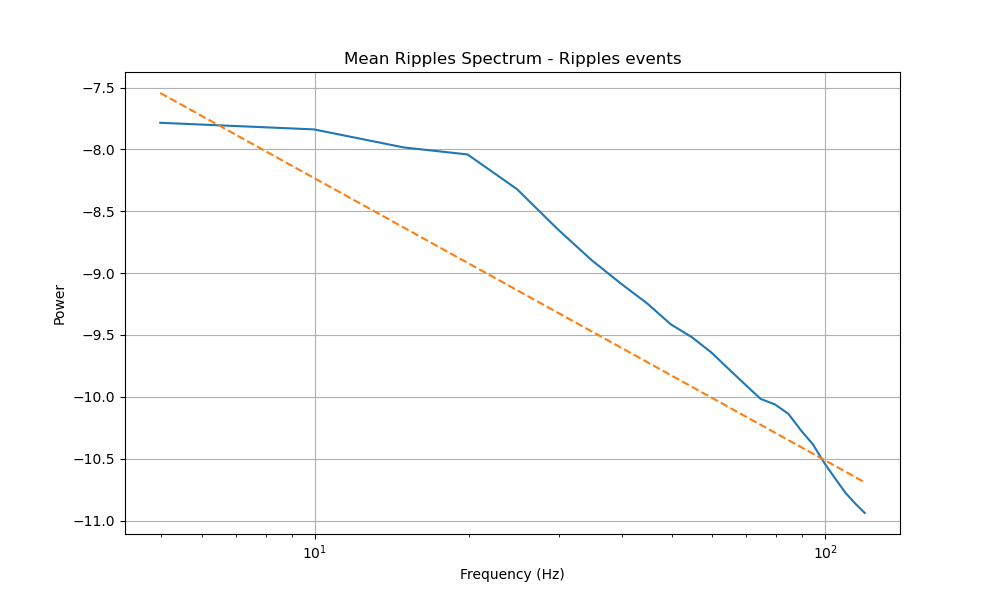

In [55]:
# Extract the aperiodic component from the FOOOF model
aperiodic_fit_ripples_Norm19 = fm_ripples_Norm19._ap_fit

plt.figure(figsize=(10, 6))
plt.plot(mean_ripples_Norm19_spectrum.freqs, np.log10(mean_ripples_Norm19_spectrum.data.T))
plt.plot(mean_ripples_Norm19_spectrum.freqs, aperiodic_fit_ripples_Norm19, label='Aperiodic Component', linestyle='--')
plt.xscale('log')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.title('Mean Ripples Spectrum - Ripples events')
plt.grid(True)
plt.show()


## Visualizacion de ripples detectados

In [56]:
# Compute EMD on the whole signal
#imf_eeg_signal = emd.sift.sift(ieeg_signal[0], max_imfs=5)
imf_eeg_signal = emd.sift.ensemble_sift(ieeg_signal[0], max_imfs=10)
print(imf_eeg_signal.shape)
print(type(imf_eeg_signal))

(366360, 10)
<class 'numpy.ndarray'>


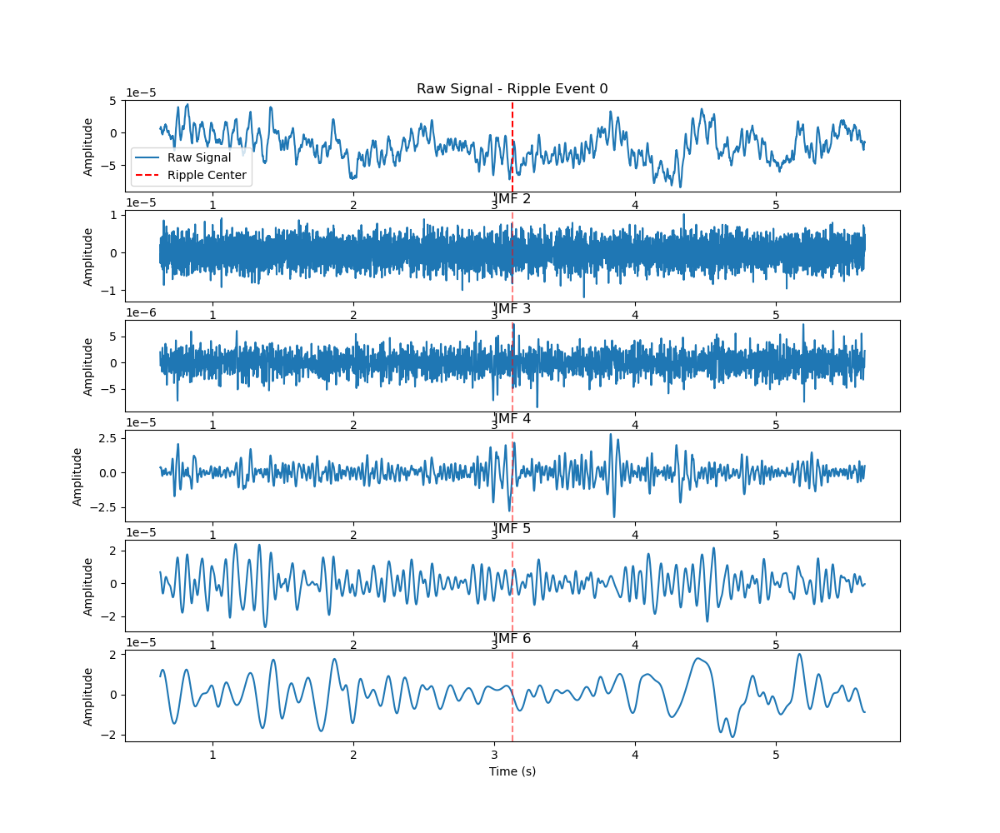

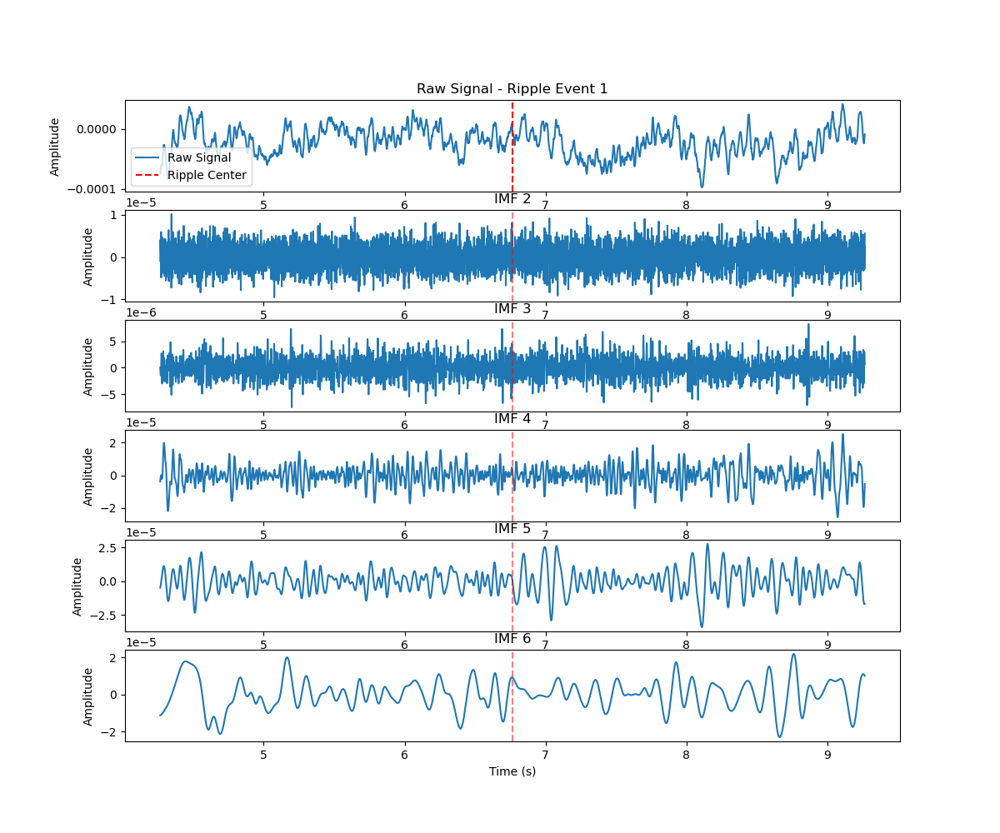

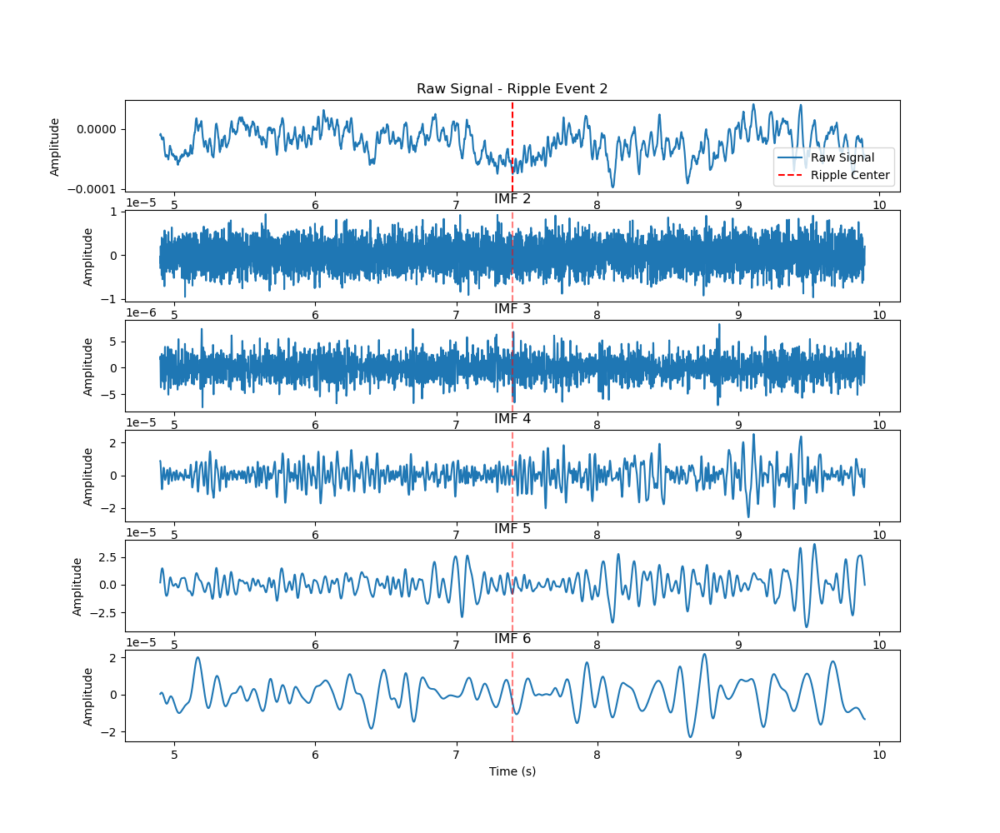

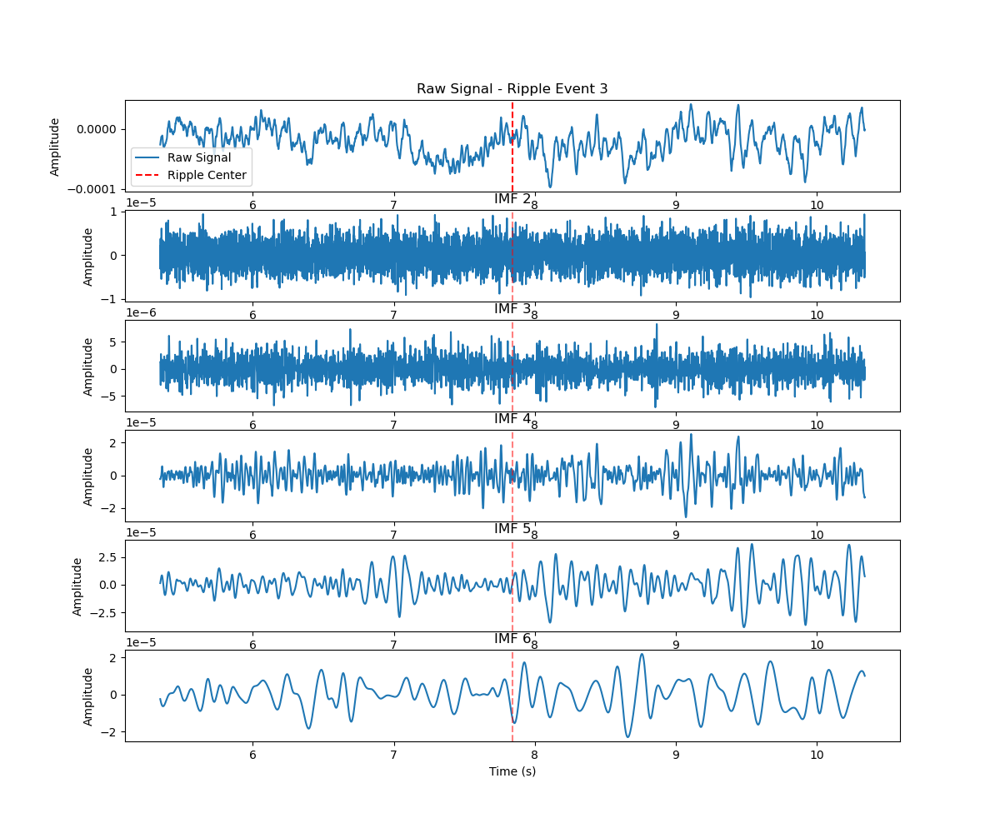

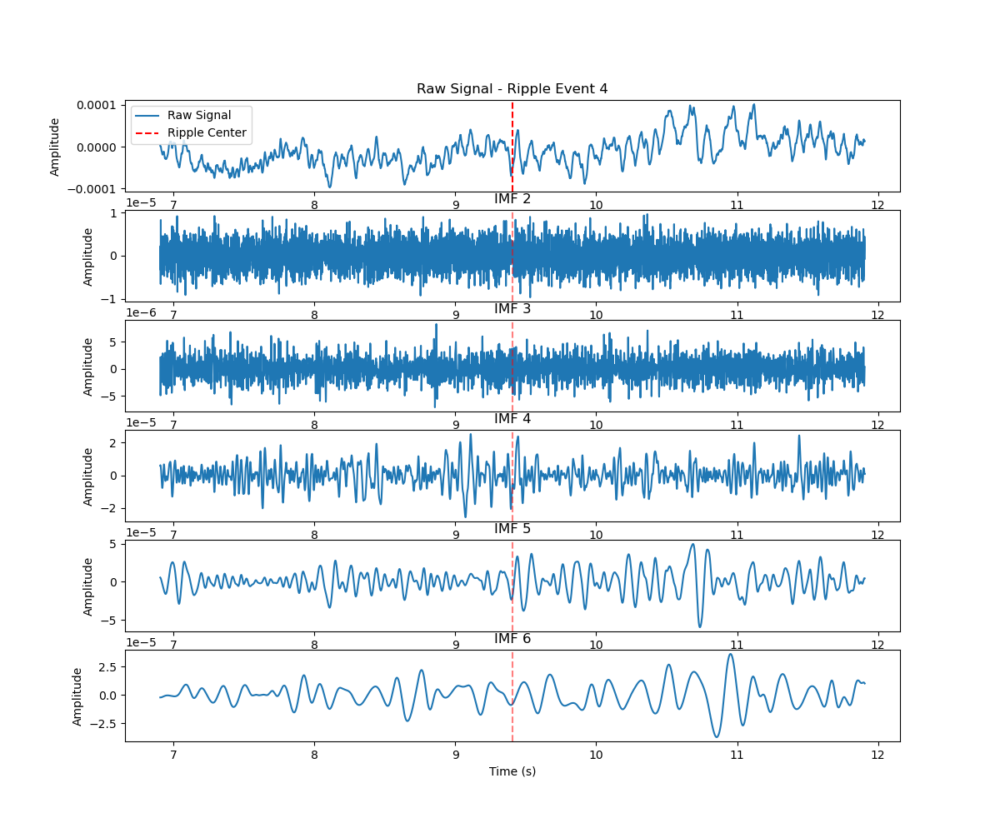

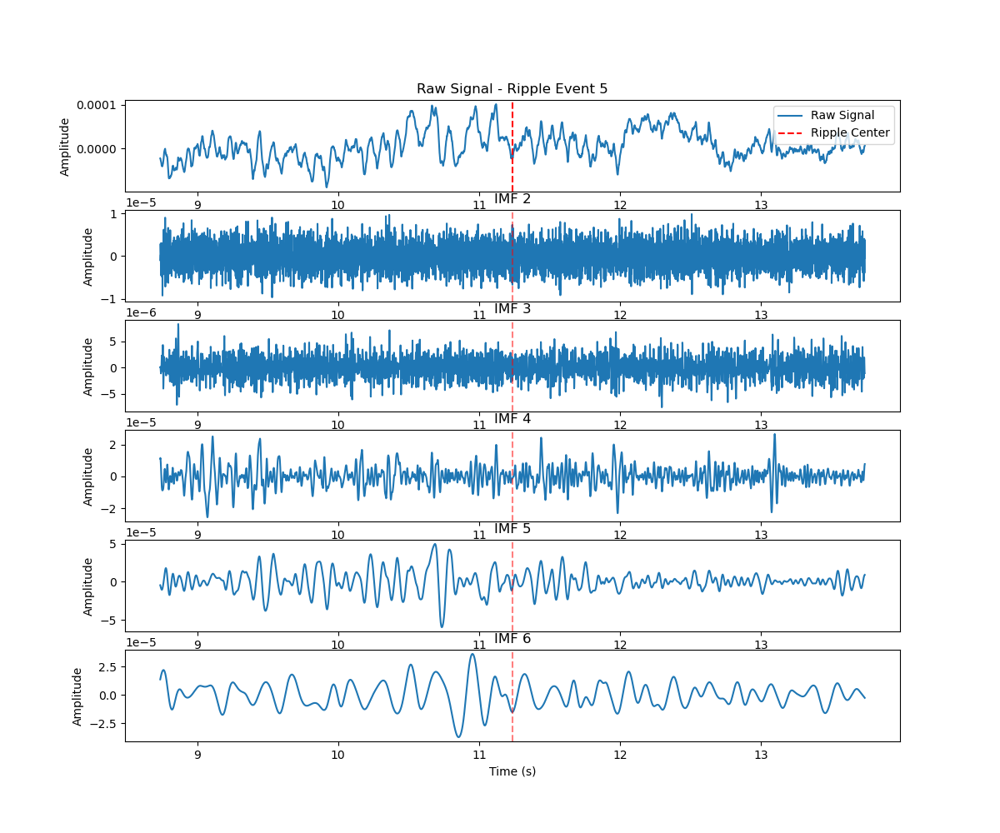

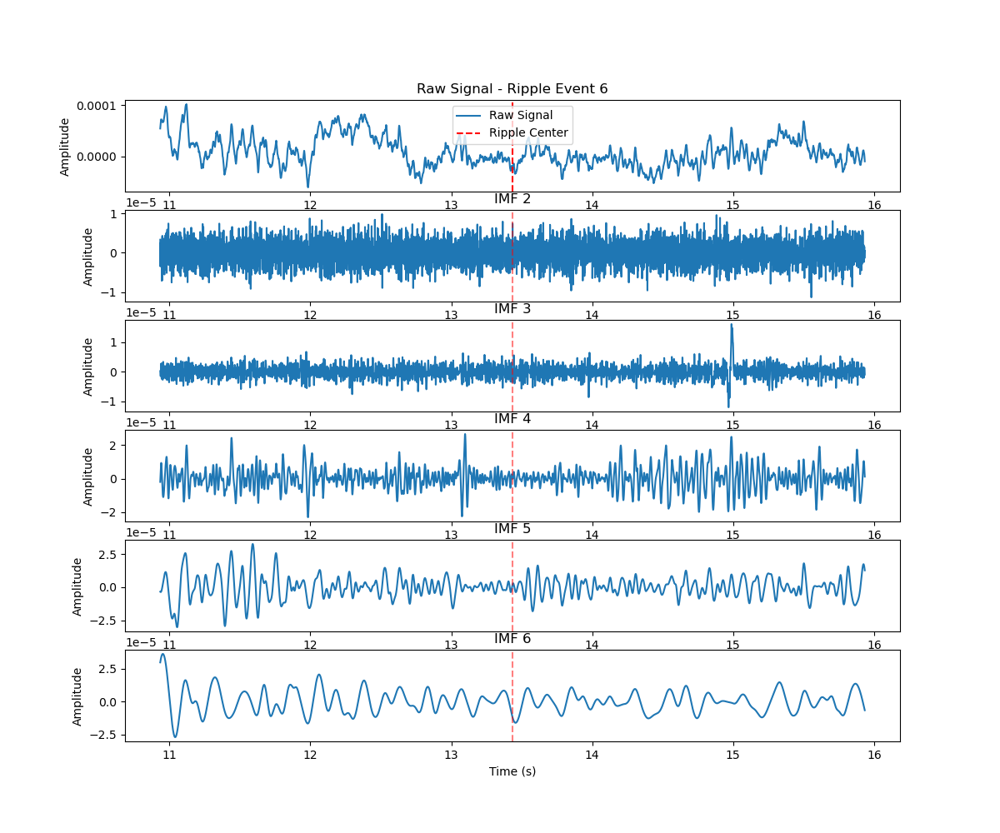

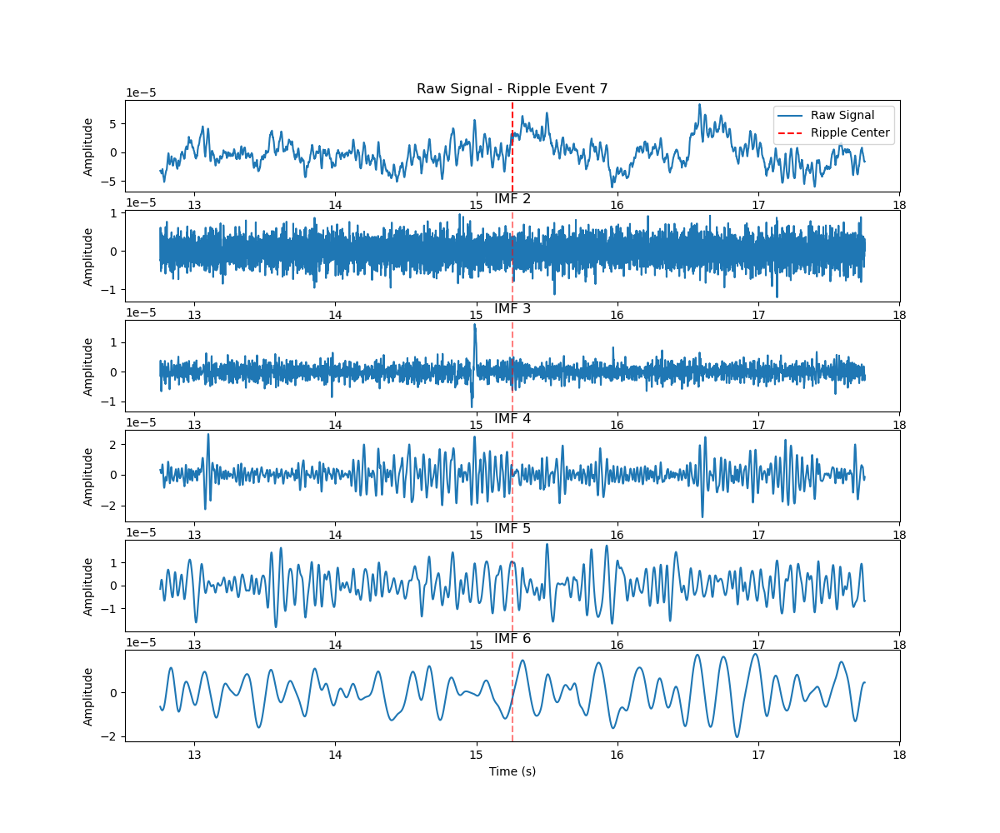

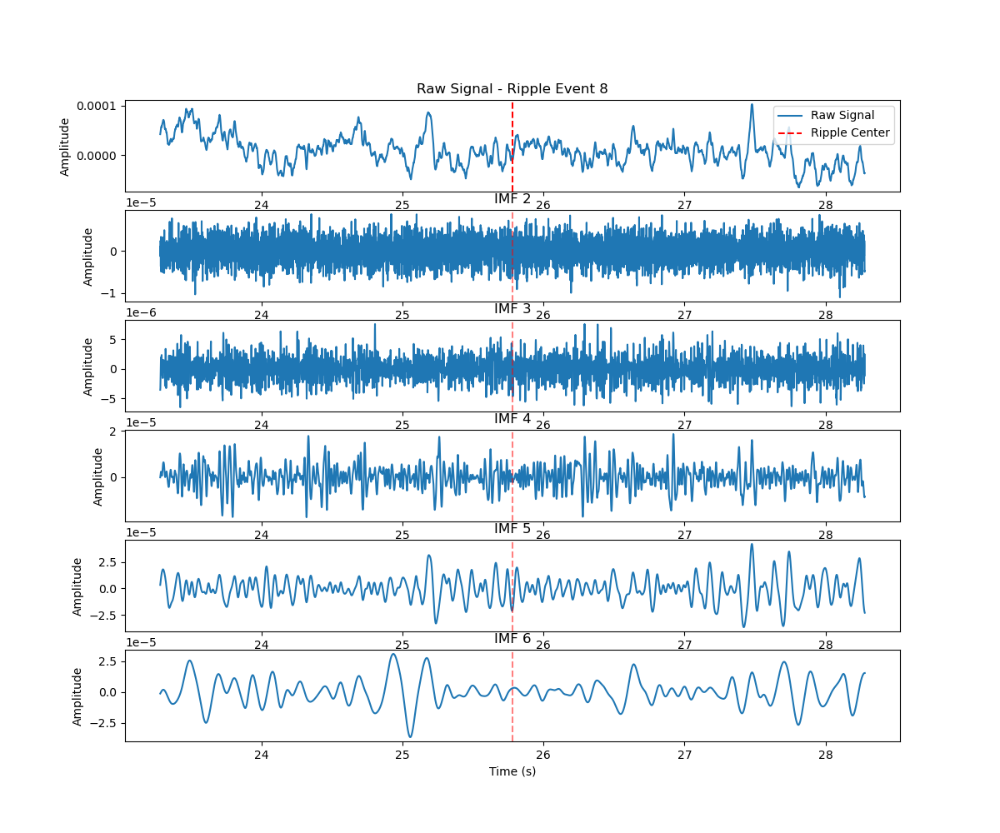

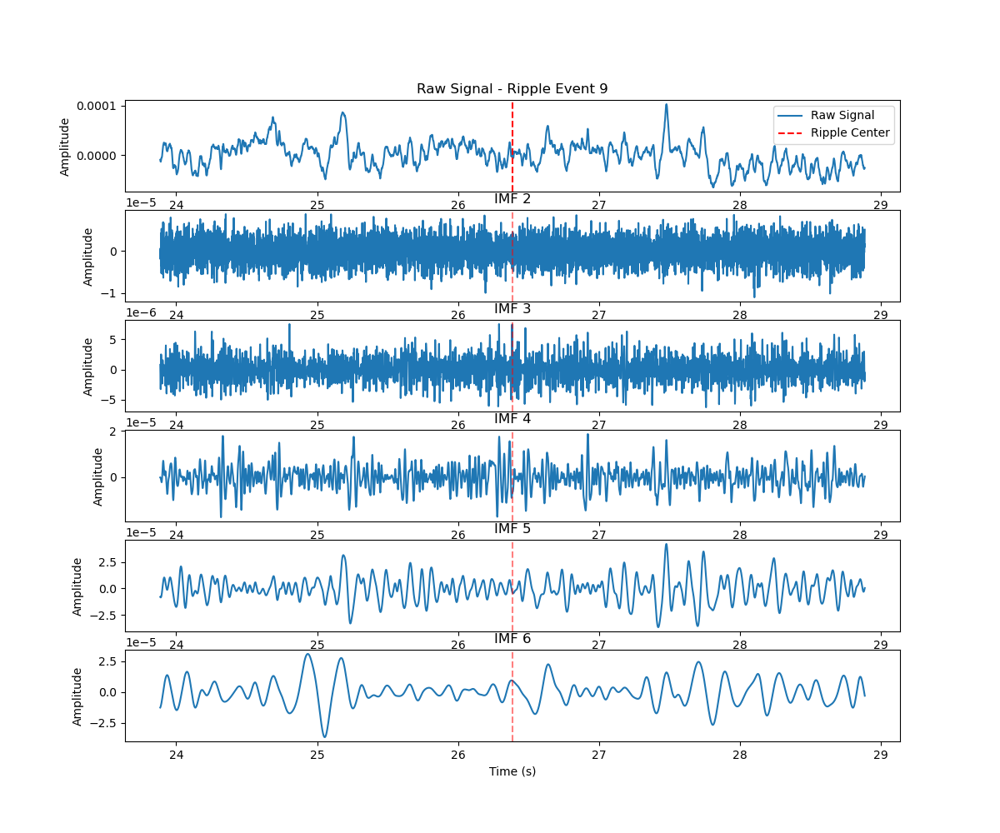

In [57]:
# ------------
signal_in = ieeg_signal
srate = int(fsample)
t_range = 2.5 # time range ± ripple trough (sec)
# ------------

# Iterate over each identified ripple
cant_epochs_show = 10

for ripple, n_iter in zip(trl_ripples_Norm19_clean[0:cant_epochs_show,:], range(cant_epochs_show)):

    ripple_center = int(ripple[0] + np.abs(ripple[2]))
    
    # Define the start and end of the segment
    start_idx = int(ripple[0])#ripple_center - window_samples
    end_idx = int(ripple[1]) #ripple_center + window_samples
    
    # Extract the segment
    segment_raw = signal_in[0, start_idx:end_idx]
    segment_times = times[start_idx:end_idx]

    imf_eeg_signal_segment = imf_eeg_signal[start_idx:end_idx, :]

    # Create a new figure with GridSpec
    cant_sp = 6 # cantidad de subplots
    fig = plt.figure(figsize=(12, 10))
    gs = gridspec.GridSpec(cant_sp,1)
    for i in range(cant_sp):
        if i==0: # raw data

            ax1 = fig.add_subplot(gs[i,:])  # This spans both columns of the last row
            ax1.plot(segment_times, segment_raw, label='Raw Signal')
            ax1.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
            ax1.set_title(f'Raw Signal - Ripple Event {n_iter}')
            ax1.set_xlabel('Time (s)')
            ax1.set_ylabel('Amplitude')
            ax1.legend()
        
        else:
            ax2 = fig.add_subplot(gs[i,:])  # This spans both columns of the last row
            ax2.plot(segment_times, imf_eeg_signal_segment[:, i-1])
            ax2.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center', alpha=0.5)
            ax2.set_title(f'IMF {i + 1}')
            ax2.set_xlabel('Time (s)')
            ax2.set_ylabel('Amplitude')
            ax2.sharex(ax1)
    '''       
    # Create subplots using GridSpec
    #axs = []
    
    ax1 = fig.add_subplot(gs[0, :])  # This spans both columns of the last row
    ax1.plot(segment_times, segment_raw, label='Raw Signal')
    ax1.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    ax1.set_title(f'Raw Signal - Ripple Event {n_iter}')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Amplitude')
    ax1.legend()'''

    #emd.plotting.plot_imfs(imf_eeg_signal_segment)

    

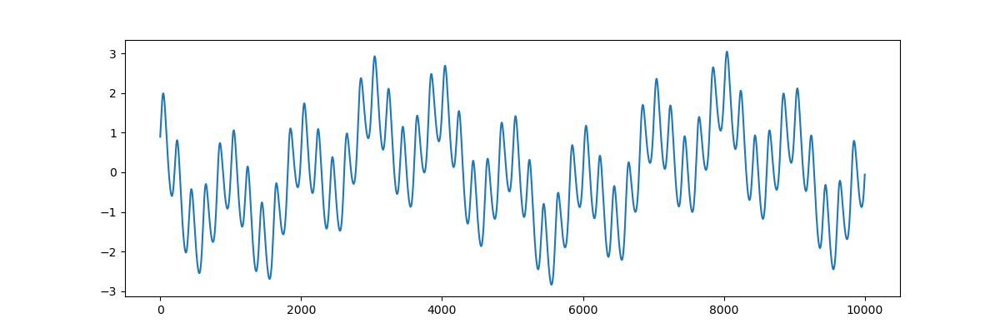

In [185]:
sample_rate = 1000
seconds = 10
num_samples = sample_rate*seconds

time_vect = np.linspace(0, seconds, num_samples)

freq = 5

# Change extent of deformation from sinusoidal shape [-1 to 1]
nonlinearity_deg = 0.25

# Change left-right skew of deformation [-pi to pi]
nonlinearity_phi = -np.pi/4

# Compute the signal

# Create a non-linear oscillation
x = emd.simulate.abreu2010(freq, nonlinearity_deg, nonlinearity_phi, sample_rate, seconds)

x += np.cos(2 * np.pi * 1 * time_vect)        # Add a simple 1Hz sinusoid
x -= np.sin(2 * np.pi * 2.2e-1 * time_vect)   # Add part of a very slow cycle as a trend

# Visualise the time-series for analysis
plt.figure(figsize=(12, 4))
plt.plot(x)

In [186]:
imf = emd.sift.sift(x)
print(imf.shape)

(10000, 4)


In [187]:
IP, IF, IA = emd.spectra.frequency_transform(imf, sample_rate, 'hilbert')

In [188]:
# Define frequency range (low_freq, high_freq, nsteps, spacing)
freq_range = (0.1, 10, 80, 'log')
f, hht = emd.spectra.hilberthuang(IF, IA, freq_range, sum_time=False)

In [192]:
imf.shape

(10000, 4)

<Axes: xlabel='Time (samples)'>

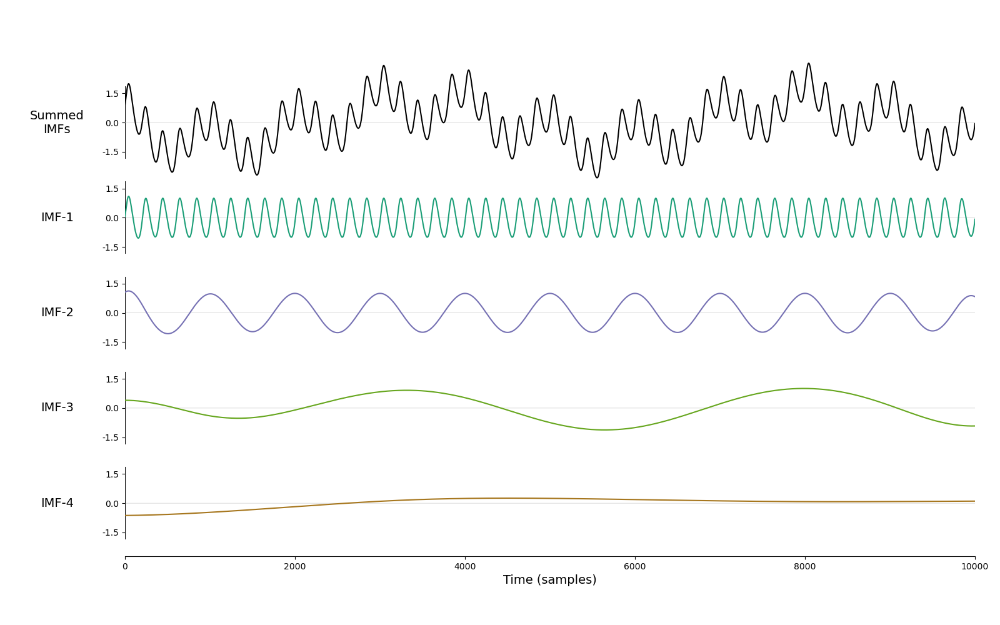

In [189]:
emd.plotting.plot_imfs(imf)

<Axes: title={'center': 'Hilbert-Huang Transform'}, xlabel='Time', ylabel='Frequency'>

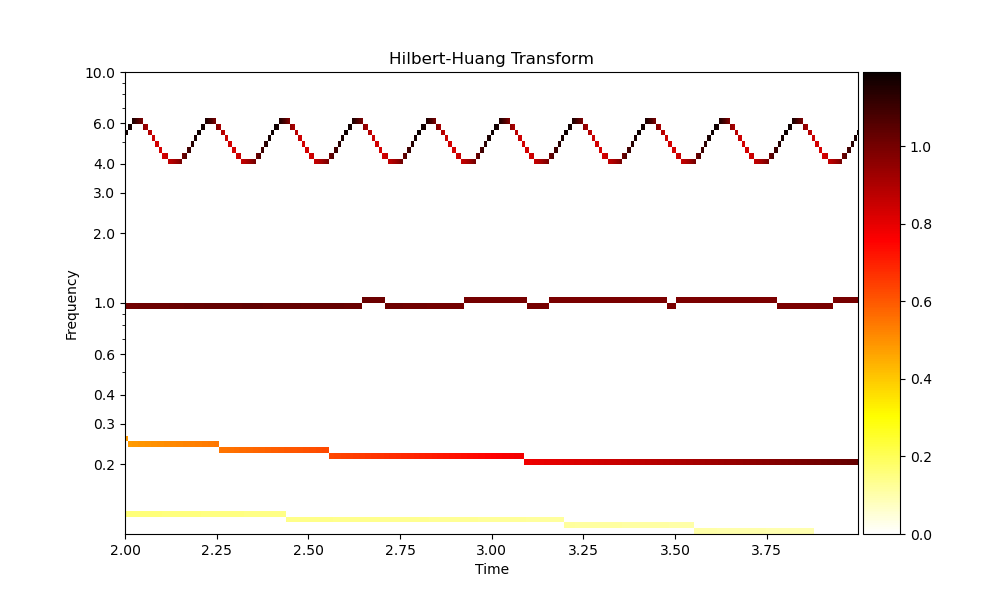

In [190]:
fig = plt.figure(figsize=(10, 6))
emd.plotting.plot_hilberthuang(hht, time_vect, f,
                               time_lims=(2, 4), freq_lims=(0.1, 15),
                               fig=fig, log_y=True)

GRAFICAS: figuras de los ripples detectados para ver la señal cruda, la señal filtrada y el modulo de la T.Hilbert y verificar que tengan punta de ripple

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


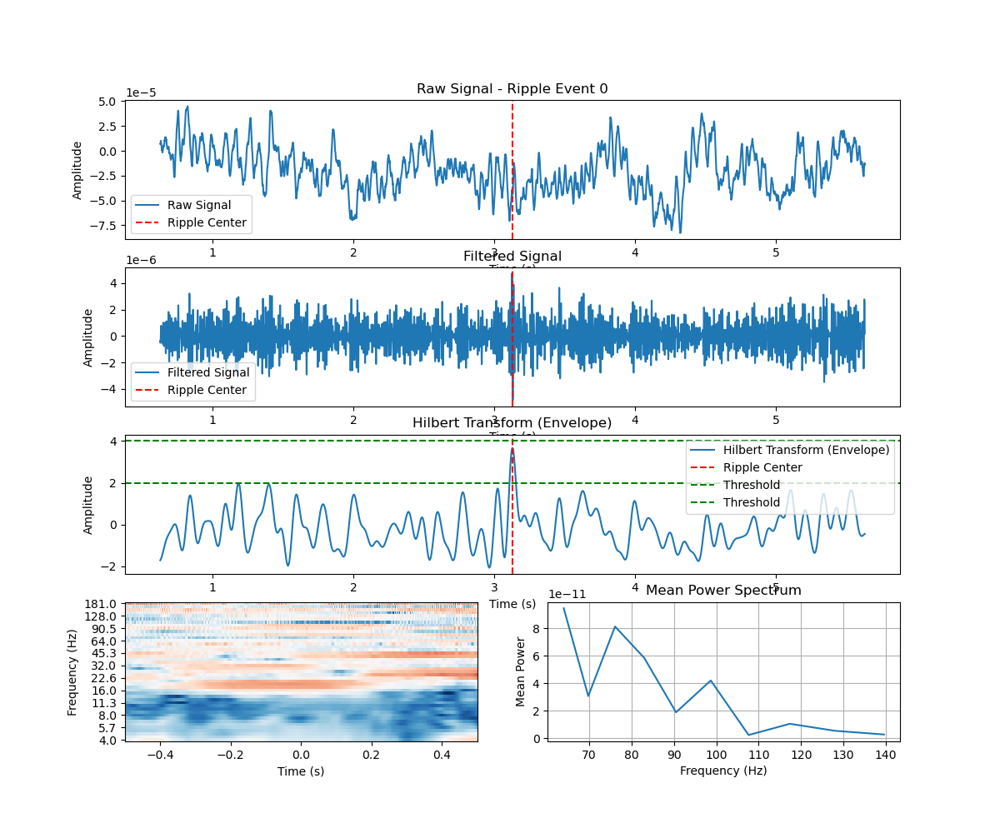

This is a valid ripple!
Applying baseline correction (mode: logratio)


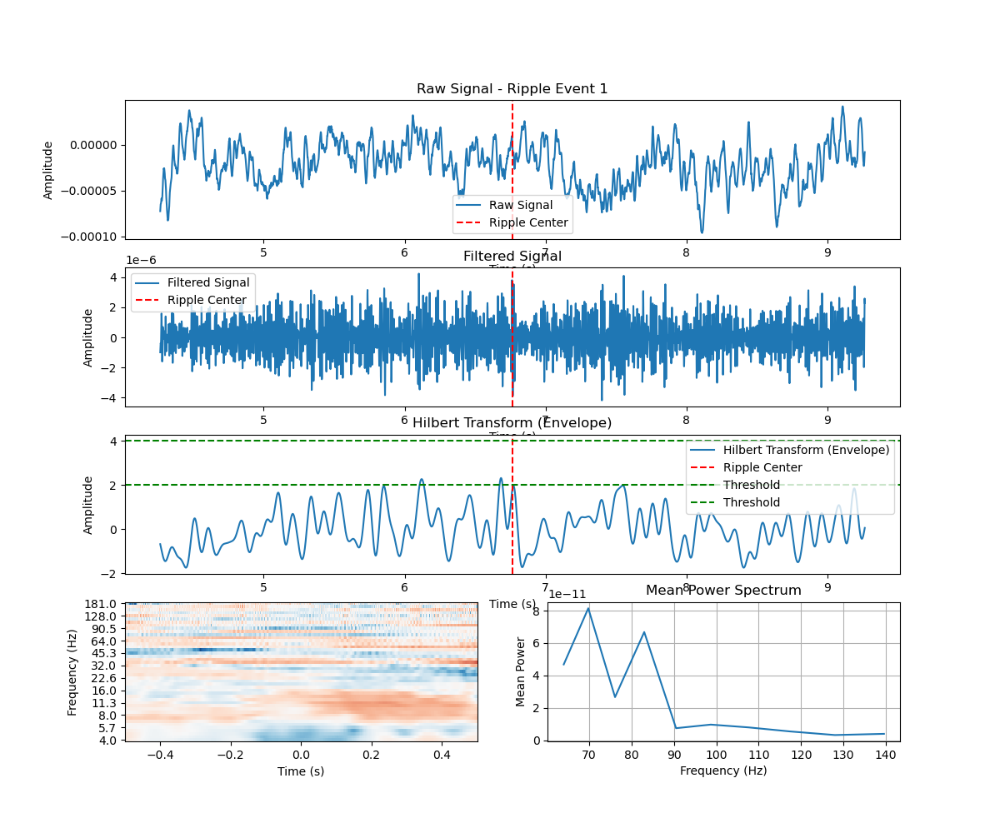

This is a valid ripple!
Applying baseline correction (mode: logratio)


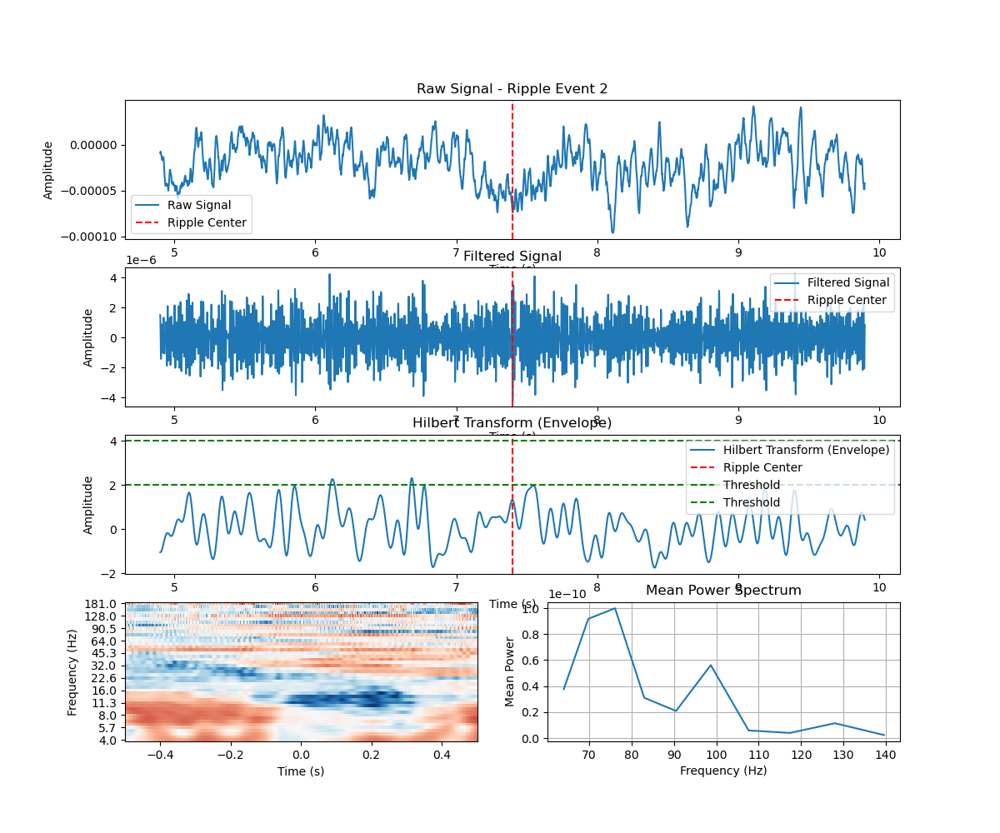

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


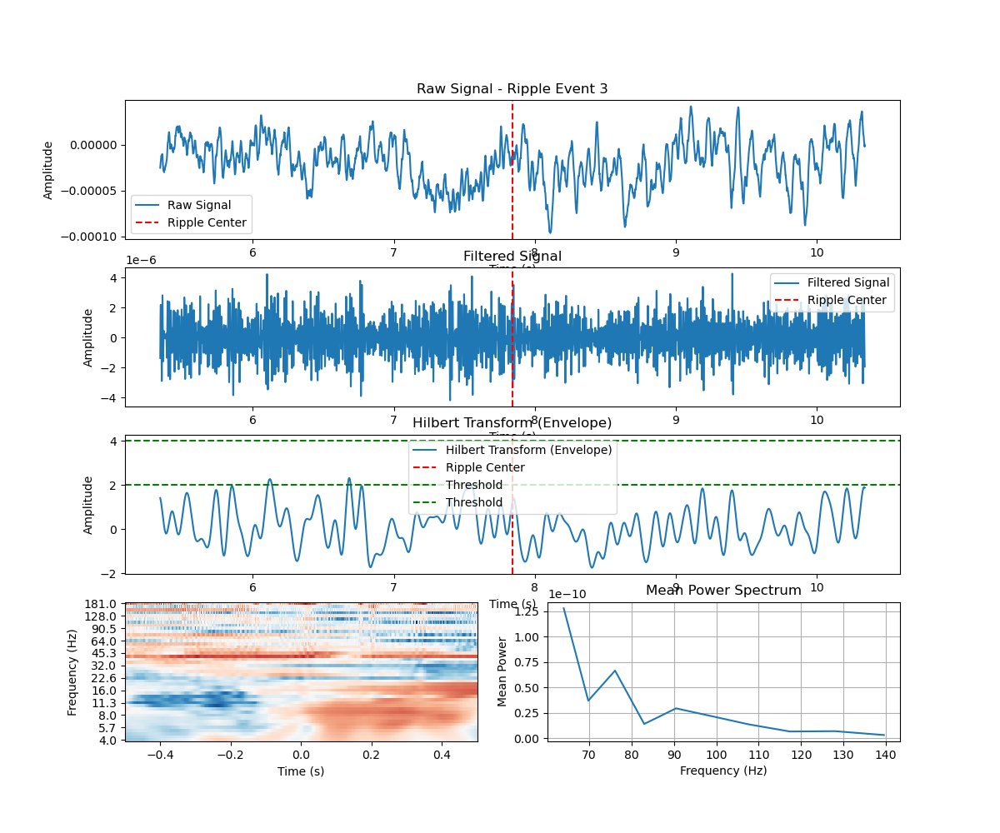

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


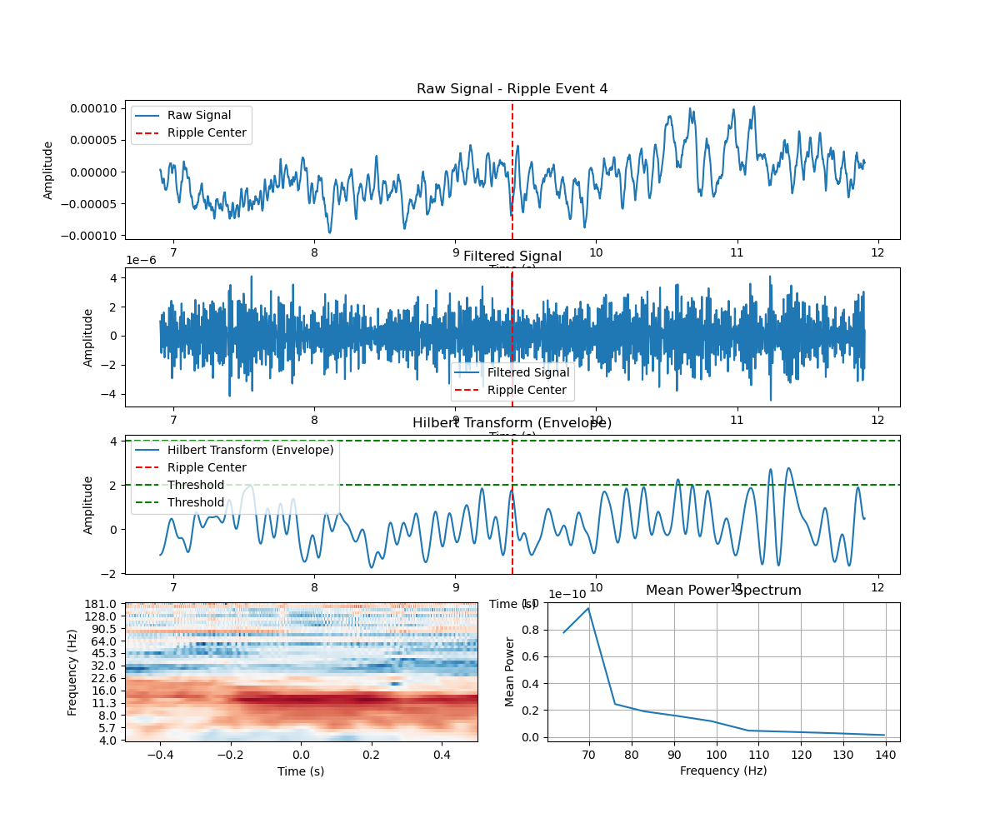

This is a valid ripple!
Applying baseline correction (mode: logratio)


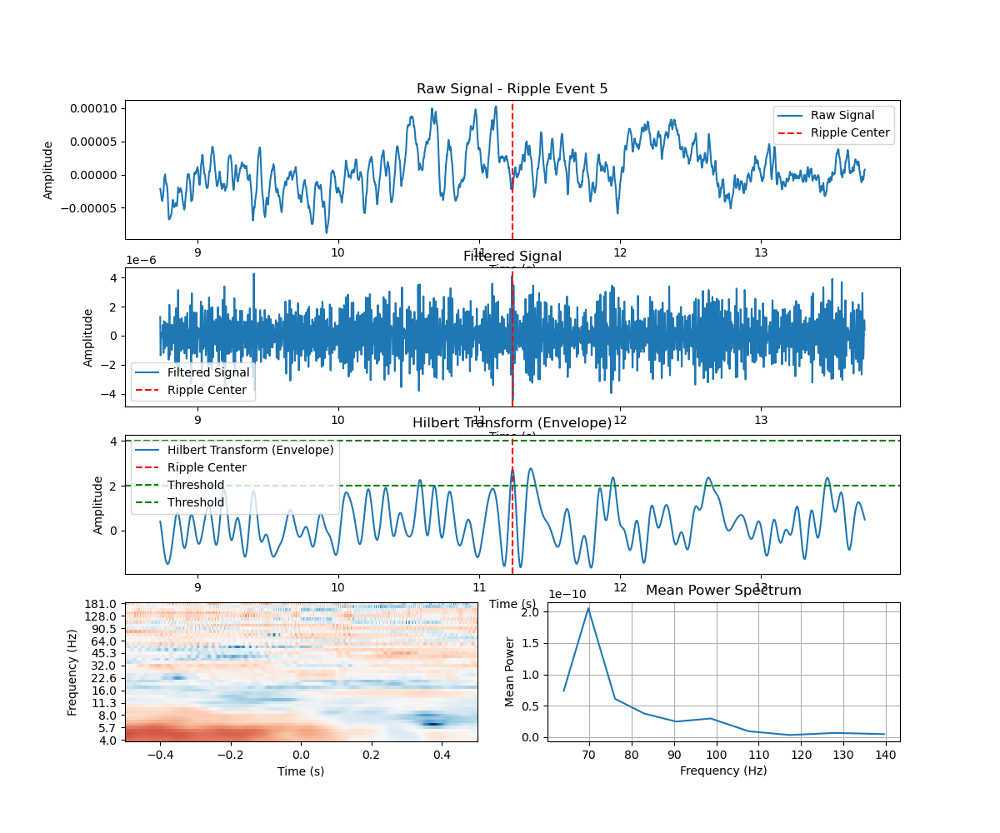

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


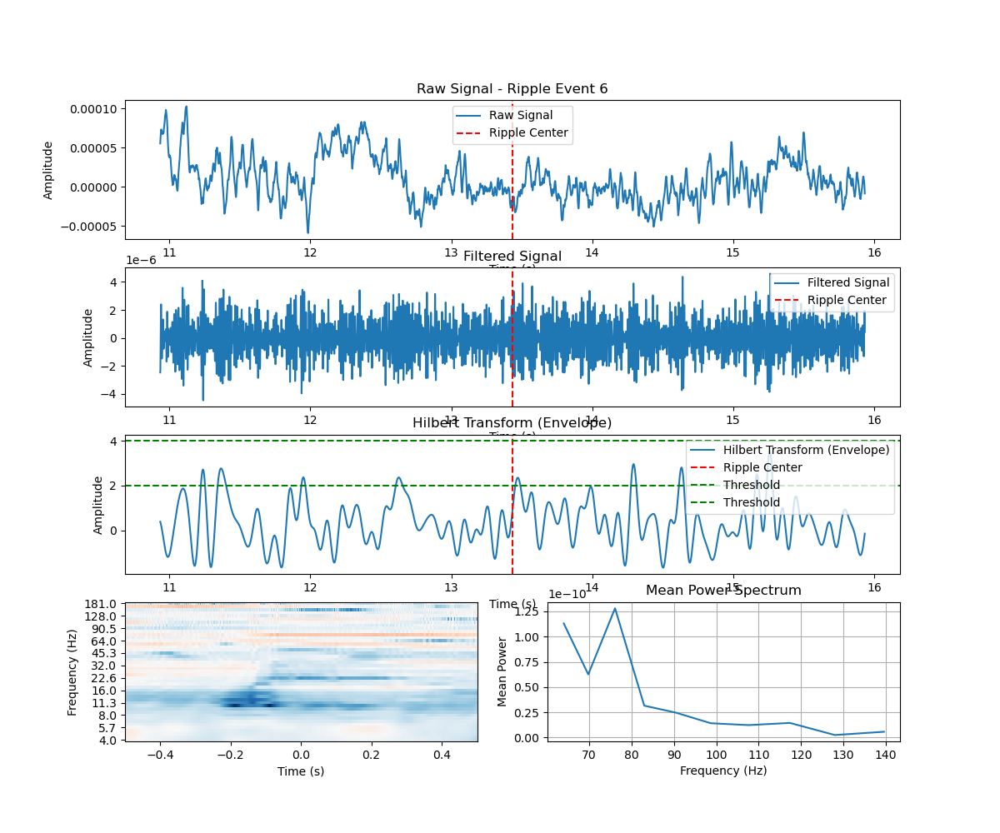

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


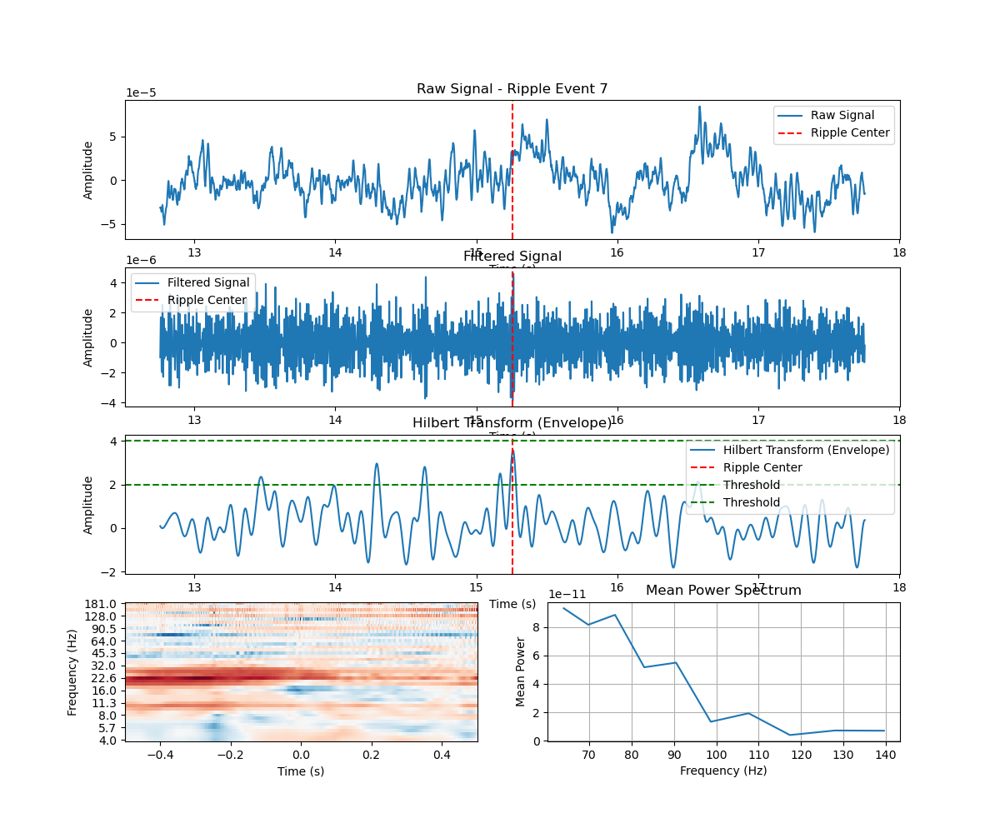

This is NOT a valid ripple!


/tmp/ipykernel_1032365/930563266.py:119: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 10))


Applying baseline correction (mode: logratio)


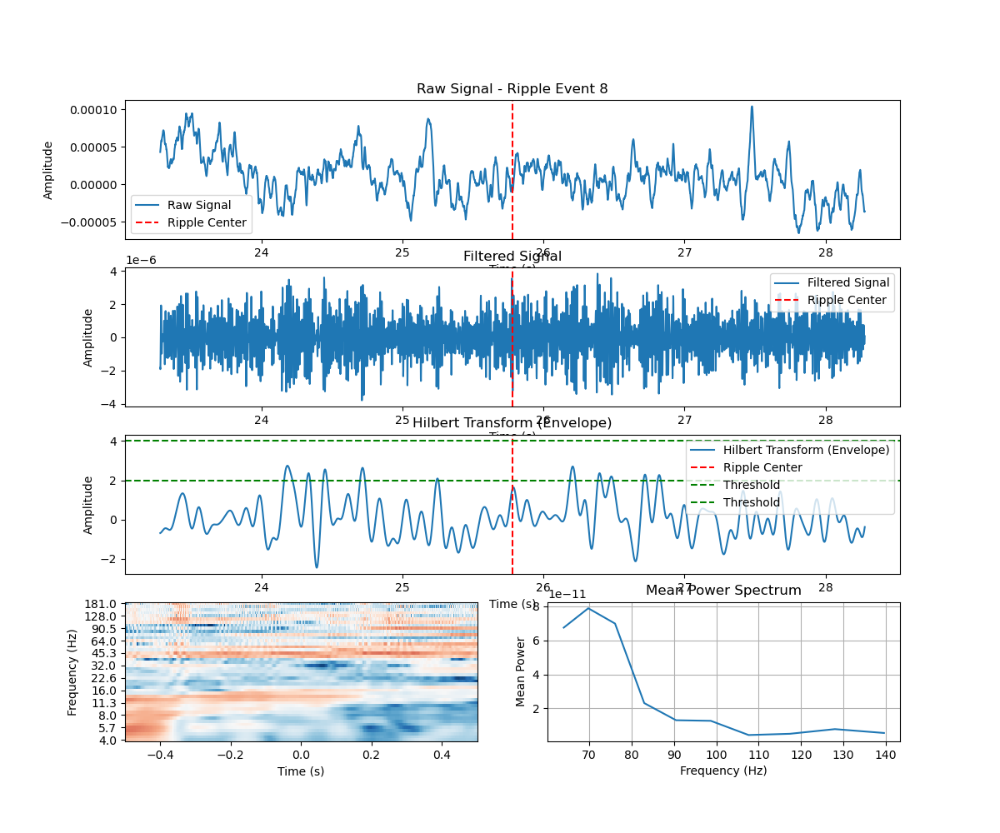

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


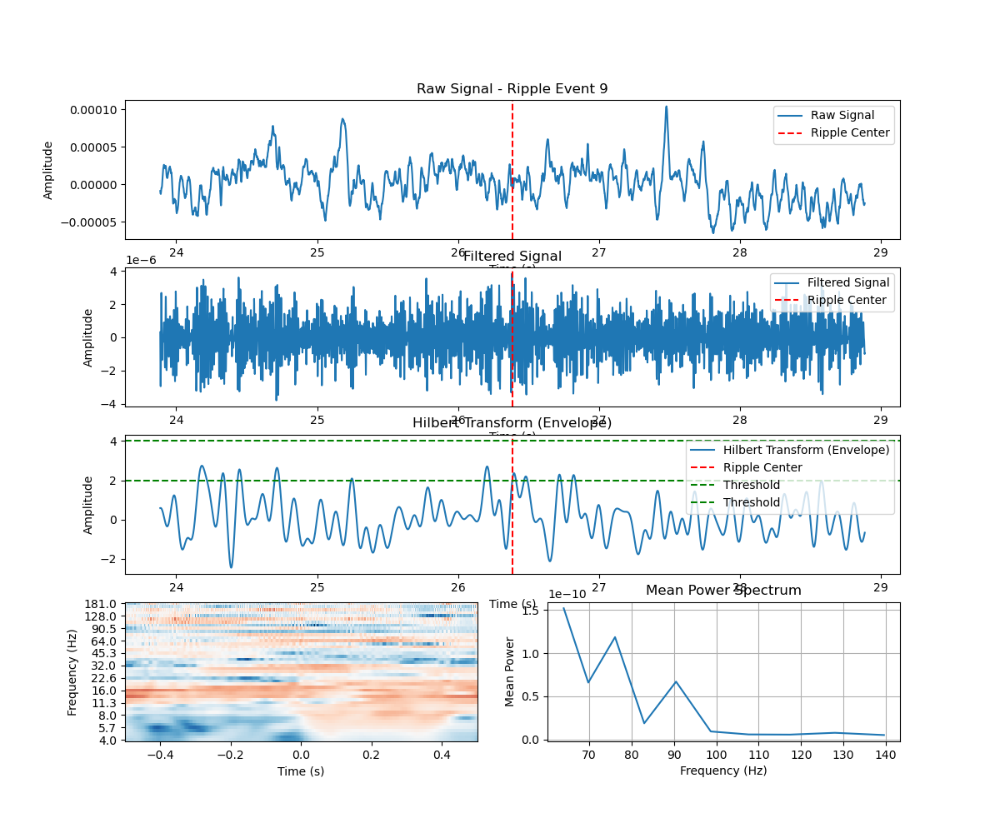

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


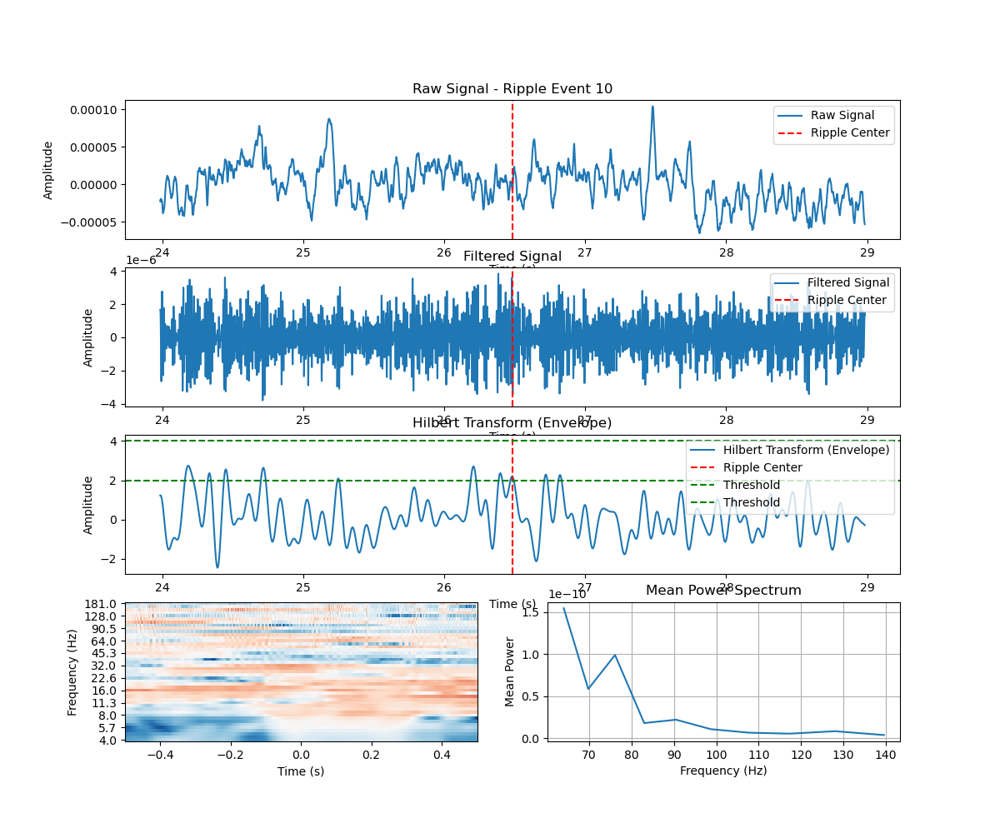

This is a valid ripple!
Applying baseline correction (mode: logratio)


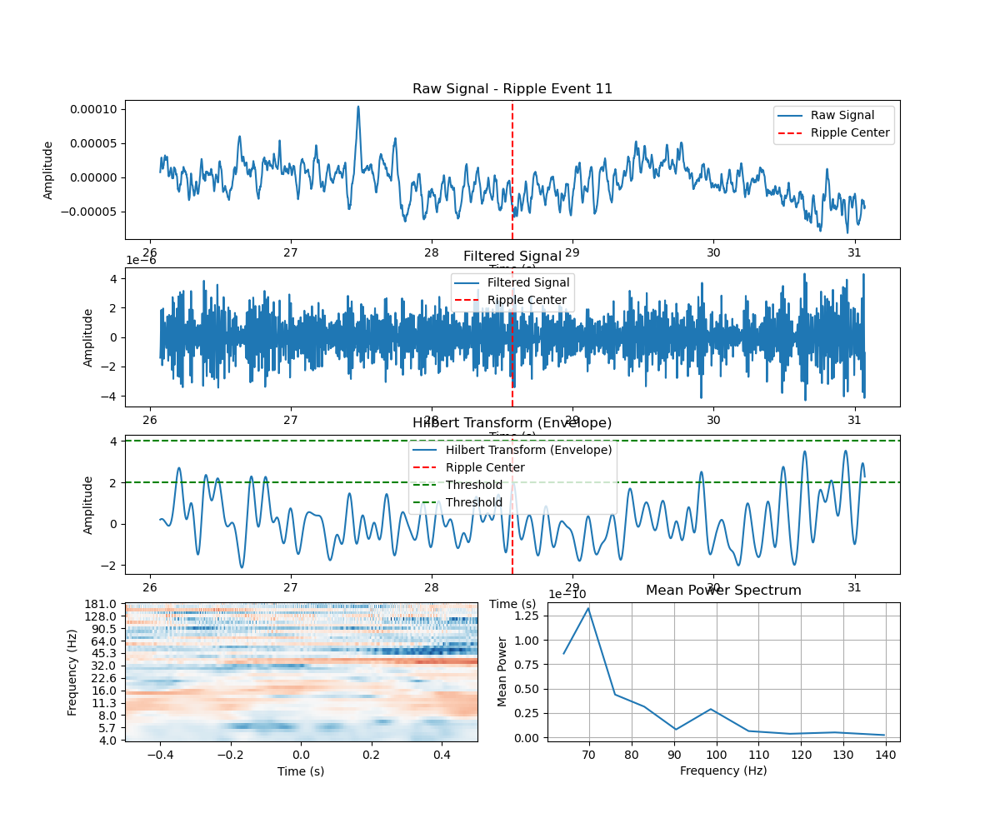

This is a valid ripple!
Applying baseline correction (mode: logratio)


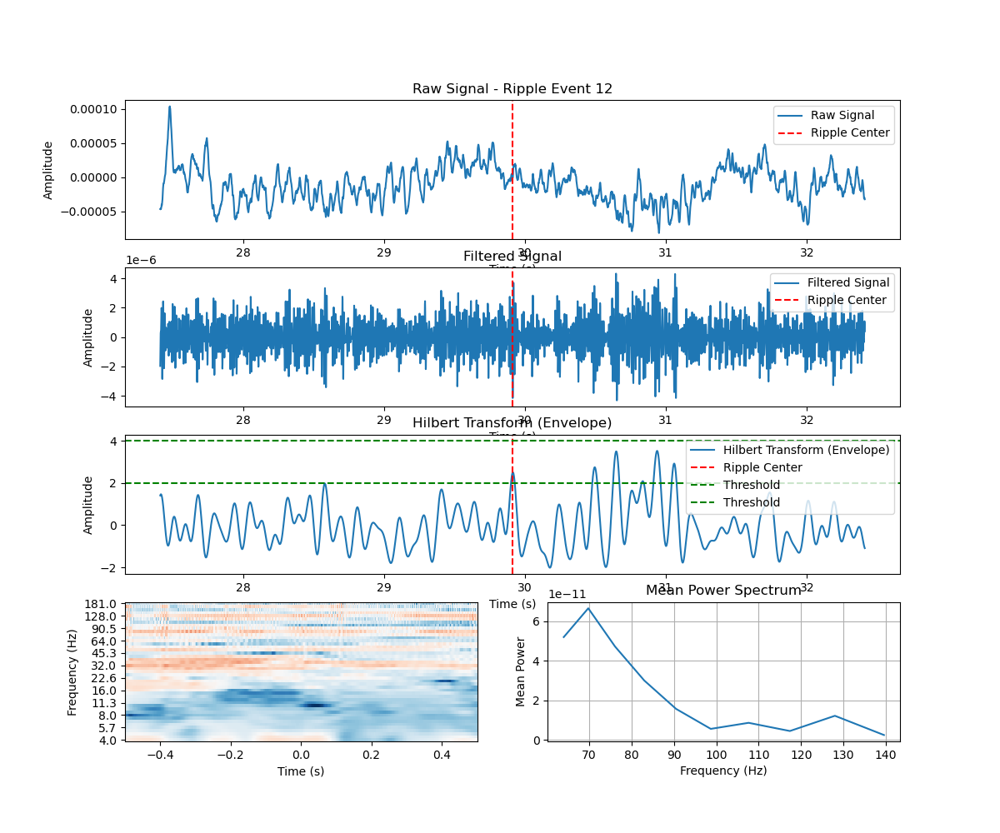

This is a valid ripple!
Applying baseline correction (mode: logratio)


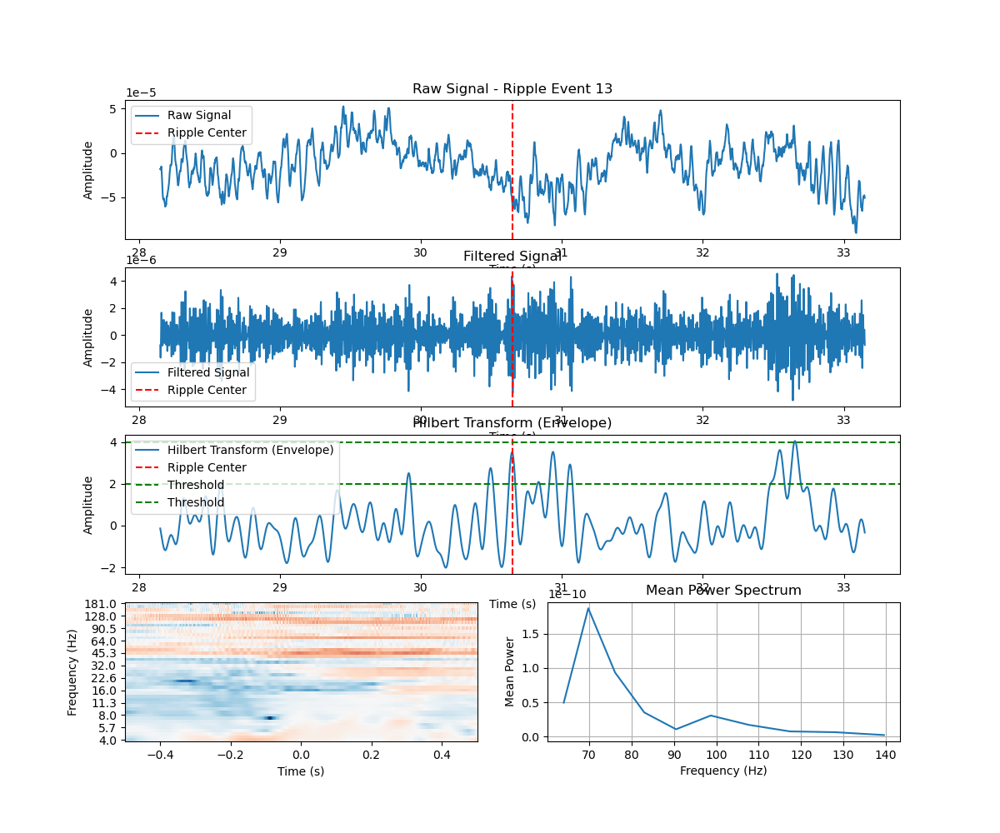

This is a valid ripple!
Applying baseline correction (mode: logratio)


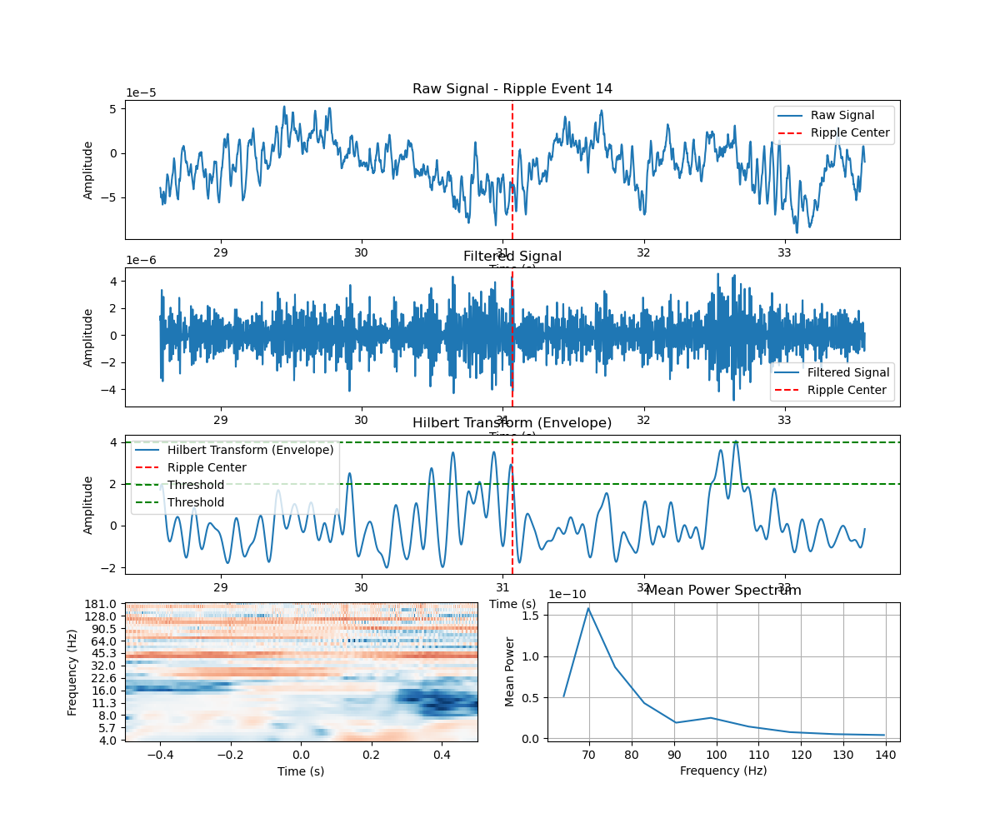

This is a valid ripple!
Applying baseline correction (mode: logratio)


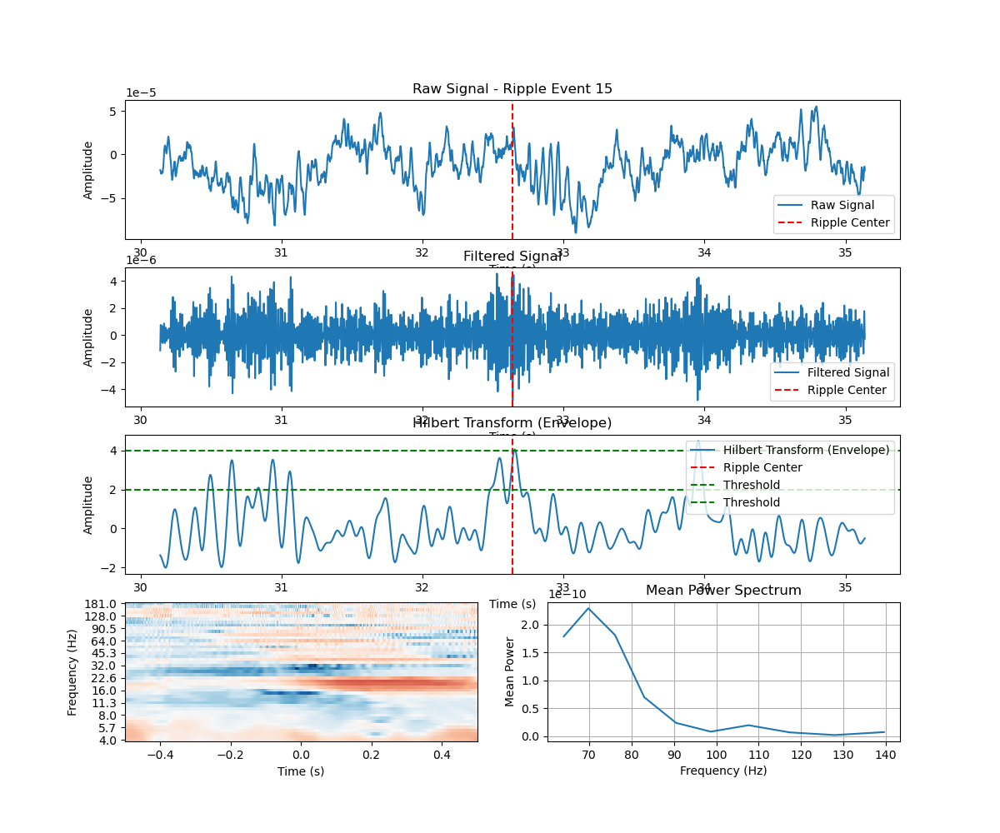

This is a valid ripple!
Applying baseline correction (mode: logratio)


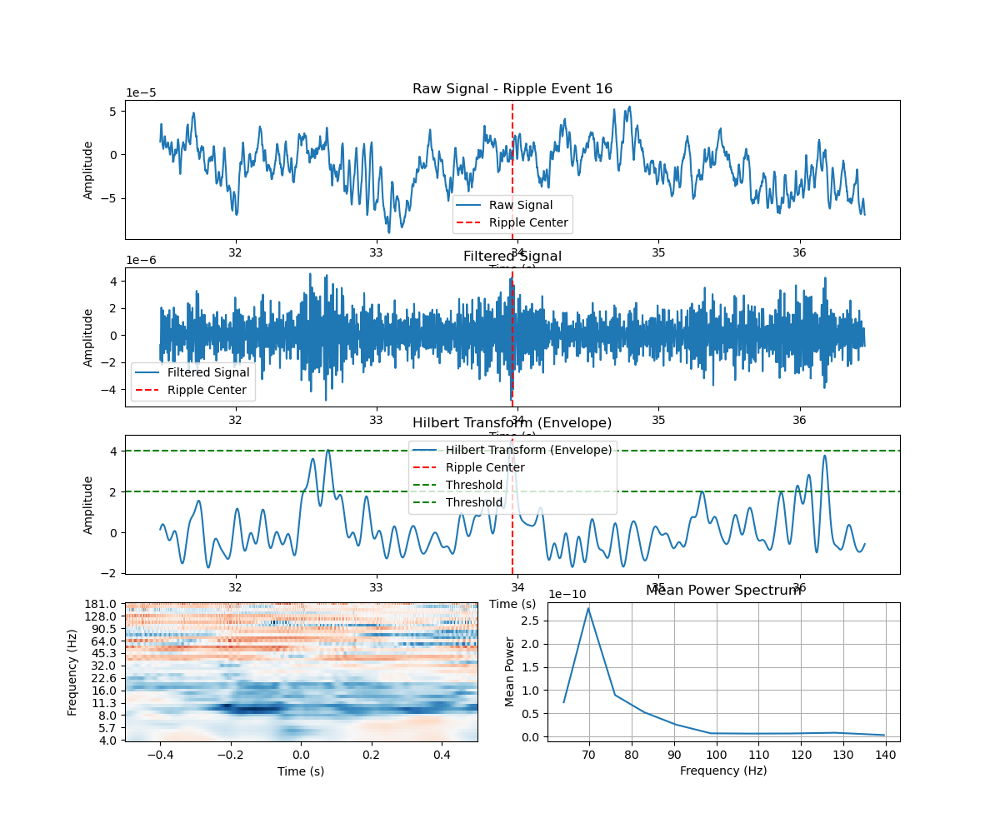

This is a valid ripple!
Applying baseline correction (mode: logratio)


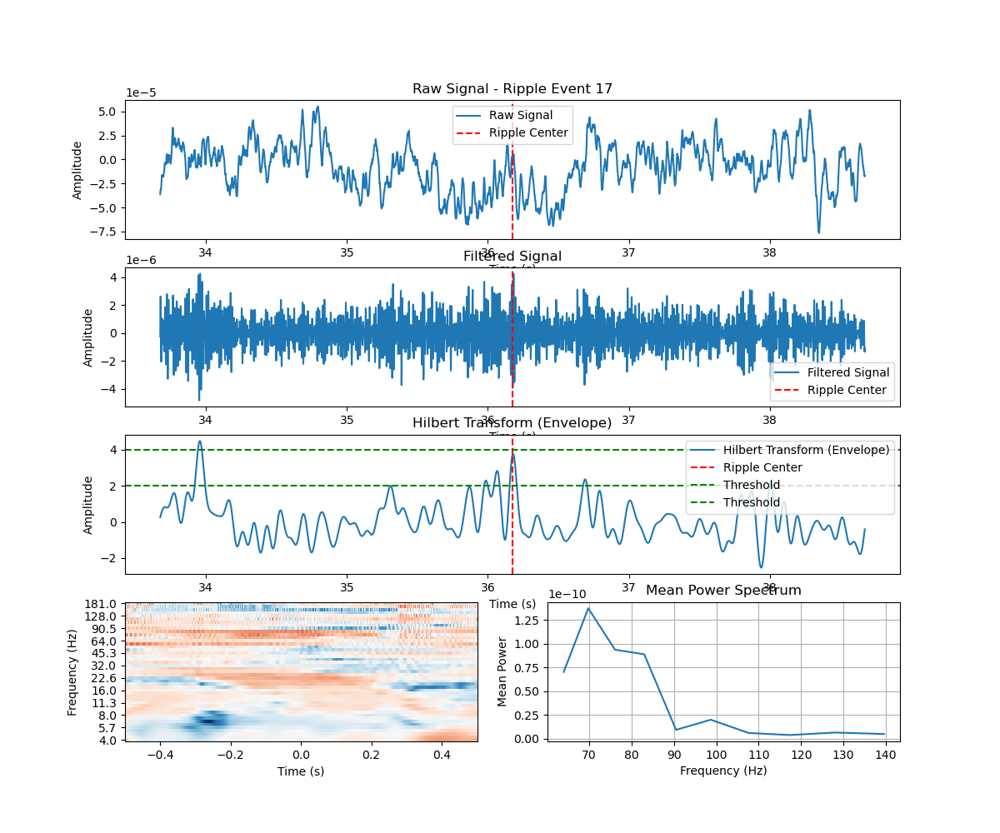

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


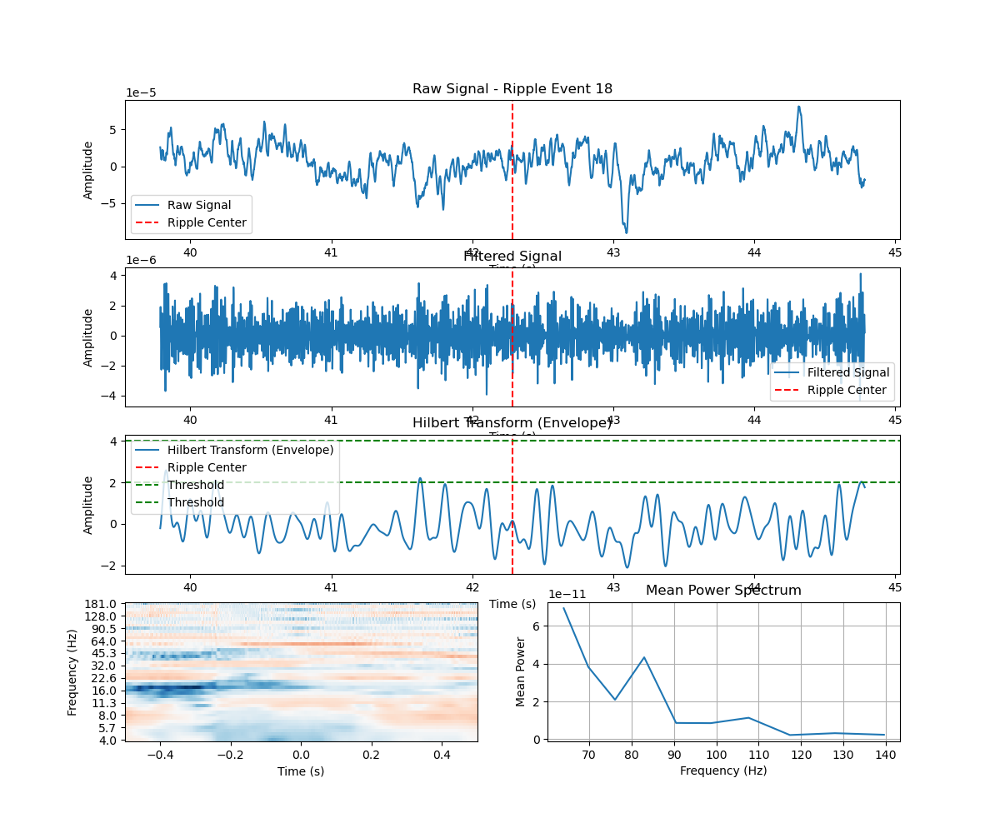

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


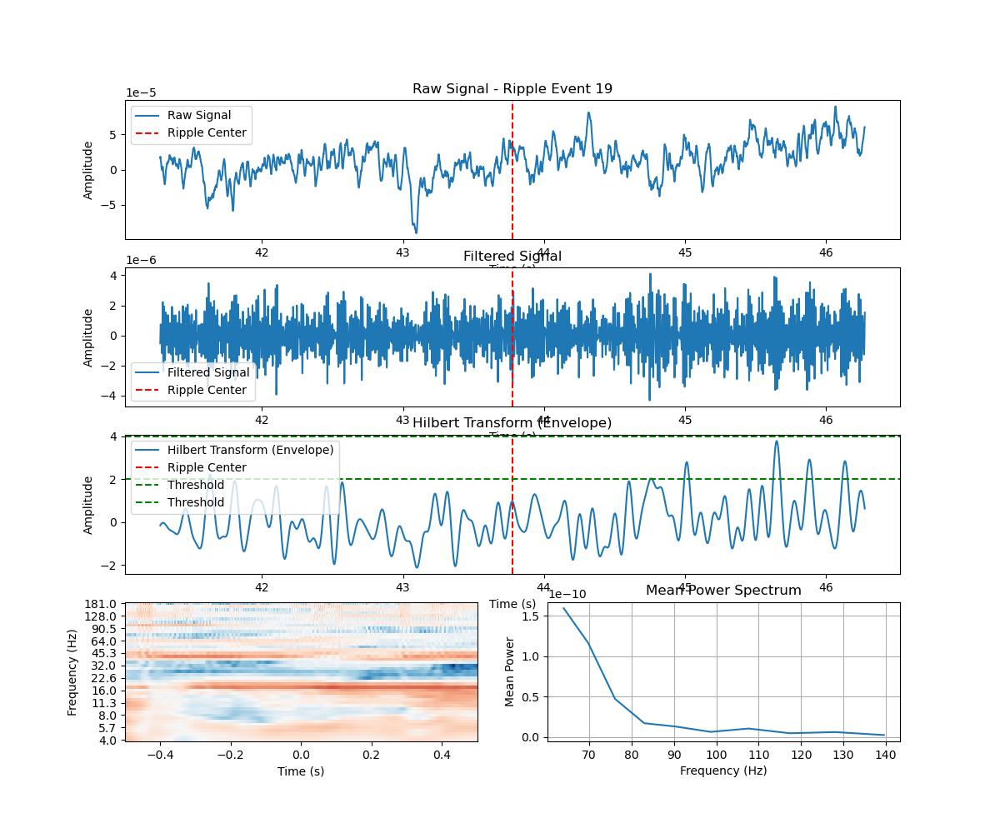

This is a valid ripple!
Applying baseline correction (mode: logratio)


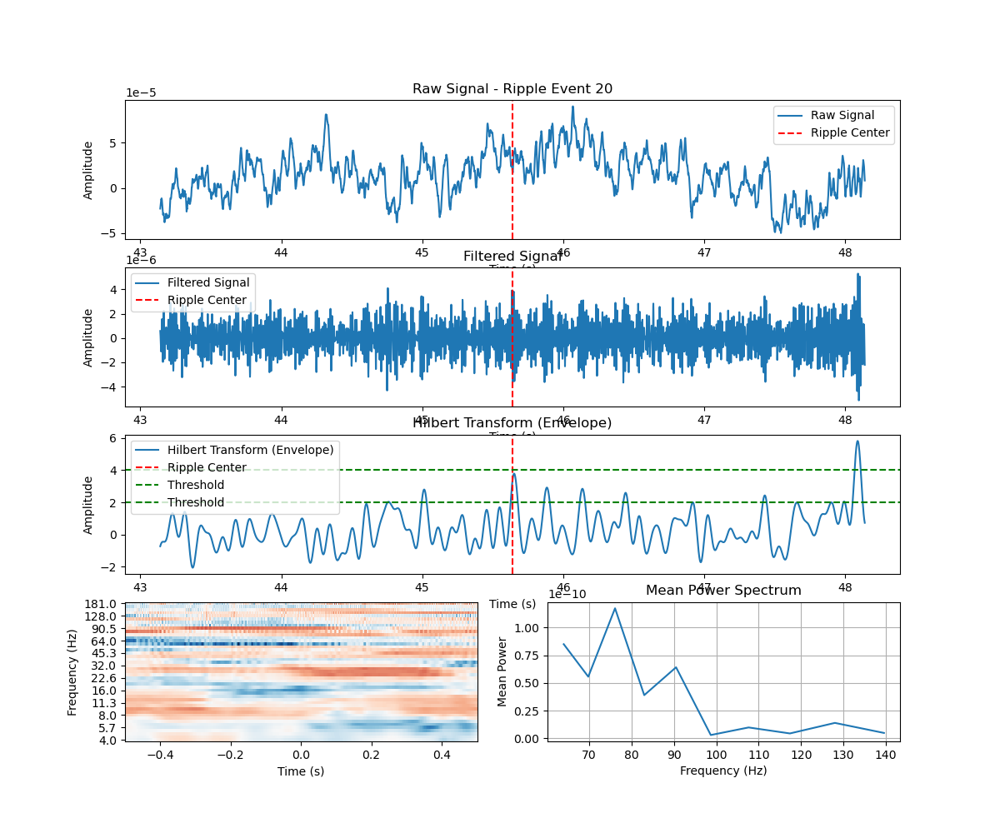

Applying baseline correction (mode: logratio)


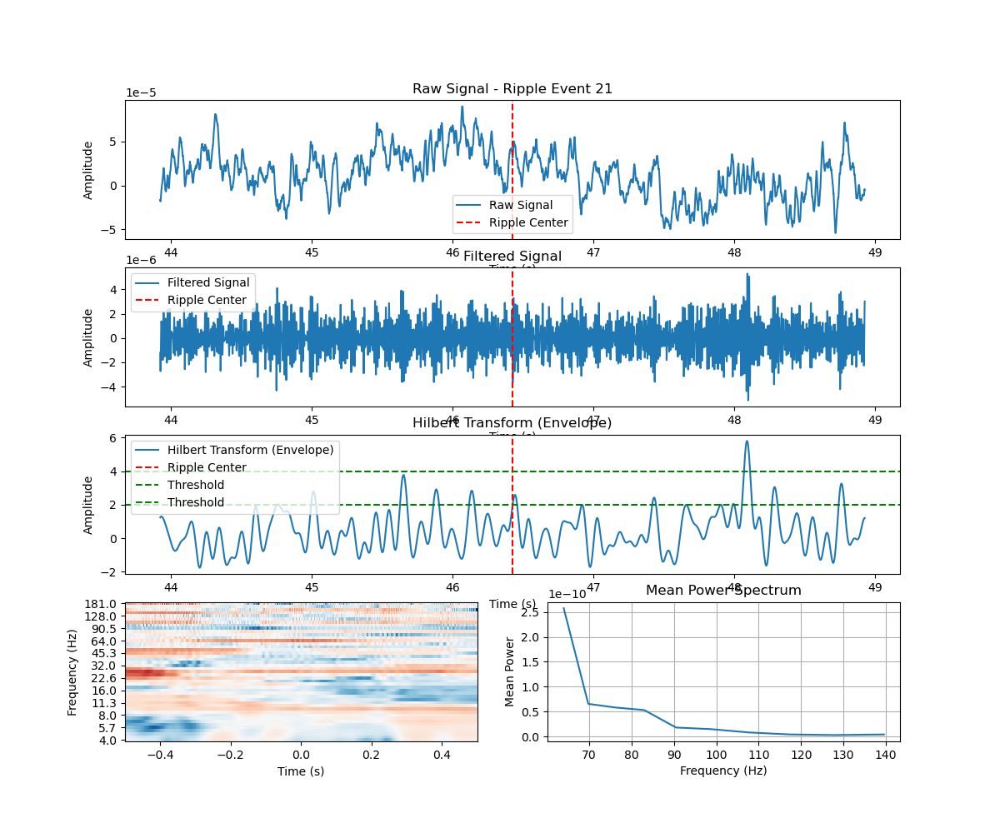

This is a valid ripple!
Applying baseline correction (mode: logratio)


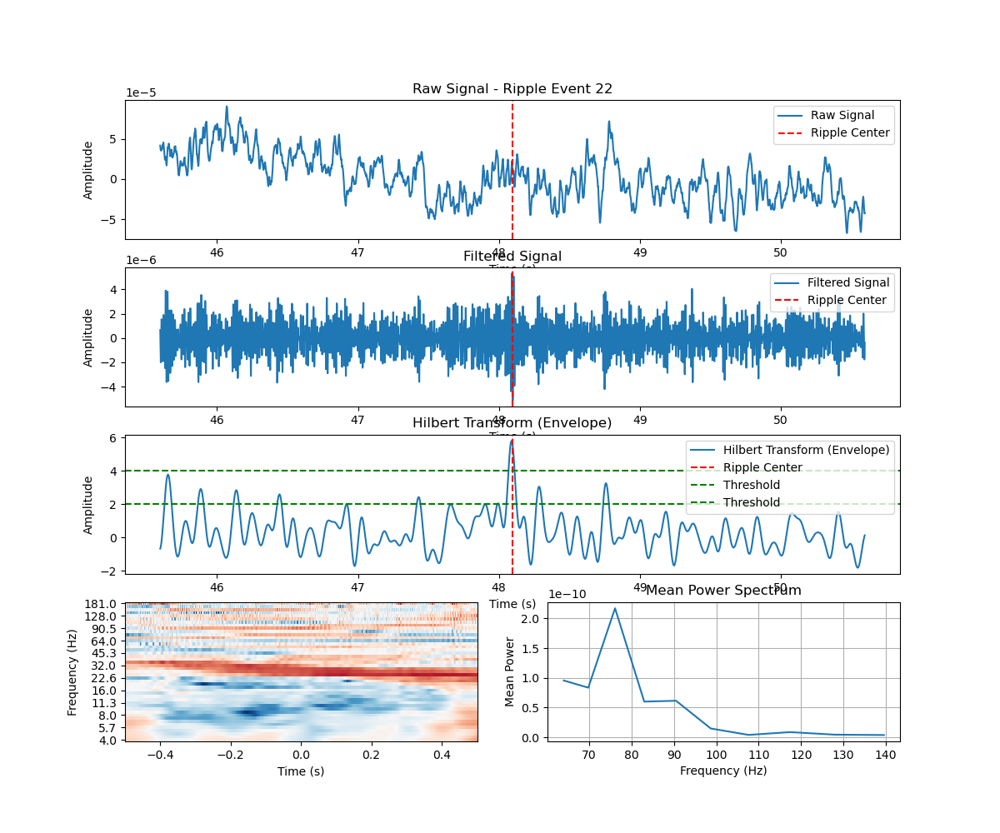

This is a valid ripple!
Applying baseline correction (mode: logratio)


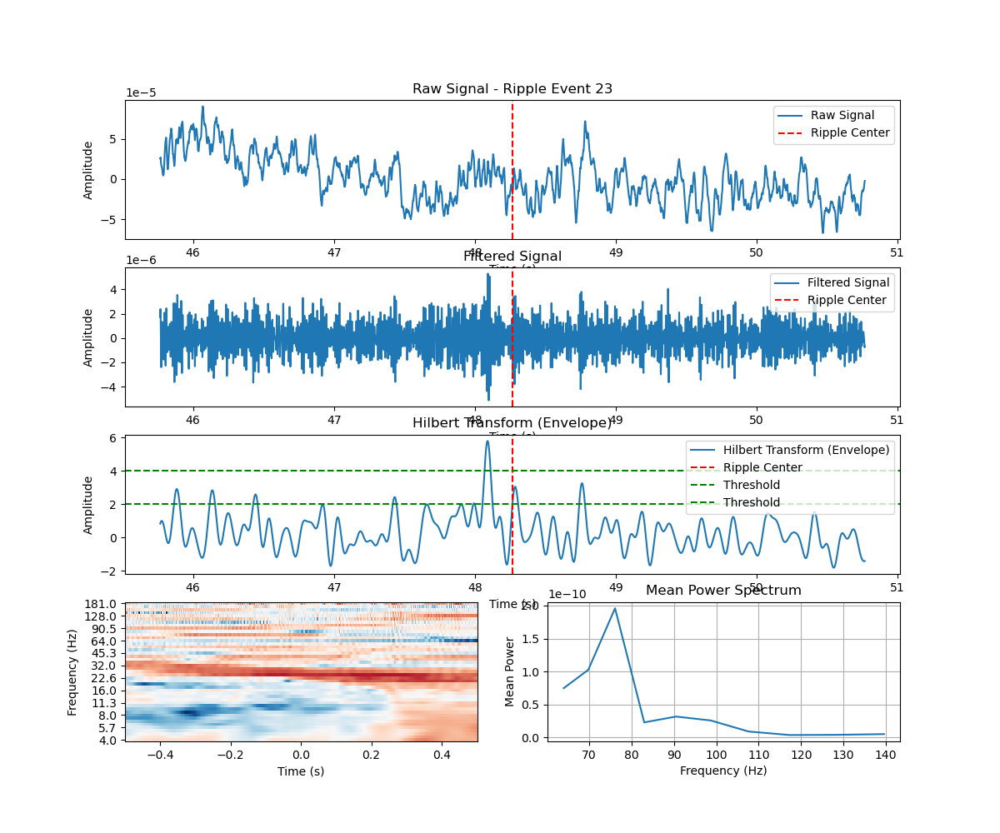

This is NOT a valid ripple!
Applying baseline correction (mode: logratio)


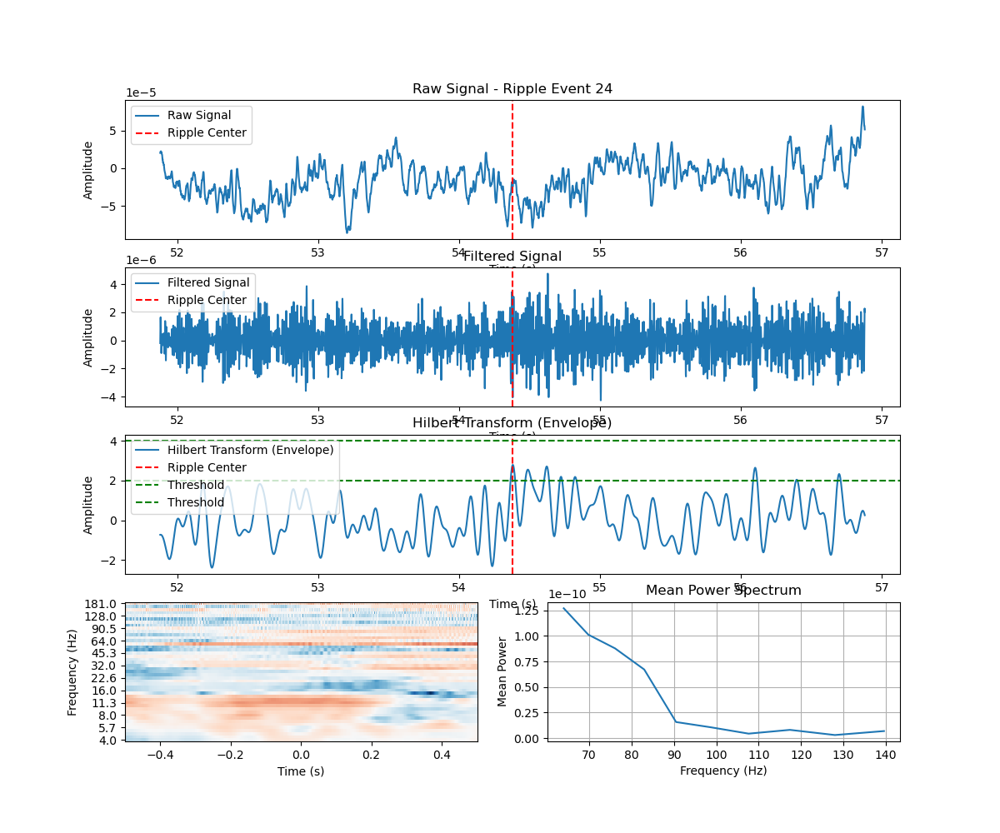

" for i in range(5):\n        row = i // 2\n        col = i % 2\n        ax = fig.add_subplot(gs[row, col])\n        \n        # Add some example data\n        x = np.linspace(0, 10, 100)\n        y = np.sin(x + i)\n        ax.plot(x, y)\n        ax.set_title(f'Subplot {i+1}')\n        axs.append(ax)\n\n    # Add a new subplot in the last row\n    ax5 = fig.add_subplot(gs[2, :])  # This spans both columns of the last row\n    ax5.plot(x, np.cos(x), 'r-')\n    ax5.set_title('Full Width Subplot')"

In [40]:
# ------------
signal_in = ieeg_signal
srate = int(fsample)
t_range = 2.5 # time range ± ripple trough (sec)
epileptic_events = trl_discharges
# ------------

# Directory where HTML files will be saved
output_directory = "/home/lfa-01/Escritorio/test"
os.makedirs(output_directory, exist_ok=True)  # Create the directory if it doesn't exist

# Define the time window around each ripple
window_samples = int(t_range * srate)

#1. Band-pass filtering 
#print('- Filtering and Hilbert transform [-]')
filter_order = 10
low_cut = 80 * 0.8 # [Hz] low cut-off frequency for high-pass filter (20% less to compensate for attenuation)
b_hp, a_hp = signal.butter(filter_order, (low_cut / srate) * 2, btype = 'highpass', analog=False) 
high_cut = 120 * 1.2 # [Hz] high cut-off frequency for low-pass filter (20% more to compensate for attenuation)
b_lp, a_lp = signal.butter(filter_order, (high_cut / srate) * 2, btype = 'lowpass', analog=False)

# apply filtering and get envelope
filt_signal_in = signal.filtfilt(b_hp, a_hp, signal_in) # HP
filt_signal_in = signal.filtfilt(b_lp, a_lp, filt_signal_in) #LP

# Hilbert transform
filt_signal_in_envelope = np.abs(signal.hilbert(filt_signal_in))

b_lp_h, a_lp_h = signal.butter(filter_order, (10*1.2 / srate) * 2, btype = 'lowpass', analog=False) #10 Hz LP on hilbert amplitude
filt_signal_in_envelope = signal.filtfilt(b_lp_h, a_lp_h, filt_signal_in_envelope) 

# Normalize with zscore
filt_signal_in_envelope = stats.zscore(filt_signal_in_envelope, axis=1)


##-----------------------------
## Identificacion de un perfil de potencia acorde con los ripples según lo recomendado por Ngo et al., 2020, eLife

# select times corresponding to +-50ms around the ripple through
select_times = np.bitwise_and(power_ripples_x_epoch.times <= 0.05, power_ripples_x_epoch.times >= (-0.05))

# select frequencies corresponding to 80-120
select_freqs = np.bitwise_and(freqs_ripples <= 140, freqs_ripples >= 60)
##-----------------------------


# Iterate over each identified ripple
cant_epochs_show = 25

for ripple, n_iter in zip(trl_ripples_clean[0:cant_epochs_show,:], range(cant_epochs_show)):

    ripple_center = int(ripple[0] + np.abs(ripple[2]))
    
    # Define the start and end of the segment
    start_idx = int(ripple[0])#ripple_center - window_samples
    end_idx = int(ripple[1]) #ripple_center + window_samples
    
    # Extract the segment
    segment_raw = signal_in[0, start_idx:end_idx]
    segment_filtered = filt_signal_in[0, start_idx:end_idx]
    segment_hilbert = filt_signal_in_envelope[0, start_idx:end_idx]
    segment_times = times[start_idx:end_idx]

    ##-----------------------------
    data_aux = np.squeeze(power_ripples_x_epoch[n_iter].data)
    data_aux_mean = np.mean(data_aux[:,select_times], axis=1)

    # Get the index of the highest peak
    data_aux_mean_ripple = data_aux_mean[select_freqs]
    peaks, _ = signal.find_peaks(data_aux_mean_ripple)
    if len(peaks) != 0:
        prominent_peak_index = np.argmax(data_aux_mean_ripple[peaks])

        # Check if the prominent peak is prominent enough
        if is_prominent_peak(data_aux_mean_ripple, peaks[prominent_peak_index]):
            valid_ripple = 1
            print("This is a valid ripple!")
        else:
            valid_ripple = 0
            print("This is NOT a valid ripple!")
    ##-----------------------------
    
    '''# Plot the raw signal, filtered signal, and Hilbert transform
    fig = plt.figure(figsize=(12, 8))
    plt.subplot(4, 1, 1)
    plt.plot(segment_times, segment_raw, label='Raw Signal')
    plt.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    plt.title(f'Raw Signal - Ripple Event {n_iter}')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()
    
    plt.subplot(4, 1, 2, sharex=plt.gca())
    plt.plot(segment_times, segment_filtered, label='Filtered Signal')
    plt.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    plt.title('Filtered Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()
    
    plt.subplot(4, 1, 3, sharex=plt.gca())
    plt.plot(segment_times, segment_hilbert, label='Hilbert Transform (Envelope)')
    plt.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    plt.axhline(y=2, color='g', linestyle='--', label='Threshold')
    plt.axhline(y=4, color='g', linestyle='--', label='Threshold')
    plt.title('Hilbert Transform (Envelope)')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()

    plt.subplot(4, 1, 4)
    power_ripples_x_epoch[n_iter].plot(baseline=(-2, -1.5), tmin=-0.5, tmax=0.5, mode="logratio", axes=plt.gca(),colorbar=False)
    
    plt.tight_layout()'''


    # Create a new figure with GridSpec
    fig = plt.figure(figsize=(12, 10))
    gs = gridspec.GridSpec(4, 2, height_ratios=[1, 1, 1, 1])

    # Create subplots using GridSpec
    #axs = []
    
    ax1 = fig.add_subplot(gs[0, :])  # This spans both columns of the last row
    ax1.plot(segment_times, segment_raw, label='Raw Signal')
    ax1.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    ax1.set_title(f'Raw Signal - Ripple Event {n_iter}')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Amplitude')
    ax1.legend()

    ax2 = fig.add_subplot(gs[1, :])  # This spans both columns of the last row
    ax2.plot(segment_times, segment_filtered, label='Filtered Signal')
    ax2.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    ax2.set_title('Filtered Signal')
    ax2.set_xlabel('Time (s)')
    ax2.set_ylabel('Amplitude')
    ax2.legend()
    ax2.sharex(ax1)

    ax3 = fig.add_subplot(gs[2, :])  # This spans both columns of the last row
    ax3.plot(segment_times, segment_hilbert, label='Hilbert Transform (Envelope)')
    ax3.axvline(x=times[ripple_center], color='r', linestyle='--', label='Ripple Center')
    ax3.axhline(y=2, color='g', linestyle='--', label='Threshold')
    ax3.axhline(y=4, color='g', linestyle='--', label='Threshold')
    ax3.set_title('Hilbert Transform (Envelope)')
    ax3.set_xlabel('Time (s)')
    ax3.set_ylabel('Amplitude')
    ax3.legend()
    ax3.sharex(ax1)

    ax4 = fig.add_subplot(gs[3, 1])  # This spans both columns of the last row
    ax4.plot(freqs_ripples[select_freqs], data_aux_mean_ripple)
    ax4.set_xlabel('Frequency (Hz)')
    ax4.set_ylabel('Mean Power')
    ax4.set_title('Mean Power Spectrum')
    ax4.grid(True)

    ax5 = fig.add_subplot(gs[3, 0])  # This spans both columns of the last row
    power_ripples_x_epoch[n_iter].plot(baseline=(-2, -1.5), tmin=-0.5, tmax=0.5, mode="logratio", axes=ax5, colorbar=False)
    

''' for i in range(5):
        row = i // 2
        col = i % 2
        ax = fig.add_subplot(gs[row, col])
        
        # Add some example data
        x = np.linspace(0, 10, 100)
        y = np.sin(x + i)
        ax.plot(x, y)
        ax.set_title(f'Subplot {i+1}')
        axs.append(ax)

    # Add a new subplot in the last row
    ax5 = fig.add_subplot(gs[2, :])  # This spans both columns of the last row
    ax5.plot(x, np.cos(x), 'r-')
    ax5.set_title('Full Width Subplot')'''


    #Save figure as HTML
    # Custom file name for each figure
    #file_name = f"figure_{n_iter}.fig"
    #file_path = os.path.join(output_directory, file_name)


    # Save the figure using the savefig method
    #plt.savefig(filepath)

    # Save as .fig file
    #with open(file_path, 'wb') as f:
    #    pickle.dump(fig, f)

    # Save figure as PNG
    #plt.savefig(file_path, format='png')

    # Save figure as HTML
    #html_content = mpld3.fig_to_html(plt.gcf())
    #with open(file_path, "w") as f:
    #    f.write(html_content)'''

    #plt.show()
    #plt.close()

In [28]:
filepath = "/home/lfa-01/Escritorio/test/figure_0.fig"
        
# Load the figure from pickle file
with open(filepath, 'rb') as file:
    fig2 = pickle.load(file)
    
type(fig2)

matplotlib.figure.Figure

Histograma de la duracion de los ripples

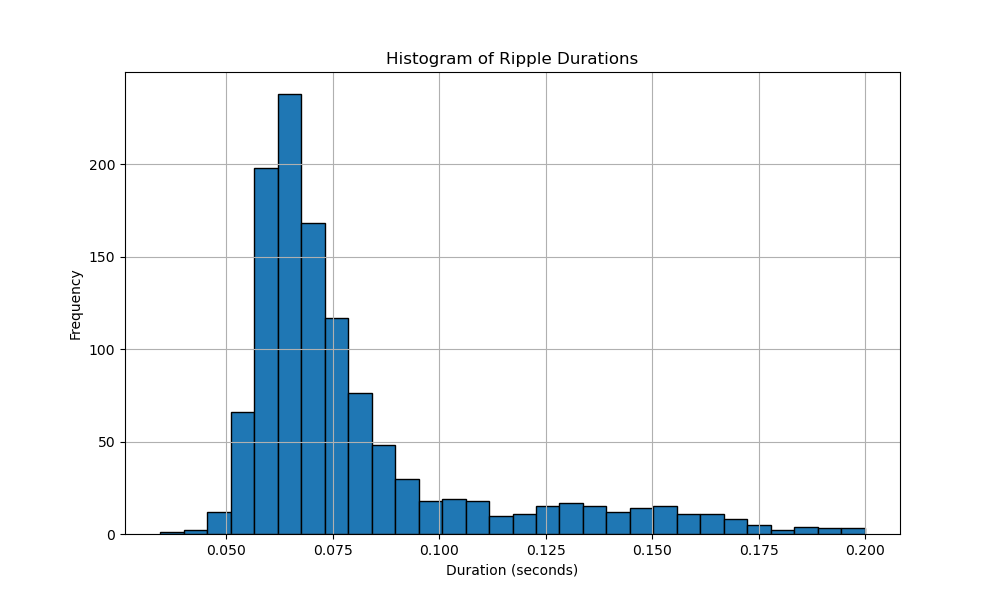

In [102]:
# Extract the data for the histogram
ripple_durations = trl_ripples[:, 6]

# Create the histogram plot
plt.figure(figsize=(10, 6))
plt.hist(ripple_durations, bins=30, edgecolor='black')
plt.title('Histogram of Ripple Durations')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()